In [123]:
import sklearn
sklearn.set_config(transform_output="pandas")
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.base import BaseEstimator, TransformerMixin


from sklearn.linear_model import LinearRegression


# Preprocessing
from sklearn.impute import SimpleImputer
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler,OrdinalEncoder
from sklearn.model_selection import GridSearchCV, KFold

# for model learning
from sklearn.model_selection import train_test_split, RandomizedSearchCV, cross_val_score
from sklearn.ensemble import RandomForestClassifier, StackingClassifier

from catboost import CatBoostClassifier
from sklearn.model_selection import GridSearchCV, KFold
from sklearn.model_selection import train_test_split, RandomizedSearchCV, cross_val_score
# Metrics

from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, roc_curve
import optuna
import shap



# from tqdm import tqdm
from sklearn.compose import make_column_selector
from category_encoders.cat_boost import CatBoostEncoder

from sklearn.preprocessing import OneHotEncoder

In [4]:
filetrain = 'titanic/train.csv'
train = pd.read_csv(filetrain)

# train = train.sort_values('Age',ascending=False).tail(890)
# train.head(15)

# 631 571
# nah = ((train.PassengerId == 631) | (train.PassengerId == 498)  | (train.PassengerId == 571) | (train.PassengerId == 298) | (train.PassengerId == 289)| (train.PassengerId == 339)| (train.PassengerId == 415))
# train = train.loc[~nah]


X, y = train.drop('Survived', axis=1), train['Survived']
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.25, random_state=42)

In [3]:
testfile = 'titanic/test.csv'
test =  pd.read_csv(testfile)

### Начало

### Classes

In [238]:
class family_maker(BaseEstimator, TransformerMixin): 
    
    def fit(self, X, y=None):
        return self
        
    def transform(self, X, y=None):

        def fam(x):
            if x == 0:
                return 'NO'
            return 'YES'
        X_copy = X.copy()
        X_copy['family_size'] = X_copy['SibSp']+X_copy['Parch']
        X_copy['family'] =  X_copy['family_size'].map(fam)
        
        return X_copy[['family','family_size']]

class Age_Imputer(BaseEstimator, TransformerMixin): 
    
    def fit(self, X, y=None):
        return self
        
    def transform(self, X, y=None):
        X_copy = X.copy()
        meta = train.groupby(['Sex','Pclass','SibSp']).agg({'Age':['median']}).reset_index()

        for i, sex, pc, sib, age in X_copy[['Sex','Pclass','SibSp','Age']].itertuples(index=True):
            if np.isnan(age):
                mask = ((meta.Sex == sex) & (meta.Pclass == pc) & (meta.SibSp == sib))
                
                agen = np.array(meta.loc[mask][('Age','median')])
                
                if np.isnan(agen):
                    if sib >= 4:
                        X_copy.loc[i,'Age'] = 1
                    else:
                        X_copy.loc[i,'Age'] = X_copy.loc[X_copy.Pclass == pc].median()
                else:
                    X_copy.loc[i,'Age'] = agen
        return X_copy[['Sex','Age','Pclass']]


class Name(BaseEstimator, TransformerMixin): 
    
    def fit(self, X, y=None):
        return self
        
    def transform(self, X, y=None):
        
        X_copy = X.copy()

        def name(x):
            return x.split()[0][:-1]

        def title(x):
            return x.split()[1]

        X_copy['title'] = X_copy['Name'].map(title)
        X_copy['Name'] = X_copy['Name'].map(name)
        return X_copy



class Fare_Imputer(BaseEstimator, TransformerMixin): 
    
    def fit(self, X, y=None):
        return self
        
    def transform(self, X, y=None):
        X_copy = X.copy()
        meta = train.groupby(['Embarked','Pclass']).agg({'Fare':['median']}).reset_index()

        for i, em, pc, fare in X_copy[['Embarked','Pclass','Fare']].itertuples(index=True):
            if np.isnan(fare):
                mask = ((meta.Embarked == em) & (meta.Pclass == pc))
                faren = np.array(meta.loc[mask][('Fare','median')])
                
                X_copy.loc[i,'Fare'] = faren
                
        return X_copy


class Class_maker(BaseEstimator, TransformerMixin): 
    
    def fit(self, X, y=None):
        return self
        
    def transform(self, X, y=None):
        X_copy = X.copy()

        def func(x):
            if x == 3:
                return -1
            if x == 2:
                return 0
            if x == 1:
                return 1

        X_copy['Pclass'] = X_copy['Pclass'].map(func) 
        return X_copy

class Family_size(BaseEstimator, TransformerMixin): 
    
    def fit(self, X, y=None):
        return self
        
    def transform(self, X, y=None):

        def fam2(x):
            if x == 0 or x > 3:
                return -1
            if x == 3:
                return 1
            return 0

        X_copy = X.copy()
        
        X_copy['family_factor'] = X_copy['family_size'].map(fam2)
        
        return X_copy


class Age_Factor(BaseEstimator, TransformerMixin): 
    
    def fit(self, X, y=None):
        return self
        
    def transform(self, X, y=None):
        
        X_copy = X.copy()

        X_copy['age_factor'] = pd.cut(X_copy['Age'], bins=[-0.01,6,16,35,50,65,120],labels = ['child','teen','adult','upper','old','very old'])
        
        return X_copy


class Sex_Factor(BaseEstimator, TransformerMixin): 
    
    def fit(self, X, y=None):
        return self
        
    def transform(self, X, y=None):
        
        X_copy = X.copy()
        def sex(x):
            if x == 'male':
                return -1
            return 1
        X_copy['sex_factor'] = X_copy['Sex'].map(sex)
        
        return X_copy


class Cabin_Factor(BaseEstimator, TransformerMixin): 
    
    def fit(self, X, y=None):
        return self
        
    def transform(self, X, y=None):
        
        X_copy = X.copy()
        
        def f(x):
            try:
                x[0]
                return 1
            except:
                return 0

        X_copy['cabin_factor']=X_copy['Cabin'].map(f)
        
        return pd.DataFrame(X_copy['cabin_factor'])

### Preprocessor

In [262]:
first_step = ColumnTransformer(
    transformers=[
        ('family maker',family_maker(),['SibSp','Parch']),
        ('age_imputer', Age_Imputer(), ['Sex','Pclass','SibSp','Age']),
        ('embarked_imputer', SimpleImputer(strategy='most_frequent'), ['Embarked']),
        ('name_transformer', Name(), ['Name'])
    ],
     verbose_feature_names_out = False,
     remainder = 'passthrough')

fare_step = ColumnTransformer(
    transformers=[
        ('fare_imputer', Fare_Imputer(), ['Embarked','Pclass','Fare']),
    ],
     verbose_feature_names_out = False,
     remainder = 'passthrough')




################################################################################################################################################




age_factor = ColumnTransformer(
    transformers=[
        ('age_encode',Age_Factor(),['Age']),
    ],
     verbose_feature_names_out = False,
     remainder = 'passthrough')




##############################################################################################################################################


custom_encode_step = ColumnTransformer(
    transformers=[
        ('class_make', Class_maker(), ['Pclass']),
        ('family_factor', Family_size(), ['family_size']),
        ('sex',Sex_Factor(),['Sex']),
        ('cabin', Cabin_Factor(),['Cabin'])
    ],
     verbose_feature_names_out = False,
     remainder = 'passthrough')

custom_encode = Pipeline(
    [
        ('Age factor', age_factor),
        ('Fare_transform', fare_step),
        ('Custom encode step', custom_encode_step),
        ]
)

scale = ['Fare','Age']
cat = ['Name']

ohe = ['age_factor','title']

second_step = ColumnTransformer(
    transformers=[
        ('encoder',CatBoostEncoder(),cat),
        ('encoder_2',OneHotEncoder(handle_unknown='ignore', sparse_output=False),ohe),
        ('scaler',StandardScaler(),scale)
    ],
     verbose_feature_names_out = False,
     remainder = 'passthrough')


drop_step = ColumnTransformer(
    transformers=[
        ('drop ','drop',['PassengerId','Ticket','Embarked','family','Sex']),
        # ('drop SHAP_garbage','drop',shap_garbage),
    ],
     verbose_feature_names_out = False,
     remainder = 'passthrough')


preprocessor = Pipeline(
    [
        ('NaN_features_transform', first_step),
        ('Custom encode step', custom_encode),
        ('Encoding_and_scaling',second_step),
        ('drop step', drop_step),
    ]
)

In [243]:
X_p = preprocessor.fit_transform(X_train,y_train)

### Data

In [128]:
X, y = train.drop('Survived', axis=1), train['Survived']
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

In [129]:
t = pd.DataFrame(data={'NaN_count': X.isna().sum(), 'data_type':X.dtypes})
t.loc[t['NaN_count'] > 0]

,NaN_count,data_type
Age,177,float64
Cabin,687,object
Embarked,2,object


In [56]:
num = train.select_dtypes(exclude=  ['object'])
num

,SibSp,Parch,family_size,Pclass,Age,Survived,Fare
0,1,0,1,3,22.0,0,7.2500
1,1,0,1,1,38.0,1,71.2833
2,0,0,0,3,26.0,1,7.9250
3,1,0,1,1,35.0,1,53.1000
4,0,0,0,3,35.0,0,8.0500
...,...,...,...,...,...,...,...
886,0,0,0,2,27.0,0,13.0000
887,0,0,0,1,19.0,1,30.0000
888,1,2,3,3,28.5,0,23.4500
889,0,0,0,1,26.0,1,30.0000


In [59]:
train['Embarked'].fillna(train['Embarked'].mode, inplace=True)

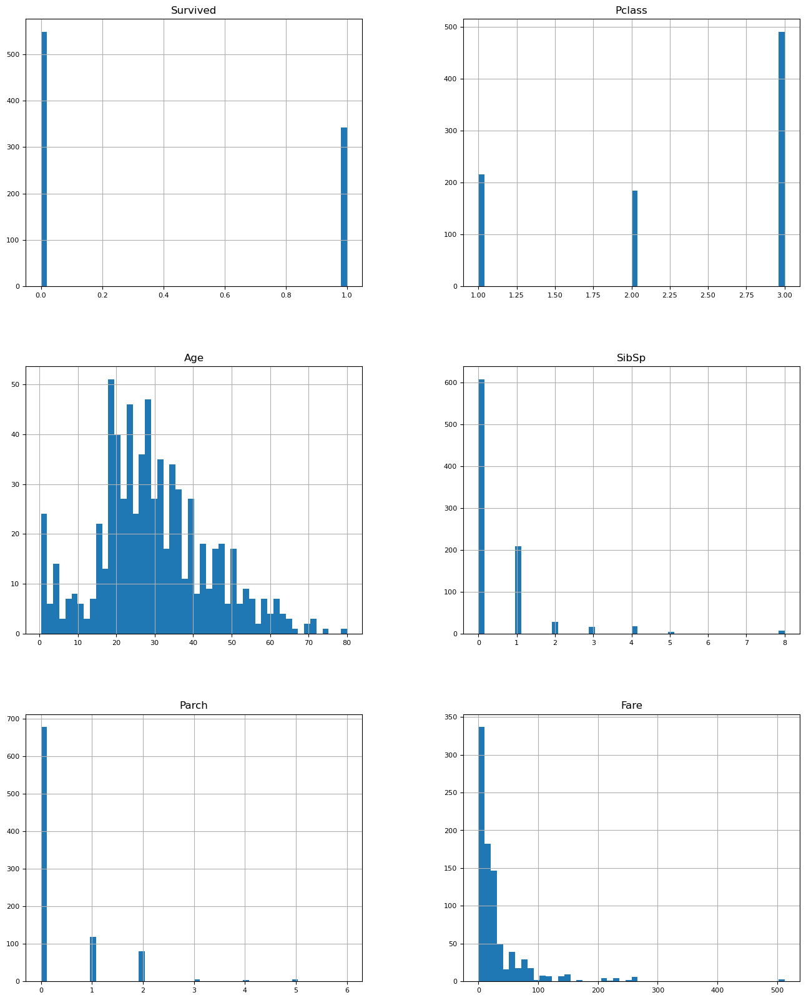

In [15]:
num.hist(figsize=(16, 20), bins=50, xlabelsize=8, ylabelsize=8);

<Axes: xlabel='Fare', ylabel='Age'>

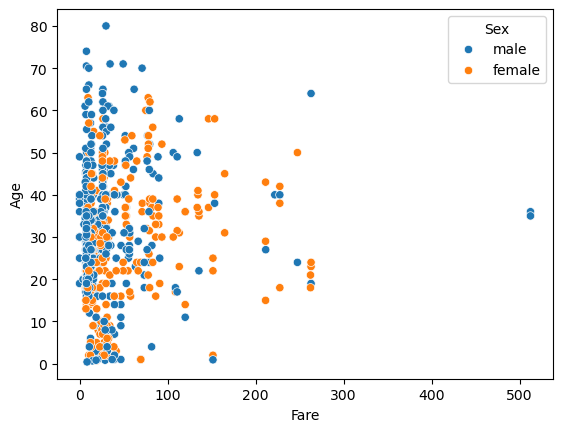

In [73]:
sns.scatterplot(x = train['Fare'] , y = train['Age'], hue=train['Sex'])

In [57]:
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

X = preprocessor.fit_transform(X,y)
X.head()

,Name,family,Sex,Embarked,Age,Fare,family_size,Pclass
0,0.383838,1.0,1.0,2.0,-0.526292,-0.502445,1,3
1,0.383838,1.0,0.0,0.0,0.655315,0.786845,1,1
2,0.383838,0.0,0.0,2.0,-0.230890,-0.488854,0,3
3,0.383838,1.0,0.0,2.0,0.433764,0.420730,1,1
4,0.383838,0.0,1.0,2.0,0.433764,-0.486337,0,3


### SHAP

In [149]:
shap.initjs()
X_copy = X.copy()
X_copy = preprocessor.fit_transform(X,y)


model = CatBoostClassifier(iterations=2000, learning_rate=0.01, max_depth=6, random_seed=42)
model.fit(X_copy, y, verbose=False, plot=False)

In [150]:
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_copy)

# visualize the first prediction's explanation
shap.force_plot(explainer.expected_value, shap_values[0,:], X_copy.iloc[0,:])

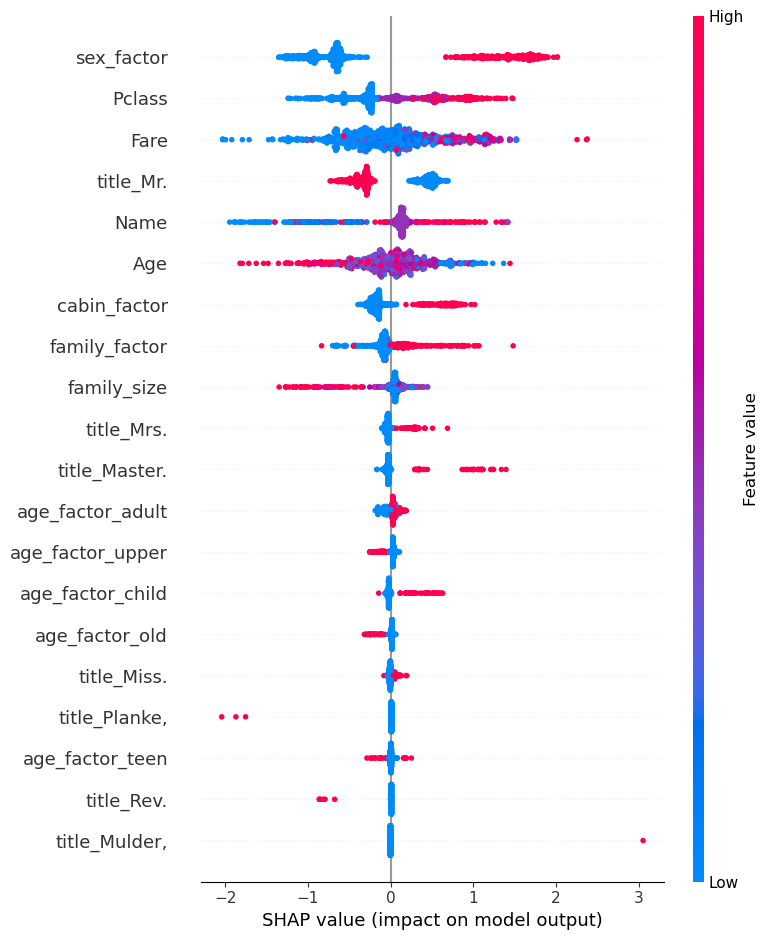

In [167]:
shap.summary_plot(shap_values, X_copy)

In [168]:
vals= np.abs(shap_values).mean(0)
feature_importance = pd.DataFrame(list(zip(X_copy.columns,vals)),columns=['col_name','vals'])
feature_importance.sort_values(by=['vals'],ascending=False,inplace=True)
feature_importance.loc[~(feature_importance['vals'] > 0.01)].col_name.to_list()

['title_Mulder,',
 'title_y',
 'age_factor_very old',
 'title_Messemaeker,',
 'title_Col.',
 'title_Impe,',
 'title_Don.',
 'title_Dr.',
 'title_Major.',
 'title_Carlo,',
 'title_Pelsmaeker,',
 'title_Gordon,',
 'title_der',
 'title_Walle,',
 'title_Capt.',
 'title_Ms.',
 'title_Shawah,',
 'title_Velde,',
 'title_the',
 'title_Melkebeke,',
 'title_Steen,',
 'title_Billiard,',
 'title_Cruyssen,',
 'title_Mlle.',
 'title_Mme.',
 'title_Jonkheer.']

### Random

In [137]:
X_copy = X.copy()

X_copy['random'] = np.random.normal(0,0.25, size=X_copy.shape[0])
rf = RandomForestClassifier()

X_RF = preprocessor.fit_transform(X_copy,y)

rf.fit(X_RF, y)

result = pd.Series(dict(zip(X_RF.columns, rf.feature_importances_))).sort_values(key=lambda x: abs(x), ascending=False).to_frame().round(6)

result.loc[result[0] < 0.0005].index.to_list()
pd.set_option('display.max_rows', 80)

result.index.to_list().index('random')
OK = result.index.to_list()[:result.index.to_list().index('random')]

In [138]:
result

,0
random,0.161207
Fare,0.158477
Age,0.118442
sex_factor,0.116877
title_Mr.,0.084516
Pclass,0.060268
Name,0.047775
family_size,0.043325
title_Miss.,0.041002
title_Mrs.,0.039293


### OPTUNA

#### RFC

In [295]:
ml_pipeline = Pipeline(
    [
        ('preprocessor', preprocessor),
        ('model', RandomForestClassifier())
    ]
)


def objective(trial):

    model_params = {
            'n_estimators': trial.suggest_int('n_estimators', 250, 500,2),
            'max_depth': trial.suggest_int('max_depth', 2, 10),
            'min_samples_split': trial.suggest_int('min_samples_split', 2, 15),
            'min_samples_leaf': trial.suggest_int('min_samples_leaf', 1, 15),
        'random_state': trial.suggest_int('random_state', 4, 111, 1)
    }
    
    ml_pipeline.named_steps['model'].set_params(**model_params)

    # Создание сплитов для кросс-валидации
    cv = KFold(n_splits=5, random_state=42, shuffle=True)

    # Вычисление метрик точности с использованием кросс-валидации
    scores = cross_val_score(ml_pipeline, X, y, cv=cv)
    
    accuracy = scores.mean()
    
    return accuracy


# Создание объекта для проведения оптимизации
study = optuna.create_study(direction='maximize')


# Запуск оптимизации
study.optimize(objective, n_trials=50)


# Вывод результатов
best_params = study.best_params
best_value = study.best_value


print(f"Лучшие параметры: {best_params}")
print(f"Лучшее значение: {best_value}")

[I 2024-02-21 22:39:27,309] A new study created in memory with name: no-name-7f70dba3-74b6-408b-9971-2c3ed20dbd4a
[I 2024-02-21 22:39:29,023] Trial 0 finished with value: 0.8181846713953925 and parameters: {'n_estimators': 262, 'max_depth': 3, 'min_samples_split': 10, 'min_samples_leaf': 14, 'random_state': 79}. Best is trial 0 with value: 0.8181846713953925.
[I 2024-02-21 22:39:31,301] Trial 1 finished with value: 0.8361559224154165 and parameters: {'n_estimators': 452, 'max_depth': 8, 'min_samples_split': 11, 'min_samples_leaf': 5, 'random_state': 81}. Best is trial 1 with value: 0.8361559224154165.
[I 2024-02-21 22:39:33,647] Trial 2 finished with value: 0.8350323269097985 and parameters: {'n_estimators': 470, 'max_depth': 8, 'min_samples_split': 7, 'min_samples_leaf': 8, 'random_state': 24}. Best is trial 1 with value: 0.8361559224154165.
[I 2024-02-21 22:39:35,984] Trial 3 finished with value: 0.8316552633230808 and parameters: {'n_estimators': 488, 'max_depth': 4, 'min_samples_sp

Лучшие параметры: {'n_estimators': 446, 'max_depth': 9, 'min_samples_split': 12, 'min_samples_leaf': 1, 'random_state': 79}
Лучшее значение: 0.8406440273680247


#### CatBoostClassifier

In [ ]:
ml_pipeline = Pipeline(
    [
        ('preprocessor', preprocessor),
        ('model', CatBoostClassifier())
    ]
)
def objective(trial):
    
    model_params = {
        'iterations' : trial.suggest_int("iterations", 500, 3000),
        'learning_rate': trial.suggest_float("learning_rate", 0.01, 0.1, log=True),
        'depth': trial.suggest_int("depth", 2, 6, 1),
        'l2_leaf_reg': trial.suggest_float("l2_leaf_reg", 1e-8, 100.0, log=True),
        'random_strength': trial.suggest_float("random_strength", 1e-8, 10.0, log=True),
        'bagging_temperature': trial.suggest_float("bagging_temperature", 0.0, 10.0),
        'random_state': trial.suggest_int('random_state', 42, 42, 1)
}
    
    
    ml_pipeline.named_steps['model'].set_params(**model_params)

    # Создание сплитов для кросс-валидации
    cv = KFold(n_splits=5, random_state=42, shuffle=True)

    # Вычисление метрик точности с использованием кросс-валидации
    scores = cross_val_score(ml_pipeline, X, y, cv=cv)
    
    accuracy = scores.mean()
    
    return accuracy


# Создание объекта для проведения оптимизации
study = optuna.create_study(direction='maximize')


# Запуск оптимизации
study.optimize(objective, n_trials=200)


# Вывод результатов
best_params = study.best_params
best_value = study.best_value


print(f"Лучшие параметры: {best_params}")
print(f"Лучшее значение: {best_value}")

[I 2024-02-12 17:36:06,301] A new study created in memory with name: no-name-3398401f-93b8-4805-8d6c-36bd02e6cd6a


0:	learn: 0.6575129	total: 1.03ms	remaining: 837ms
1:	learn: 0.6409008	total: 1.5ms	remaining: 609ms
2:	learn: 0.6004030	total: 1.77ms	remaining: 479ms
3:	learn: 0.5685302	total: 2.02ms	remaining: 410ms
4:	learn: 0.5425586	total: 2.27ms	remaining: 367ms
5:	learn: 0.5155953	total: 2.52ms	remaining: 340ms
6:	learn: 0.5027046	total: 2.76ms	remaining: 319ms
7:	learn: 0.4981896	total: 2.98ms	remaining: 300ms
8:	learn: 0.4947266	total: 3.21ms	remaining: 287ms
9:	learn: 0.4862634	total: 3.46ms	remaining: 278ms
10:	learn: 0.4768702	total: 3.68ms	remaining: 269ms
11:	learn: 0.4659597	total: 3.93ms	remaining: 263ms
12:	learn: 0.4536855	total: 4.17ms	remaining: 257ms
13:	learn: 0.4446896	total: 4.41ms	remaining: 252ms
14:	learn: 0.4422031	total: 4.66ms	remaining: 248ms
15:	learn: 0.4357306	total: 4.89ms	remaining: 244ms
16:	learn: 0.4300316	total: 5.13ms	remaining: 240ms
17:	learn: 0.4275786	total: 5.38ms	remaining: 238ms
18:	learn: 0.4235608	total: 5.62ms	remaining: 235ms
19:	learn: 0.4162100	to

[I 2024-02-12 17:36:08,433] Trial 0 finished with value: 0.8002196974452327 and parameters: {'iterations': 814, 'learning_rate': 0.074376085151979, 'depth': 4, 'l2_leaf_reg': 1.2400545768951022e-07, 'bootstrap_type': 'Bayesian', 'random_strength': 0.17156063179539163, 'bagging_temperature': 6.0929343405182435, 'od_type': 'Iter', 'od_wait': 16, 'random_state': 42}. Best is trial 0 with value: 0.8002196974452327.


768:	learn: 0.1127700	total: 184ms	remaining: 10.7ms
769:	learn: 0.1125103	total: 184ms	remaining: 10.5ms
770:	learn: 0.1124306	total: 184ms	remaining: 10.3ms
771:	learn: 0.1123452	total: 184ms	remaining: 10ms
772:	learn: 0.1122634	total: 185ms	remaining: 9.79ms
773:	learn: 0.1115353	total: 185ms	remaining: 9.56ms
774:	learn: 0.1115182	total: 185ms	remaining: 9.32ms
775:	learn: 0.1113140	total: 185ms	remaining: 9.08ms
776:	learn: 0.1112459	total: 186ms	remaining: 8.84ms
777:	learn: 0.1112131	total: 186ms	remaining: 8.6ms
778:	learn: 0.1109949	total: 186ms	remaining: 8.36ms
779:	learn: 0.1108393	total: 186ms	remaining: 8.13ms
780:	learn: 0.1106693	total: 187ms	remaining: 7.89ms
781:	learn: 0.1105655	total: 187ms	remaining: 7.65ms
782:	learn: 0.1100649	total: 187ms	remaining: 7.41ms
783:	learn: 0.1100330	total: 188ms	remaining: 7.18ms
784:	learn: 0.1098723	total: 188ms	remaining: 6.94ms
785:	learn: 0.1098527	total: 188ms	remaining: 6.7ms
786:	learn: 0.1098288	total: 188ms	remaining: 6.46

[I 2024-02-12 17:36:10,444] Trial 1 finished with value: 0.8047140794677045 and parameters: {'iterations': 698, 'learning_rate': 0.05684862865451554, 'depth': 4, 'l2_leaf_reg': 0.16338363048795843, 'bootstrap_type': 'Bayesian', 'random_strength': 4.05322316925339e-06, 'bagging_temperature': 4.5158555015608535, 'od_type': 'Iter', 'od_wait': 17, 'random_state': 42}. Best is trial 1 with value: 0.8047140794677045.


0:	learn: 0.6779729	total: 346us	remaining: 295ms
1:	learn: 0.6642860	total: 652us	remaining: 277ms
2:	learn: 0.6459772	total: 875us	remaining: 248ms
3:	learn: 0.6340241	total: 1.08ms	remaining: 230ms
4:	learn: 0.6295484	total: 1.27ms	remaining: 216ms
5:	learn: 0.6180611	total: 1.47ms	remaining: 207ms
6:	learn: 0.6079961	total: 1.64ms	remaining: 198ms
7:	learn: 0.5987760	total: 1.83ms	remaining: 193ms
8:	learn: 0.5908394	total: 2.02ms	remaining: 189ms
9:	learn: 0.5784543	total: 2.2ms	remaining: 185ms
10:	learn: 0.5671642	total: 2.38ms	remaining: 182ms
11:	learn: 0.5568756	total: 2.56ms	remaining: 180ms
12:	learn: 0.5507584	total: 2.73ms	remaining: 177ms
13:	learn: 0.5478417	total: 2.92ms	remaining: 175ms
14:	learn: 0.5422734	total: 3.1ms	remaining: 173ms
15:	learn: 0.5390283	total: 3.27ms	remaining: 171ms
16:	learn: 0.5339595	total: 3.44ms	remaining: 169ms
17:	learn: 0.5321192	total: 3.61ms	remaining: 167ms
18:	learn: 0.5278509	total: 3.82ms	remaining: 167ms
19:	learn: 0.5233087	total:

[I 2024-02-12 17:36:12,334] Trial 2 finished with value: 0.8249262444291006 and parameters: {'iterations': 852, 'learning_rate': 0.035381421235162115, 'depth': 2, 'l2_leaf_reg': 0.024209548883241484, 'bootstrap_type': 'Bayesian', 'random_strength': 3.0916815384046765e-06, 'bagging_temperature': 2.603346435315924, 'od_type': 'Iter', 'od_wait': 43, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


0:	learn: 0.6722356	total: 336us	remaining: 276ms
1:	learn: 0.6539361	total: 817us	remaining: 335ms
2:	learn: 0.6298867	total: 1.03ms	remaining: 280ms
3:	learn: 0.6148552	total: 1.21ms	remaining: 248ms
4:	learn: 0.5952950	total: 1.4ms	remaining: 228ms
5:	learn: 0.5832793	total: 1.57ms	remaining: 214ms
6:	learn: 0.5724390	total: 1.75ms	remaining: 204ms
7:	learn: 0.5628003	total: 1.92ms	remaining: 195ms
8:	learn: 0.5600618	total: 2.09ms	remaining: 189ms
9:	learn: 0.5574191	total: 2.26ms	remaining: 184ms
10:	learn: 0.5532184	total: 2.44ms	remaining: 180ms
11:	learn: 0.5501194	total: 2.61ms	remaining: 176ms
12:	learn: 0.5427621	total: 2.78ms	remaining: 173ms
13:	learn: 0.5309951	total: 2.95ms	remaining: 170ms
14:	learn: 0.5206804	total: 3.13ms	remaining: 168ms
15:	learn: 0.5149553	total: 3.29ms	remaining: 166ms
16:	learn: 0.5134009	total: 3.46ms	remaining: 164ms
17:	learn: 0.5083821	total: 3.64ms	remaining: 162ms
18:	learn: 0.5059176	total: 3.83ms	remaining: 162ms
19:	learn: 0.5036410	tota

[I 2024-02-12 17:36:14,191] Trial 3 finished with value: 0.8170547988199109 and parameters: {'iterations': 822, 'learning_rate': 0.04917690580464108, 'depth': 2, 'l2_leaf_reg': 0.00218484979331278, 'bootstrap_type': 'Bayesian', 'random_strength': 1.821676504676211e-05, 'bagging_temperature': 3.198319019986815, 'od_type': 'Iter', 'od_wait': 42, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


0:	learn: 0.6860722	total: 342us	remaining: 172ms
1:	learn: 0.6787991	total: 835us	remaining: 210ms
2:	learn: 0.6763705	total: 1.07ms	remaining: 180ms
3:	learn: 0.6747167	total: 1.3ms	remaining: 163ms
4:	learn: 0.6682464	total: 1.51ms	remaining: 151ms
5:	learn: 0.6619432	total: 1.71ms	remaining: 142ms
6:	learn: 0.6518963	total: 1.93ms	remaining: 137ms
7:	learn: 0.6496283	total: 2.13ms	remaining: 132ms
8:	learn: 0.6476074	total: 2.35ms	remaining: 129ms
9:	learn: 0.6459797	total: 2.54ms	remaining: 126ms
10:	learn: 0.6377445	total: 2.77ms	remaining: 124ms
11:	learn: 0.6293403	total: 2.98ms	remaining: 122ms
12:	learn: 0.6242376	total: 3.18ms	remaining: 120ms
13:	learn: 0.6193181	total: 3.37ms	remaining: 118ms
14:	learn: 0.6175594	total: 3.58ms	remaining: 117ms
15:	learn: 0.6126910	total: 3.77ms	remaining: 115ms
16:	learn: 0.6107017	total: 3.96ms	remaining: 113ms
17:	learn: 0.6057953	total: 4.17ms	remaining: 113ms
18:	learn: 0.6038141	total: 4.35ms	remaining: 111ms
19:	learn: 0.5992918	tota

[I 2024-02-12 17:36:15,880] Trial 4 finished with value: 0.8193019898311468 and parameters: {'iterations': 504, 'learning_rate': 0.015757779761954773, 'depth': 3, 'l2_leaf_reg': 2.8695277794698092e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 1.1708533917144332e-07, 'bagging_temperature': 4.643131364501607, 'od_type': 'Iter', 'od_wait': 38, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


0:	learn: 0.6899930	total: 655us	remaining: 330ms
1:	learn: 0.6869107	total: 1.06ms	remaining: 267ms
2:	learn: 0.6845966	total: 1.31ms	remaining: 219ms
3:	learn: 0.6752506	total: 1.56ms	remaining: 195ms
4:	learn: 0.6726539	total: 1.78ms	remaining: 178ms
5:	learn: 0.6648803	total: 1.98ms	remaining: 165ms
6:	learn: 0.6616923	total: 2.19ms	remaining: 156ms
7:	learn: 0.6552296	total: 2.41ms	remaining: 149ms
8:	learn: 0.6494831	total: 2.6ms	remaining: 143ms
9:	learn: 0.6438469	total: 2.8ms	remaining: 138ms
10:	learn: 0.6419933	total: 2.99ms	remaining: 134ms
11:	learn: 0.6350651	total: 3.2ms	remaining: 131ms
12:	learn: 0.6307365	total: 3.4ms	remaining: 128ms
13:	learn: 0.6238988	total: 3.61ms	remaining: 126ms
14:	learn: 0.6187090	total: 3.82ms	remaining: 125ms
15:	learn: 0.6123406	total: 4.03ms	remaining: 123ms
16:	learn: 0.6067265	total: 4.24ms	remaining: 121ms
17:	learn: 0.6055318	total: 4.44ms	remaining: 120ms
18:	learn: 0.6005524	total: 4.65ms	remaining: 119ms
19:	learn: 0.5993695	total:

[I 2024-02-12 17:36:18,048] Trial 5 finished with value: 0.8226790534178645 and parameters: {'iterations': 813, 'learning_rate': 0.024605734080104393, 'depth': 4, 'l2_leaf_reg': 76.19255692254927, 'bootstrap_type': 'Bayesian', 'random_strength': 5.3781624652855485e-06, 'bagging_temperature': 2.7734935712042286, 'od_type': 'Iter', 'od_wait': 17, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


735:	learn: 0.3550564	total: 185ms	remaining: 19.3ms
736:	learn: 0.3550485	total: 185ms	remaining: 19.1ms
737:	learn: 0.3548649	total: 185ms	remaining: 18.8ms
738:	learn: 0.3548499	total: 186ms	remaining: 18.6ms
739:	learn: 0.3548226	total: 186ms	remaining: 18.3ms
740:	learn: 0.3547748	total: 186ms	remaining: 18.1ms
741:	learn: 0.3546131	total: 186ms	remaining: 17.8ms
742:	learn: 0.3545399	total: 187ms	remaining: 17.6ms
743:	learn: 0.3545278	total: 187ms	remaining: 17.3ms
744:	learn: 0.3545084	total: 187ms	remaining: 17.1ms
745:	learn: 0.3543207	total: 187ms	remaining: 16.8ms
746:	learn: 0.3543032	total: 188ms	remaining: 16.6ms
747:	learn: 0.3542184	total: 188ms	remaining: 16.3ms
748:	learn: 0.3541936	total: 188ms	remaining: 16.1ms
749:	learn: 0.3540149	total: 188ms	remaining: 15.8ms
750:	learn: 0.3539817	total: 189ms	remaining: 15.6ms
751:	learn: 0.3539038	total: 189ms	remaining: 15.3ms
752:	learn: 0.3538654	total: 189ms	remaining: 15.1ms
753:	learn: 0.3537468	total: 189ms	remaining: 

[I 2024-02-12 17:36:19,692] Trial 6 finished with value: 0.8215491808423827 and parameters: {'iterations': 587, 'learning_rate': 0.01587398188629711, 'depth': 2, 'l2_leaf_reg': 7.066661380231852e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 5.051318269120307, 'bagging_temperature': 4.720878886688044, 'od_type': 'IncToDec', 'od_wait': 29, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


0:	learn: 0.6873561	total: 488us	remaining: 286ms
1:	learn: 0.6809969	total: 905us	remaining: 265ms
2:	learn: 0.6751786	total: 1.1ms	remaining: 215ms
3:	learn: 0.6728434	total: 1.29ms	remaining: 188ms
4:	learn: 0.6650191	total: 1.48ms	remaining: 172ms
5:	learn: 0.6627039	total: 1.66ms	remaining: 161ms
6:	learn: 0.6608960	total: 1.84ms	remaining: 152ms
7:	learn: 0.6534780	total: 2.01ms	remaining: 146ms
8:	learn: 0.6488095	total: 2.18ms	remaining: 140ms
9:	learn: 0.6437689	total: 2.36ms	remaining: 136ms
10:	learn: 0.6393915	total: 2.55ms	remaining: 134ms
11:	learn: 0.6373739	total: 2.71ms	remaining: 130ms
12:	learn: 0.6353294	total: 2.88ms	remaining: 127ms
13:	learn: 0.6304830	total: 3.06ms	remaining: 125ms
14:	learn: 0.6255481	total: 3.23ms	remaining: 123ms
15:	learn: 0.6250952	total: 3.4ms	remaining: 121ms
16:	learn: 0.6212399	total: 3.56ms	remaining: 120ms
17:	learn: 0.6175054	total: 3.73ms	remaining: 118ms
18:	learn: 0.6156913	total: 3.9ms	remaining: 117ms
19:	learn: 0.6140599	total:

[I 2024-02-12 17:36:21,634] Trial 7 finished with value: 0.8215554579122465 and parameters: {'iterations': 900, 'learning_rate': 0.01684830304640712, 'depth': 2, 'l2_leaf_reg': 0.0025521685858030945, 'bootstrap_type': 'Bayesian', 'random_strength': 2.7008238138522036, 'bagging_temperature': 2.7659730836042975, 'od_type': 'IncToDec', 'od_wait': 10, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


0:	learn: 0.6902928	total: 568us	remaining: 387ms
1:	learn: 0.6877916	total: 1.02ms	remaining: 347ms
2:	learn: 0.6789734	total: 1.24ms	remaining: 280ms
3:	learn: 0.6754103	total: 1.44ms	remaining: 245ms
4:	learn: 0.6722830	total: 1.64ms	remaining: 223ms
5:	learn: 0.6696301	total: 1.82ms	remaining: 206ms
6:	learn: 0.6617384	total: 2.01ms	remaining: 194ms
7:	learn: 0.6538050	total: 2.21ms	remaining: 186ms
8:	learn: 0.6508247	total: 2.38ms	remaining: 178ms
9:	learn: 0.6399937	total: 2.57ms	remaining: 173ms
10:	learn: 0.6297495	total: 2.74ms	remaining: 168ms
11:	learn: 0.6231379	total: 2.92ms	remaining: 163ms
12:	learn: 0.6137966	total: 3.1ms	remaining: 160ms
13:	learn: 0.6119700	total: 3.27ms	remaining: 156ms
14:	learn: 0.6100709	total: 3.44ms	remaining: 153ms
15:	learn: 0.6080447	total: 3.61ms	remaining: 150ms
16:	learn: 0.6064532	total: 3.78ms	remaining: 148ms
17:	learn: 0.6049169	total: 3.95ms	remaining: 146ms
18:	learn: 0.5994106	total: 4.12ms	remaining: 144ms
19:	learn: 0.5944793	tot

[I 2024-02-12 17:36:23,352] Trial 8 finished with value: 0.8226727763480006 and parameters: {'iterations': 683, 'learning_rate': 0.021861056715908312, 'depth': 2, 'l2_leaf_reg': 0.05110596329272952, 'bootstrap_type': 'Bayesian', 'random_strength': 0.005283034525846532, 'bagging_temperature': 5.591666570918024, 'od_type': 'IncToDec', 'od_wait': 23, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


0:	learn: 0.6852184	total: 546us	remaining: 373ms
1:	learn: 0.6818504	total: 959us	remaining: 327ms
2:	learn: 0.6736069	total: 1.16ms	remaining: 262ms
3:	learn: 0.6651811	total: 1.35ms	remaining: 229ms
4:	learn: 0.6625621	total: 1.53ms	remaining: 207ms
5:	learn: 0.6558740	total: 1.71ms	remaining: 193ms
6:	learn: 0.6542741	total: 1.9ms	remaining: 183ms
7:	learn: 0.6464353	total: 2.08ms	remaining: 176ms
8:	learn: 0.6438711	total: 2.25ms	remaining: 169ms
9:	learn: 0.6345748	total: 2.42ms	remaining: 163ms
10:	learn: 0.6318207	total: 2.63ms	remaining: 161ms
11:	learn: 0.6288098	total: 2.81ms	remaining: 157ms
12:	learn: 0.6260164	total: 2.97ms	remaining: 153ms
13:	learn: 0.6198725	total: 3.14ms	remaining: 150ms
14:	learn: 0.6138486	total: 3.31ms	remaining: 148ms
15:	learn: 0.6111485	total: 3.5ms	remaining: 146ms
16:	learn: 0.6094285	total: 3.67ms	remaining: 144ms
17:	learn: 0.6089618	total: 3.82ms	remaining: 141ms
18:	learn: 0.6034467	total: 3.99ms	remaining: 139ms
19:	learn: 0.5977854	total

[I 2024-02-12 17:36:25,377] Trial 9 finished with value: 0.8047203565375682 and parameters: {'iterations': 604, 'learning_rate': 0.04537911951786277, 'depth': 5, 'l2_leaf_reg': 2.1992224745452256, 'bootstrap_type': 'Bayesian', 'random_strength': 6.415066453831166e-08, 'bagging_temperature': 5.727036119724151, 'od_type': 'Iter', 'od_wait': 34, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


0:	learn: 0.6572837	total: 550us	remaining: 550ms
1:	learn: 0.6247376	total: 1.23ms	remaining: 616ms
2:	learn: 0.5973167	total: 1.61ms	remaining: 534ms
3:	learn: 0.5726564	total: 1.97ms	remaining: 491ms
4:	learn: 0.5454034	total: 2.34ms	remaining: 467ms
5:	learn: 0.5244086	total: 2.68ms	remaining: 444ms
6:	learn: 0.5064124	total: 3.04ms	remaining: 431ms
7:	learn: 0.4913912	total: 3.39ms	remaining: 420ms
8:	learn: 0.4771010	total: 3.74ms	remaining: 412ms
9:	learn: 0.4615748	total: 4.09ms	remaining: 405ms
10:	learn: 0.4473935	total: 4.44ms	remaining: 399ms
11:	learn: 0.4379477	total: 4.8ms	remaining: 395ms
12:	learn: 0.4290563	total: 5.14ms	remaining: 390ms
13:	learn: 0.4171041	total: 5.48ms	remaining: 386ms
14:	learn: 0.4073921	total: 5.82ms	remaining: 382ms
15:	learn: 0.4002696	total: 6.17ms	remaining: 380ms
16:	learn: 0.3950832	total: 6.51ms	remaining: 377ms
17:	learn: 0.3884500	total: 6.86ms	remaining: 375ms
18:	learn: 0.3812474	total: 7.2ms	remaining: 372ms
19:	learn: 0.3750994	tota

[I 2024-02-12 17:36:28,429] Trial 10 finished with value: 0.7934718473416609 and parameters: {'iterations': 1000, 'learning_rate': 0.030372578682640716, 'depth': 6, 'l2_leaf_reg': 4.6043808698944046e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.001688098759359934, 'bagging_temperature': 0.11828715965738867, 'od_type': 'IncToDec', 'od_wait': 50, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


0:	learn: 0.6887908	total: 390us	remaining: 347ms
1:	learn: 0.6844155	total: 835us	remaining: 371ms
2:	learn: 0.6715495	total: 1.15ms	remaining: 340ms
3:	learn: 0.6570046	total: 1.41ms	remaining: 313ms
4:	learn: 0.6471069	total: 1.66ms	remaining: 293ms
5:	learn: 0.6367719	total: 1.88ms	remaining: 277ms
6:	learn: 0.6244408	total: 2.11ms	remaining: 266ms
7:	learn: 0.6216117	total: 2.36ms	remaining: 260ms
8:	learn: 0.6190650	total: 2.59ms	remaining: 253ms
9:	learn: 0.6162841	total: 2.81ms	remaining: 247ms
10:	learn: 0.6139343	total: 3.04ms	remaining: 242ms
11:	learn: 0.6062931	total: 3.26ms	remaining: 239ms
12:	learn: 0.6039017	total: 3.48ms	remaining: 235ms
13:	learn: 0.6016966	total: 3.71ms	remaining: 232ms
14:	learn: 0.5993781	total: 3.92ms	remaining: 228ms
15:	learn: 0.5958443	total: 4.13ms	remaining: 226ms
16:	learn: 0.5936724	total: 4.35ms	remaining: 223ms
17:	learn: 0.5865126	total: 4.57ms	remaining: 221ms
18:	learn: 0.5787427	total: 4.79ms	remaining: 219ms
19:	learn: 0.5728749	tot

[I 2024-02-12 17:36:30,610] Trial 11 finished with value: 0.8249262444291006 and parameters: {'iterations': 889, 'learning_rate': 0.029576291572139236, 'depth': 3, 'l2_leaf_reg': 35.15457836461694, 'bootstrap_type': 'Bayesian', 'random_strength': 5.455029533778964e-06, 'bagging_temperature': 9.586411812701481, 'od_type': 'Iter', 'od_wait': 48, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


831:	learn: 0.3604605	total: 183ms	remaining: 12.6ms
832:	learn: 0.3604194	total: 184ms	remaining: 12.3ms
833:	learn: 0.3603957	total: 184ms	remaining: 12.1ms
834:	learn: 0.3603638	total: 184ms	remaining: 11.9ms
835:	learn: 0.3603270	total: 184ms	remaining: 11.7ms
836:	learn: 0.3602758	total: 184ms	remaining: 11.5ms
837:	learn: 0.3602626	total: 185ms	remaining: 11.2ms
838:	learn: 0.3601981	total: 185ms	remaining: 11ms
839:	learn: 0.3601358	total: 185ms	remaining: 10.8ms
840:	learn: 0.3600921	total: 185ms	remaining: 10.6ms
841:	learn: 0.3600568	total: 186ms	remaining: 10.4ms
842:	learn: 0.3600480	total: 186ms	remaining: 10.1ms
843:	learn: 0.3600370	total: 186ms	remaining: 9.92ms
844:	learn: 0.3600067	total: 186ms	remaining: 9.7ms
845:	learn: 0.3599563	total: 186ms	remaining: 9.48ms
846:	learn: 0.3599070	total: 187ms	remaining: 9.26ms
847:	learn: 0.3598647	total: 187ms	remaining: 9.04ms
848:	learn: 0.3597046	total: 187ms	remaining: 8.82ms
849:	learn: 0.3596559	total: 187ms	remaining: 8.6

[I 2024-02-12 17:36:32,808] Trial 12 finished with value: 0.8181846713953927 and parameters: {'iterations': 930, 'learning_rate': 0.010171851753358073, 'depth': 3, 'l2_leaf_reg': 71.84455676849306, 'bootstrap_type': 'Bayesian', 'random_strength': 4.8381003540112095e-05, 'bagging_temperature': 9.242913226334137, 'od_type': 'Iter', 'od_wait': 49, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


815:	learn: 0.4177834	total: 183ms	remaining: 25.6ms
816:	learn: 0.4175794	total: 184ms	remaining: 25.4ms
817:	learn: 0.4175232	total: 184ms	remaining: 25.2ms
818:	learn: 0.4175070	total: 184ms	remaining: 25ms
819:	learn: 0.4174205	total: 185ms	remaining: 24.8ms
820:	learn: 0.4173853	total: 185ms	remaining: 24.6ms
821:	learn: 0.4172486	total: 185ms	remaining: 24.3ms
822:	learn: 0.4172314	total: 185ms	remaining: 24.1ms
823:	learn: 0.4171782	total: 186ms	remaining: 23.9ms
824:	learn: 0.4171739	total: 186ms	remaining: 23.7ms
825:	learn: 0.4171696	total: 186ms	remaining: 23.4ms
826:	learn: 0.4171426	total: 186ms	remaining: 23.2ms
827:	learn: 0.4171239	total: 187ms	remaining: 23ms
828:	learn: 0.4170231	total: 187ms	remaining: 22.8ms
829:	learn: 0.4170078	total: 187ms	remaining: 22.5ms
830:	learn: 0.4169924	total: 187ms	remaining: 22.3ms
831:	learn: 0.4168840	total: 188ms	remaining: 22.1ms
832:	learn: 0.4168364	total: 188ms	remaining: 21.9ms
833:	learn: 0.4167829	total: 188ms	remaining: 21.6

[I 2024-02-12 17:36:35,010] Trial 13 finished with value: 0.8170673529596385 and parameters: {'iterations': 897, 'learning_rate': 0.036140049851536134, 'depth': 3, 'l2_leaf_reg': 1.221900100784555, 'bootstrap_type': 'Bayesian', 'random_strength': 1.056164959212262e-06, 'bagging_temperature': 9.951698274379694, 'od_type': 'Iter', 'od_wait': 43, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


809:	learn: 0.3237324	total: 182ms	remaining: 19.6ms
810:	learn: 0.3236224	total: 182ms	remaining: 19.3ms
811:	learn: 0.3235316	total: 183ms	remaining: 19.1ms
812:	learn: 0.3234898	total: 183ms	remaining: 18.9ms
813:	learn: 0.3234782	total: 183ms	remaining: 18.7ms
814:	learn: 0.3231717	total: 183ms	remaining: 18.4ms
815:	learn: 0.3230538	total: 184ms	remaining: 18.2ms
816:	learn: 0.3230362	total: 184ms	remaining: 18ms
817:	learn: 0.3227789	total: 184ms	remaining: 17.8ms
818:	learn: 0.3227262	total: 184ms	remaining: 17.5ms
819:	learn: 0.3227068	total: 184ms	remaining: 17.3ms
820:	learn: 0.3226908	total: 185ms	remaining: 17.1ms
821:	learn: 0.3224207	total: 185ms	remaining: 16.9ms
822:	learn: 0.3224124	total: 185ms	remaining: 16.6ms
823:	learn: 0.3223355	total: 185ms	remaining: 16.4ms
824:	learn: 0.3222470	total: 186ms	remaining: 16.2ms
825:	learn: 0.3220916	total: 186ms	remaining: 16ms
826:	learn: 0.3220510	total: 186ms	remaining: 15.7ms
827:	learn: 0.3220366	total: 186ms	remaining: 15.5

[I 2024-02-12 17:36:37,241] Trial 14 finished with value: 0.8215617349821102 and parameters: {'iterations': 994, 'learning_rate': 0.08364010176115003, 'depth': 3, 'l2_leaf_reg': 0.0002538552861545783, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0002599825220163418, 'bagging_temperature': 8.045531280762958, 'od_type': 'Iter', 'od_wait': 44, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


720:	learn: 0.2338857	total: 178ms	remaining: 67.6ms
721:	learn: 0.2338397	total: 179ms	remaining: 67.3ms
722:	learn: 0.2337313	total: 179ms	remaining: 67.1ms
723:	learn: 0.2337283	total: 179ms	remaining: 66.8ms
724:	learn: 0.2334818	total: 179ms	remaining: 66.6ms
725:	learn: 0.2332906	total: 180ms	remaining: 66.3ms
726:	learn: 0.2332283	total: 180ms	remaining: 66ms
727:	learn: 0.2331923	total: 180ms	remaining: 65.8ms
728:	learn: 0.2327535	total: 180ms	remaining: 65.5ms
729:	learn: 0.2326821	total: 180ms	remaining: 65.3ms
730:	learn: 0.2324500	total: 181ms	remaining: 65ms
731:	learn: 0.2319760	total: 181ms	remaining: 64.8ms
732:	learn: 0.2319446	total: 181ms	remaining: 64.5ms
733:	learn: 0.2314550	total: 181ms	remaining: 64.3ms
734:	learn: 0.2313335	total: 182ms	remaining: 64ms
735:	learn: 0.2313060	total: 182ms	remaining: 63.7ms
736:	learn: 0.2311779	total: 182ms	remaining: 63.5ms
737:	learn: 0.2311290	total: 182ms	remaining: 63.2ms
738:	learn: 0.2309252	total: 182ms	remaining: 63ms
7

[I 2024-02-12 17:36:39,266] Trial 15 finished with value: 0.8125792480070304 and parameters: {'iterations': 757, 'learning_rate': 0.034149223177541536, 'depth': 3, 'l2_leaf_reg': 0.02389749880937242, 'bootstrap_type': 'Bayesian', 'random_strength': 4.209275926721556e-07, 'bagging_temperature': 0.8552036499569247, 'od_type': 'Iter', 'od_wait': 32, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


0:	learn: 0.6782398	total: 921us	remaining: 790ms
1:	learn: 0.6668672	total: 1.44ms	remaining: 618ms
2:	learn: 0.6541197	total: 1.76ms	remaining: 501ms
3:	learn: 0.6440510	total: 2.06ms	remaining: 441ms
4:	learn: 0.6342626	total: 2.35ms	remaining: 401ms
5:	learn: 0.6252142	total: 2.64ms	remaining: 375ms
6:	learn: 0.6174194	total: 2.94ms	remaining: 357ms
7:	learn: 0.6140669	total: 3.23ms	remaining: 343ms
8:	learn: 0.6058694	total: 3.52ms	remaining: 332ms
9:	learn: 0.5984078	total: 3.8ms	remaining: 323ms
10:	learn: 0.5936295	total: 4.09ms	remaining: 315ms
11:	learn: 0.5873671	total: 4.38ms	remaining: 309ms
12:	learn: 0.5782507	total: 4.66ms	remaining: 303ms
13:	learn: 0.5719228	total: 4.96ms	remaining: 299ms
14:	learn: 0.5694605	total: 5.24ms	remaining: 294ms
15:	learn: 0.5620740	total: 5.51ms	remaining: 290ms
16:	learn: 0.5556843	total: 5.79ms	remaining: 286ms
17:	learn: 0.5511421	total: 6.07ms	remaining: 283ms
18:	learn: 0.5430565	total: 6.35ms	remaining: 281ms
19:	learn: 0.5416935	tot

[I 2024-02-12 17:36:41,696] Trial 16 finished with value: 0.8080785889146946 and parameters: {'iterations': 858, 'learning_rate': 0.023153715328708614, 'depth': 5, 'l2_leaf_reg': 4.308062814446739, 'bootstrap_type': 'Bayesian', 'random_strength': 1.5135366636050706e-08, 'bagging_temperature': 7.2267823526099795, 'od_type': 'Iter', 'od_wait': 37, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


636:	learn: 0.2780886	total: 186ms	remaining: 64.5ms
637:	learn: 0.2778869	total: 186ms	remaining: 64.3ms
638:	learn: 0.2776942	total: 187ms	remaining: 64ms
639:	learn: 0.2776328	total: 187ms	remaining: 63.7ms
640:	learn: 0.2775196	total: 187ms	remaining: 63.4ms
641:	learn: 0.2773308	total: 188ms	remaining: 63.1ms
642:	learn: 0.2772383	total: 188ms	remaining: 62.8ms
643:	learn: 0.2771913	total: 188ms	remaining: 62.5ms
644:	learn: 0.2771427	total: 188ms	remaining: 62.2ms
645:	learn: 0.2770870	total: 189ms	remaining: 62ms
646:	learn: 0.2769618	total: 189ms	remaining: 61.7ms
647:	learn: 0.2768519	total: 189ms	remaining: 61.4ms
648:	learn: 0.2766857	total: 190ms	remaining: 61.1ms
649:	learn: 0.2765812	total: 190ms	remaining: 60.8ms
650:	learn: 0.2764850	total: 190ms	remaining: 60.5ms
651:	learn: 0.2763139	total: 191ms	remaining: 60.2ms
652:	learn: 0.2761758	total: 191ms	remaining: 59.9ms
653:	learn: 0.2761089	total: 191ms	remaining: 59.6ms
654:	learn: 0.2759852	total: 191ms	remaining: 59.3

[I 2024-02-12 17:36:43,553] Trial 17 finished with value: 0.8249262444291006 and parameters: {'iterations': 745, 'learning_rate': 0.040698232593130906, 'depth': 2, 'l2_leaf_reg': 5.5520781982228594e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00014499677526115976, 'bagging_temperature': 1.603662458363529, 'od_type': 'Iter', 'od_wait': 46, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


0:	learn: 0.6840143	total: 511us	remaining: 487ms
1:	learn: 0.6748721	total: 930us	remaining: 442ms
2:	learn: 0.6482085	total: 1.18ms	remaining: 373ms
3:	learn: 0.6184368	total: 1.41ms	remaining: 334ms
4:	learn: 0.6005535	total: 1.63ms	remaining: 309ms
5:	learn: 0.5821630	total: 1.84ms	remaining: 291ms
6:	learn: 0.5771673	total: 2.04ms	remaining: 276ms
7:	learn: 0.5658098	total: 2.26ms	remaining: 266ms
8:	learn: 0.5540616	total: 2.47ms	remaining: 259ms
9:	learn: 0.5509729	total: 2.66ms	remaining: 251ms
10:	learn: 0.5465446	total: 2.88ms	remaining: 246ms
11:	learn: 0.5403890	total: 3.09ms	remaining: 242ms
12:	learn: 0.5374779	total: 3.29ms	remaining: 238ms
13:	learn: 0.5354171	total: 3.48ms	remaining: 234ms
14:	learn: 0.5324644	total: 3.7ms	remaining: 232ms
15:	learn: 0.5169166	total: 3.92ms	remaining: 229ms
16:	learn: 0.5149130	total: 4.14ms	remaining: 228ms
17:	learn: 0.5080760	total: 4.36ms	remaining: 226ms
18:	learn: 0.5005668	total: 4.57ms	remaining: 225ms
19:	learn: 0.4987597	tota

[I 2024-02-12 17:36:45,717] Trial 18 finished with value: 0.8136840123030569 and parameters: {'iterations': 953, 'learning_rate': 0.061065338507793686, 'depth': 3, 'l2_leaf_reg': 0.42145108052997116, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0032140546887921813, 'bagging_temperature': 7.3325860538590115, 'od_type': 'IncToDec', 'od_wait': 39, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


863:	learn: 0.2656149	total: 182ms	remaining: 18.8ms
864:	learn: 0.2655642	total: 183ms	remaining: 18.6ms
865:	learn: 0.2654263	total: 183ms	remaining: 18.4ms
866:	learn: 0.2654002	total: 183ms	remaining: 18.2ms
867:	learn: 0.2653925	total: 183ms	remaining: 18ms
868:	learn: 0.2653596	total: 184ms	remaining: 17.7ms
869:	learn: 0.2653163	total: 184ms	remaining: 17.5ms
870:	learn: 0.2652864	total: 184ms	remaining: 17.3ms
871:	learn: 0.2652120	total: 184ms	remaining: 17.1ms
872:	learn: 0.2649946	total: 185ms	remaining: 16.9ms
873:	learn: 0.2649470	total: 185ms	remaining: 16.7ms
874:	learn: 0.2649348	total: 185ms	remaining: 16.5ms
875:	learn: 0.2648171	total: 186ms	remaining: 16.3ms
876:	learn: 0.2647987	total: 187ms	remaining: 16.2ms
877:	learn: 0.2647559	total: 187ms	remaining: 16ms
878:	learn: 0.2647242	total: 187ms	remaining: 15.8ms
879:	learn: 0.2646271	total: 188ms	remaining: 15.6ms
880:	learn: 0.2646005	total: 188ms	remaining: 15.4ms
881:	learn: 0.2645603	total: 188ms	remaining: 15.2

[I 2024-02-12 17:36:48,223] Trial 19 finished with value: 0.8159437574540205 and parameters: {'iterations': 860, 'learning_rate': 0.0284863503098359, 'depth': 5, 'l2_leaf_reg': 9.5304859160108, 'bootstrap_type': 'Bayesian', 'random_strength': 2.208604961074172e-06, 'bagging_temperature': 3.832774290121476, 'od_type': 'Iter', 'od_wait': 26, 'random_state': 42}. Best is trial 2 with value: 0.8249262444291006.


626:	learn: 0.2756845	total: 186ms	remaining: 69.3ms
627:	learn: 0.2755764	total: 187ms	remaining: 69ms
628:	learn: 0.2754288	total: 187ms	remaining: 68.7ms
629:	learn: 0.2753695	total: 187ms	remaining: 68.4ms
630:	learn: 0.2752903	total: 188ms	remaining: 68.1ms
631:	learn: 0.2751993	total: 188ms	remaining: 67.8ms
632:	learn: 0.2750977	total: 188ms	remaining: 67.5ms
633:	learn: 0.2749002	total: 189ms	remaining: 67.2ms
634:	learn: 0.2747882	total: 189ms	remaining: 67ms
635:	learn: 0.2746773	total: 189ms	remaining: 66.7ms
636:	learn: 0.2745112	total: 190ms	remaining: 66.4ms
637:	learn: 0.2744238	total: 190ms	remaining: 66.1ms
638:	learn: 0.2742605	total: 190ms	remaining: 65.8ms
639:	learn: 0.2741808	total: 191ms	remaining: 65.5ms
640:	learn: 0.2741247	total: 191ms	remaining: 65.2ms
641:	learn: 0.2739619	total: 191ms	remaining: 64.9ms
642:	learn: 0.2738308	total: 192ms	remaining: 64.6ms
643:	learn: 0.2736693	total: 192ms	remaining: 64.3ms
644:	learn: 0.2735779	total: 192ms	remaining: 64ms

[I 2024-02-12 17:36:50,142] Trial 20 finished with value: 0.8260498399347185 and parameters: {'iterations': 761, 'learning_rate': 0.010775675054460135, 'depth': 2, 'l2_leaf_reg': 0.01344923756407446, 'bootstrap_type': 'Bayesian', 'random_strength': 2.676939733239318e-05, 'bagging_temperature': 1.9535338490662966, 'od_type': 'Iter', 'od_wait': 47, 'random_state': 42}. Best is trial 20 with value: 0.8260498399347185.


0:	learn: 0.6886488	total: 313us	remaining: 238ms
1:	learn: 0.6826466	total: 698us	remaining: 265ms
2:	learn: 0.6787144	total: 924us	remaining: 233ms
3:	learn: 0.6743405	total: 1.12ms	remaining: 212ms
4:	learn: 0.6686848	total: 1.31ms	remaining: 198ms
5:	learn: 0.6631709	total: 1.5ms	remaining: 188ms
6:	learn: 0.6592844	total: 1.68ms	remaining: 181ms
7:	learn: 0.6555189	total: 1.85ms	remaining: 174ms
8:	learn: 0.6503202	total: 2.04ms	remaining: 171ms
9:	learn: 0.6452524	total: 2.22ms	remaining: 167ms
10:	learn: 0.6403201	total: 2.4ms	remaining: 163ms
11:	learn: 0.6355149	total: 2.57ms	remaining: 160ms
12:	learn: 0.6321675	total: 2.74ms	remaining: 158ms
13:	learn: 0.6275694	total: 2.93ms	remaining: 156ms
14:	learn: 0.6230915	total: 3.1ms	remaining: 154ms
15:	learn: 0.6200049	total: 3.27ms	remaining: 152ms
16:	learn: 0.6169884	total: 3.45ms	remaining: 151ms
17:	learn: 0.6141651	total: 3.64ms	remaining: 150ms
18:	learn: 0.6100115	total: 3.82ms	remaining: 149ms
19:	learn: 0.6059650	total: 

[I 2024-02-12 17:36:52,032] Trial 21 finished with value: 0.8215554579122465 and parameters: {'iterations': 760, 'learning_rate': 0.010319623296721763, 'depth': 2, 'l2_leaf_reg': 0.006356199629780198, 'bootstrap_type': 'Bayesian', 'random_strength': 2.9295908745999014e-05, 'bagging_temperature': 2.112400663250259, 'od_type': 'Iter', 'od_wait': 47, 'random_state': 42}. Best is trial 20 with value: 0.8260498399347185.


0:	learn: 0.6852621	total: 403us	remaining: 345ms
1:	learn: 0.6776300	total: 975us	remaining: 417ms
2:	learn: 0.6702456	total: 1.2ms	remaining: 341ms
3:	learn: 0.6631046	total: 1.51ms	remaining: 323ms
4:	learn: 0.6577448	total: 1.71ms	remaining: 292ms
5:	learn: 0.6528353	total: 1.91ms	remaining: 271ms
6:	learn: 0.6462386	total: 2.09ms	remaining: 255ms
7:	learn: 0.6398645	total: 2.28ms	remaining: 243ms
8:	learn: 0.6337029	total: 2.47ms	remaining: 233ms
9:	learn: 0.6277500	total: 2.65ms	remaining: 225ms
10:	learn: 0.6219971	total: 2.85ms	remaining: 220ms
11:	learn: 0.6178916	total: 3.04ms	remaining: 214ms
12:	learn: 0.6124495	total: 3.23ms	remaining: 210ms
13:	learn: 0.6071944	total: 3.42ms	remaining: 206ms
14:	learn: 0.6021136	total: 3.61ms	remaining: 203ms
15:	learn: 0.5972035	total: 3.81ms	remaining: 200ms
16:	learn: 0.5936909	total: 4ms	remaining: 198ms
17:	learn: 0.5903295	total: 4.18ms	remaining: 195ms
18:	learn: 0.5857775	total: 4.36ms	remaining: 193ms
19:	learn: 0.5813739	total: 

[I 2024-02-12 17:36:53,952] Trial 22 finished with value: 0.8215554579122465 and parameters: {'iterations': 858, 'learning_rate': 0.013346680833066745, 'depth': 2, 'l2_leaf_reg': 0.01661196425410265, 'bootstrap_type': 'Bayesian', 'random_strength': 4.0747964809529723e-07, 'bagging_temperature': 1.4465311479558167, 'od_type': 'Iter', 'od_wait': 41, 'random_state': 42}. Best is trial 20 with value: 0.8260498399347185.


0:	learn: 0.6848585	total: 695us	remaining: 549ms
1:	learn: 0.6764276	total: 1.07ms	remaining: 421ms
2:	learn: 0.6686688	total: 1.31ms	remaining: 346ms
3:	learn: 0.6612262	total: 1.52ms	remaining: 300ms
4:	learn: 0.6508327	total: 1.74ms	remaining: 273ms
5:	learn: 0.6405117	total: 1.95ms	remaining: 255ms
6:	learn: 0.6309938	total: 2.17ms	remaining: 243ms
7:	learn: 0.6246700	total: 2.38ms	remaining: 233ms
8:	learn: 0.6157489	total: 2.59ms	remaining: 225ms
9:	learn: 0.6101641	total: 2.78ms	remaining: 217ms
10:	learn: 0.6080326	total: 2.97ms	remaining: 211ms
11:	learn: 0.6060274	total: 3.17ms	remaining: 206ms
12:	learn: 0.6007673	total: 3.36ms	remaining: 201ms
13:	learn: 0.5934367	total: 3.56ms	remaining: 197ms
14:	learn: 0.5865782	total: 3.77ms	remaining: 195ms
15:	learn: 0.5849518	total: 3.99ms	remaining: 193ms
16:	learn: 0.5779869	total: 4.2ms	remaining: 191ms
17:	learn: 0.5713201	total: 4.4ms	remaining: 189ms
18:	learn: 0.5670392	total: 4.6ms	remaining: 187ms
19:	learn: 0.5614040	total

[I 2024-02-12 17:36:55,957] Trial 23 finished with value: 0.8238026489234824 and parameters: {'iterations': 791, 'learning_rate': 0.018763214619978267, 'depth': 3, 'l2_leaf_reg': 0.0003838431768057213, 'bootstrap_type': 'Bayesian', 'random_strength': 1.0055544762341947e-05, 'bagging_temperature': 3.641992981937639, 'od_type': 'Iter', 'od_wait': 50, 'random_state': 42}. Best is trial 20 with value: 0.8260498399347185.


0:	learn: 0.6854321	total: 433us	remaining: 305ms
1:	learn: 0.6779614	total: 939us	remaining: 330ms
2:	learn: 0.6707259	total: 1.17ms	remaining: 273ms
3:	learn: 0.6637213	total: 1.38ms	remaining: 242ms
4:	learn: 0.6569462	total: 1.58ms	remaining: 222ms
5:	learn: 0.6503871	total: 1.77ms	remaining: 207ms
6:	learn: 0.6440472	total: 1.97ms	remaining: 196ms
7:	learn: 0.6379088	total: 2.16ms	remaining: 188ms
8:	learn: 0.6319748	total: 2.35ms	remaining: 182ms
9:	learn: 0.6262398	total: 2.55ms	remaining: 177ms
10:	learn: 0.6206911	total: 2.74ms	remaining: 173ms
11:	learn: 0.6153228	total: 2.92ms	remaining: 169ms
12:	learn: 0.6101319	total: 3.12ms	remaining: 166ms
13:	learn: 0.6051122	total: 3.31ms	remaining: 164ms
14:	learn: 0.6002519	total: 3.52ms	remaining: 162ms
15:	learn: 0.5955464	total: 3.71ms	remaining: 160ms
16:	learn: 0.5909948	total: 3.9ms	remaining: 158ms
17:	learn: 0.5865858	total: 4.09ms	remaining: 156ms
18:	learn: 0.5823284	total: 4.27ms	remaining: 154ms
19:	learn: 0.5782174	tota

[I 2024-02-12 17:36:57,713] Trial 24 finished with value: 0.8260435628648548 and parameters: {'iterations': 705, 'learning_rate': 0.01305566026023158, 'depth': 2, 'l2_leaf_reg': 5.073897292952302e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0008118888695477283, 'bagging_temperature': 0.3354317802865787, 'od_type': 'Iter', 'od_wait': 46, 'random_state': 42}. Best is trial 20 with value: 0.8260498399347185.


0:	learn: 0.6861316	total: 290us	remaining: 205ms
1:	learn: 0.6793309	total: 682us	remaining: 240ms
2:	learn: 0.6727363	total: 921us	remaining: 216ms
3:	learn: 0.6663477	total: 1.14ms	remaining: 199ms
4:	learn: 0.6601519	total: 1.33ms	remaining: 187ms
5:	learn: 0.6541546	total: 1.52ms	remaining: 178ms
6:	learn: 0.6483457	total: 1.7ms	remaining: 170ms
7:	learn: 0.6427182	total: 1.88ms	remaining: 164ms
8:	learn: 0.6372686	total: 2.06ms	remaining: 159ms
9:	learn: 0.6319920	total: 2.24ms	remaining: 156ms
10:	learn: 0.6268821	total: 2.43ms	remaining: 153ms
11:	learn: 0.6219365	total: 2.6ms	remaining: 150ms
12:	learn: 0.6171465	total: 2.77ms	remaining: 148ms
13:	learn: 0.6133003	total: 2.94ms	remaining: 145ms
14:	learn: 0.6095645	total: 3.12ms	remaining: 144ms
15:	learn: 0.6051312	total: 3.3ms	remaining: 142ms
16:	learn: 0.6008340	total: 3.48ms	remaining: 141ms
17:	learn: 0.5966753	total: 3.66ms	remaining: 140ms
18:	learn: 0.5925592	total: 3.85ms	remaining: 139ms
19:	learn: 0.5893150	total: 

[I 2024-02-12 17:36:59,451] Trial 25 finished with value: 0.8215554579122466 and parameters: {'iterations': 706, 'learning_rate': 0.012129735014434165, 'depth': 2, 'l2_leaf_reg': 1.5312560688479737e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.02383997082954274, 'bagging_temperature': 0.4557144025978498, 'od_type': 'Iter', 'od_wait': 44, 'random_state': 42}. Best is trial 20 with value: 0.8260498399347185.


0:	learn: 0.6866264	total: 515us	remaining: 363ms
1:	learn: 0.6802878	total: 972us	remaining: 342ms
2:	learn: 0.6741332	total: 1.19ms	remaining: 278ms
3:	learn: 0.6681490	total: 1.4ms	remaining: 245ms
4:	learn: 0.6623398	total: 1.61ms	remaining: 226ms
5:	learn: 0.6567001	total: 1.83ms	remaining: 213ms
6:	learn: 0.6512251	total: 2.03ms	remaining: 202ms
7:	learn: 0.6459089	total: 2.22ms	remaining: 194ms
8:	learn: 0.6407482	total: 2.41ms	remaining: 187ms
9:	learn: 0.6357432	total: 2.6ms	remaining: 181ms
10:	learn: 0.6308805	total: 2.78ms	remaining: 176ms
11:	learn: 0.6261635	total: 2.96ms	remaining: 172ms
12:	learn: 0.6215833	total: 3.15ms	remaining: 168ms
13:	learn: 0.6171413	total: 3.33ms	remaining: 165ms
14:	learn: 0.6128292	total: 3.52ms	remaining: 162ms
15:	learn: 0.6086417	total: 3.7ms	remaining: 160ms
16:	learn: 0.6045135	total: 3.9ms	remaining: 158ms
17:	learn: 0.6005615	total: 4.07ms	remaining: 155ms
18:	learn: 0.5966598	total: 4.25ms	remaining: 154ms
19:	learn: 0.5935215	total: 

[I 2024-02-12 17:37:01,098] Trial 26 finished with value: 0.8271734354403364 and parameters: {'iterations': 641, 'learning_rate': 0.012609532393846181, 'depth': 2, 'l2_leaf_reg': 7.020905091117276e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.04119071381202911, 'bagging_temperature': 1.2971621951908954, 'od_type': 'Iter', 'od_wait': 34, 'random_state': 42}. Best is trial 26 with value: 0.8271734354403364.


0:	learn: 0.6878716	total: 391us	remaining: 251ms
1:	learn: 0.6812316	total: 737us	remaining: 236ms
2:	learn: 0.6747862	total: 941us	remaining: 200ms
3:	learn: 0.6699330	total: 1.13ms	remaining: 180ms
4:	learn: 0.6638107	total: 1.32ms	remaining: 168ms
5:	learn: 0.6578685	total: 1.48ms	remaining: 157ms
6:	learn: 0.6532780	total: 1.66ms	remaining: 150ms
7:	learn: 0.6477487	total: 1.84ms	remaining: 146ms
8:	learn: 0.6434054	total: 2.01ms	remaining: 141ms
9:	learn: 0.6397654	total: 2.19ms	remaining: 138ms
10:	learn: 0.6345030	total: 2.36ms	remaining: 135ms
11:	learn: 0.6295103	total: 2.54ms	remaining: 133ms
12:	learn: 0.6245522	total: 2.73ms	remaining: 132ms
13:	learn: 0.6197466	total: 2.9ms	remaining: 130ms
14:	learn: 0.6150861	total: 3.08ms	remaining: 129ms
15:	learn: 0.6105967	total: 3.25ms	remaining: 127ms
16:	learn: 0.6062189	total: 3.43ms	remaining: 126ms
17:	learn: 0.6019905	total: 3.6ms	remaining: 125ms
18:	learn: 0.5978765	total: 3.77ms	remaining: 124ms
19:	learn: 0.5947575	total:

[I 2024-02-12 17:37:03,356] Trial 27 finished with value: 0.811436821291821 and parameters: {'iterations': 605, 'learning_rate': 0.012032379765318279, 'depth': 6, 'l2_leaf_reg': 1.1102340059938874e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.129830499411317, 'bagging_temperature': 1.1324604435712275, 'od_type': 'IncToDec', 'od_wait': 35, 'random_state': 42}. Best is trial 26 with value: 0.8271734354403364.


514:	learn: 0.1424762	total: 188ms	remaining: 32.8ms
515:	learn: 0.1423907	total: 188ms	remaining: 32.5ms
516:	learn: 0.1422666	total: 189ms	remaining: 32.1ms
517:	learn: 0.1420642	total: 189ms	remaining: 31.8ms
518:	learn: 0.1418293	total: 190ms	remaining: 31.4ms
519:	learn: 0.1417029	total: 190ms	remaining: 31ms
520:	learn: 0.1415755	total: 190ms	remaining: 30.7ms
521:	learn: 0.1413183	total: 191ms	remaining: 30.3ms
522:	learn: 0.1410810	total: 191ms	remaining: 30ms
523:	learn: 0.1407883	total: 191ms	remaining: 29.6ms
524:	learn: 0.1407172	total: 192ms	remaining: 29.2ms
525:	learn: 0.1403852	total: 192ms	remaining: 28.9ms
526:	learn: 0.1402051	total: 193ms	remaining: 28.5ms
527:	learn: 0.1398680	total: 193ms	remaining: 28.1ms
528:	learn: 0.1395556	total: 193ms	remaining: 27.8ms
529:	learn: 0.1394116	total: 194ms	remaining: 27.4ms
530:	learn: 0.1389941	total: 194ms	remaining: 27ms
531:	learn: 0.1388115	total: 194ms	remaining: 26.7ms
532:	learn: 0.1383838	total: 195ms	remaining: 26.3ms

[I 2024-02-12 17:37:05,049] Trial 28 finished with value: 0.8238026489234824 and parameters: {'iterations': 645, 'learning_rate': 0.013429679767171198, 'depth': 2, 'l2_leaf_reg': 8.590533528075451e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0008938938704177722, 'bagging_temperature': 1.9222634983650944, 'od_type': 'Iter', 'od_wait': 30, 'random_state': 42}. Best is trial 26 with value: 0.8271734354403364.


0:	learn: 0.6872502	total: 538us	remaining: 347ms
1:	learn: 0.6802090	total: 860us	remaining: 277ms
2:	learn: 0.6748754	total: 1.05ms	remaining: 226ms
3:	learn: 0.6682151	total: 1.24ms	remaining: 199ms
4:	learn: 0.6630677	total: 1.43ms	remaining: 184ms
5:	learn: 0.6567636	total: 1.62ms	remaining: 172ms
6:	learn: 0.6508089	total: 1.81ms	remaining: 165ms
7:	learn: 0.6461004	total: 2ms	remaining: 159ms
8:	learn: 0.6403271	total: 2.17ms	remaining: 154ms
9:	learn: 0.6347258	total: 2.36ms	remaining: 150ms
10:	learn: 0.6304223	total: 2.56ms	remaining: 147ms
11:	learn: 0.6260788	total: 2.74ms	remaining: 145ms
12:	learn: 0.6226104	total: 2.92ms	remaining: 142ms
13:	learn: 0.6175864	total: 3.08ms	remaining: 139ms
14:	learn: 0.6156235	total: 3.26ms	remaining: 137ms
15:	learn: 0.6118516	total: 3.44ms	remaining: 135ms
16:	learn: 0.6083293	total: 3.61ms	remaining: 133ms
17:	learn: 0.6036896	total: 3.8ms	remaining: 132ms
18:	learn: 0.6001663	total: 3.97ms	remaining: 131ms
19:	learn: 0.5989554	total: 

[I 2024-02-12 17:37:06,924] Trial 29 finished with value: 0.8091833532107213 and parameters: {'iterations': 544, 'learning_rate': 0.019215047542684993, 'depth': 4, 'l2_leaf_reg': 5.686575166084842e-07, 'bootstrap_type': 'Bayesian', 'random_strength': 0.030734187435252462, 'bagging_temperature': 0.04153826978886965, 'od_type': 'Iter', 'od_wait': 21, 'random_state': 42}. Best is trial 26 with value: 0.8271734354403364.


0:	learn: 0.6862934	total: 568us	remaining: 376ms
1:	learn: 0.6783384	total: 1.18ms	remaining: 389ms
2:	learn: 0.6721053	total: 1.43ms	remaining: 314ms
3:	learn: 0.6643162	total: 1.7ms	remaining: 279ms
4:	learn: 0.6565759	total: 1.94ms	remaining: 256ms
5:	learn: 0.6504783	total: 2.18ms	remaining: 239ms
6:	learn: 0.6429605	total: 2.41ms	remaining: 226ms
7:	learn: 0.6356786	total: 2.64ms	remaining: 216ms
8:	learn: 0.6278638	total: 2.89ms	remaining: 209ms
9:	learn: 0.6215110	total: 3.11ms	remaining: 203ms
10:	learn: 0.6153792	total: 3.37ms	remaining: 199ms
11:	learn: 0.6108857	total: 3.6ms	remaining: 195ms
12:	learn: 0.6067875	total: 3.83ms	remaining: 191ms
13:	learn: 0.6023454	total: 4.08ms	remaining: 189ms
14:	learn: 0.5957077	total: 4.33ms	remaining: 187ms
15:	learn: 0.5904732	total: 4.58ms	remaining: 185ms
16:	learn: 0.5856042	total: 4.83ms	remaining: 183ms
17:	learn: 0.5816811	total: 5.07ms	remaining: 181ms
18:	learn: 0.5759316	total: 5.33ms	remaining: 180ms
19:	learn: 0.5704260	tota

[I 2024-02-12 17:37:08,816] Trial 30 finished with value: 0.8159374803841567 and parameters: {'iterations': 662, 'learning_rate': 0.013776542519422482, 'depth': 3, 'l2_leaf_reg': 3.451312890517608e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 1.1139313492419125, 'bagging_temperature': 0.9497263584304938, 'od_type': 'Iter', 'od_wait': 40, 'random_state': 42}. Best is trial 26 with value: 0.8271734354403364.


0:	learn: 0.6886633	total: 350us	remaining: 224ms
1:	learn: 0.6843952	total: 759us	remaining: 243ms
2:	learn: 0.6785017	total: 973us	remaining: 207ms
3:	learn: 0.6736847	total: 1.18ms	remaining: 188ms
4:	learn: 0.6699291	total: 1.37ms	remaining: 174ms
5:	learn: 0.6660818	total: 1.55ms	remaining: 164ms
6:	learn: 0.6621477	total: 1.72ms	remaining: 156ms
7:	learn: 0.6584037	total: 1.91ms	remaining: 151ms
8:	learn: 0.6546890	total: 2.13ms	remaining: 150ms
9:	learn: 0.6504213	total: 2.32ms	remaining: 147ms
10:	learn: 0.6453418	total: 2.51ms	remaining: 144ms
11:	learn: 0.6441440	total: 2.69ms	remaining: 141ms
12:	learn: 0.6408245	total: 2.88ms	remaining: 139ms
13:	learn: 0.6372351	total: 3.06ms	remaining: 137ms
14:	learn: 0.6324760	total: 3.24ms	remaining: 135ms
15:	learn: 0.6293029	total: 3.42ms	remaining: 134ms
16:	learn: 0.6281882	total: 3.72ms	remaining: 137ms
17:	learn: 0.6236459	total: 4.04ms	remaining: 140ms
18:	learn: 0.6206945	total: 4.35ms	remaining: 143ms
19:	learn: 0.6163385	tota

[I 2024-02-12 17:37:10,524] Trial 31 finished with value: 0.8226790534178645 and parameters: {'iterations': 642, 'learning_rate': 0.010293496546896203, 'depth': 2, 'l2_leaf_reg': 0.000342696849829327, 'bootstrap_type': 'Bayesian', 'random_strength': 6.320460513884778e-05, 'bagging_temperature': 2.551234704670165, 'od_type': 'Iter', 'od_wait': 44, 'random_state': 42}. Best is trial 26 with value: 0.8271734354403364.


0:	learn: 0.6886196	total: 541us	remaining: 347ms
1:	learn: 0.6831788	total: 877us	remaining: 281ms
2:	learn: 0.6778732	total: 1.07ms	remaining: 228ms
3:	learn: 0.6728233	total: 1.26ms	remaining: 202ms
4:	learn: 0.6679075	total: 1.45ms	remaining: 184ms
5:	learn: 0.6629552	total: 1.63ms	remaining: 173ms
6:	learn: 0.6590873	total: 1.8ms	remaining: 163ms
7:	learn: 0.6559208	total: 1.97ms	remaining: 157ms
8:	learn: 0.6513933	total: 2.17ms	remaining: 152ms
9:	learn: 0.6477567	total: 2.34ms	remaining: 148ms
10:	learn: 0.6441992	total: 2.51ms	remaining: 144ms
11:	learn: 0.6412444	total: 2.69ms	remaining: 141ms
12:	learn: 0.6378264	total: 2.85ms	remaining: 138ms
13:	learn: 0.6365994	total: 3.03ms	remaining: 136ms
14:	learn: 0.6323956	total: 3.19ms	remaining: 134ms
15:	learn: 0.6282958	total: 3.36ms	remaining: 131ms
16:	learn: 0.6242972	total: 3.52ms	remaining: 130ms
17:	learn: 0.6204011	total: 3.69ms	remaining: 128ms
18:	learn: 0.6174873	total: 3.86ms	remaining: 127ms
19:	learn: 0.6146384	tota

[I 2024-02-12 17:37:12,304] Trial 32 finished with value: 0.8249262444291006 and parameters: {'iterations': 720, 'learning_rate': 0.011916876944660468, 'depth': 2, 'l2_leaf_reg': 2.2274432238919446e-07, 'bootstrap_type': 'Bayesian', 'random_strength': 0.014144904915771651, 'bagging_temperature': 2.1947330920979042, 'od_type': 'Iter', 'od_wait': 46, 'random_state': 42}. Best is trial 26 with value: 0.8271734354403364.


0:	learn: 0.6879078	total: 464us	remaining: 334ms
1:	learn: 0.6816393	total: 848us	remaining: 305ms
2:	learn: 0.6755432	total: 1.06ms	remaining: 253ms
3:	learn: 0.6697678	total: 1.25ms	remaining: 224ms
4:	learn: 0.6655683	total: 1.45ms	remaining: 207ms
5:	learn: 0.6600730	total: 1.64ms	remaining: 195ms
6:	learn: 0.6545543	total: 1.82ms	remaining: 186ms
7:	learn: 0.6493626	total: 2ms	remaining: 178ms
8:	learn: 0.6443242	total: 2.19ms	remaining: 173ms
9:	learn: 0.6403713	total: 2.37ms	remaining: 168ms
10:	learn: 0.6364060	total: 2.54ms	remaining: 164ms
11:	learn: 0.6331362	total: 2.71ms	remaining: 160ms
12:	learn: 0.6297917	total: 2.88ms	remaining: 157ms
13:	learn: 0.6251129	total: 3.05ms	remaining: 154ms
14:	learn: 0.6205685	total: 3.21ms	remaining: 151ms
15:	learn: 0.6173412	total: 3.39ms	remaining: 149ms
16:	learn: 0.6139432	total: 3.57ms	remaining: 148ms
17:	learn: 0.6097002	total: 3.73ms	remaining: 146ms
18:	learn: 0.6065689	total: 3.9ms	remaining: 144ms
19:	learn: 0.6035203	total: 

[I 2024-02-12 17:37:14,134] Trial 33 finished with value: 0.8092021844203126 and parameters: {'iterations': 796, 'learning_rate': 0.06629971323246331, 'depth': 2, 'l2_leaf_reg': 7.659636369070607e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.1454041258124727, 'bagging_temperature': 3.821227563462679, 'od_type': 'Iter', 'od_wait': 36, 'random_state': 42}. Best is trial 26 with value: 0.8271734354403364.


0:	learn: 0.6381279	total: 488us	remaining: 360ms
1:	learn: 0.5958799	total: 834us	remaining: 308ms
2:	learn: 0.5634249	total: 1.03ms	remaining: 252ms
3:	learn: 0.5385094	total: 1.23ms	remaining: 225ms
4:	learn: 0.5224941	total: 1.4ms	remaining: 206ms
5:	learn: 0.5062773	total: 1.59ms	remaining: 194ms
6:	learn: 0.4959237	total: 1.76ms	remaining: 185ms
7:	learn: 0.4851841	total: 1.95ms	remaining: 178ms
8:	learn: 0.4779867	total: 2.13ms	remaining: 172ms
9:	learn: 0.4713094	total: 2.31ms	remaining: 168ms
10:	learn: 0.4659275	total: 2.48ms	remaining: 164ms
11:	learn: 0.4617079	total: 2.66ms	remaining: 161ms
12:	learn: 0.4540279	total: 2.87ms	remaining: 160ms
13:	learn: 0.4454614	total: 3.09ms	remaining: 160ms
14:	learn: 0.4422112	total: 3.26ms	remaining: 157ms
15:	learn: 0.4387188	total: 3.44ms	remaining: 155ms
16:	learn: 0.4363024	total: 3.63ms	remaining: 154ms
17:	learn: 0.4333396	total: 3.81ms	remaining: 152ms
18:	learn: 0.4307701	total: 3.98ms	remaining: 151ms
19:	learn: 0.4284290	tota

[I 2024-02-12 17:37:15,910] Trial 34 finished with value: 0.8137028435126483 and parameters: {'iterations': 739, 'learning_rate': 0.09937214113680129, 'depth': 2, 'l2_leaf_reg': 0.1526748653650503, 'bootstrap_type': 'Bayesian', 'random_strength': 8.362909298019561e-05, 'bagging_temperature': 0.5205086056053441, 'od_type': 'Iter', 'od_wait': 40, 'random_state': 42}. Best is trial 26 with value: 0.8271734354403364.


0:	learn: 0.6807601	total: 382us	remaining: 298ms
1:	learn: 0.6693686	total: 807us	remaining: 315ms
2:	learn: 0.6587927	total: 1.36ms	remaining: 354ms
3:	learn: 0.6493207	total: 1.87ms	remaining: 364ms
4:	learn: 0.6418933	total: 2.35ms	remaining: 365ms
5:	learn: 0.6327394	total: 2.7ms	remaining: 349ms
6:	learn: 0.6247692	total: 2.97ms	remaining: 328ms
7:	learn: 0.6182467	total: 3.24ms	remaining: 313ms
8:	learn: 0.6102946	total: 3.5ms	remaining: 300ms
9:	learn: 0.6049271	total: 3.75ms	remaining: 289ms
10:	learn: 0.5981399	total: 4.02ms	remaining: 281ms
11:	learn: 0.5924917	total: 4.31ms	remaining: 276ms
12:	learn: 0.5880277	total: 4.58ms	remaining: 271ms
13:	learn: 0.5811670	total: 4.83ms	remaining: 265ms
14:	learn: 0.5752773	total: 5.07ms	remaining: 259ms
15:	learn: 0.5714882	total: 5.31ms	remaining: 254ms
16:	learn: 0.5651177	total: 5.55ms	remaining: 249ms
17:	learn: 0.5632916	total: 5.79ms	remaining: 246ms
18:	learn: 0.5580481	total: 6.04ms	remaining: 242ms
19:	learn: 0.5526557	total

[I 2024-02-12 17:37:18,091] Trial 35 finished with value: 0.8237963718536185 and parameters: {'iterations': 781, 'learning_rate': 0.01494850606613695, 'depth': 4, 'l2_leaf_reg': 0.0013265444129581937, 'bootstrap_type': 'Bayesian', 'random_strength': 0.000586798936029874, 'bagging_temperature': 3.2922266915413947, 'od_type': 'Iter', 'od_wait': 46, 'random_state': 42}. Best is trial 26 with value: 0.8271734354403364.


735:	learn: 0.2776989	total: 183ms	remaining: 11.2ms
736:	learn: 0.2776612	total: 184ms	remaining: 11ms
737:	learn: 0.2775121	total: 184ms	remaining: 10.7ms
738:	learn: 0.2774710	total: 184ms	remaining: 10.5ms
739:	learn: 0.2773405	total: 185ms	remaining: 10.2ms
740:	learn: 0.2772505	total: 185ms	remaining: 9.98ms
741:	learn: 0.2771731	total: 185ms	remaining: 9.73ms
742:	learn: 0.2769695	total: 185ms	remaining: 9.48ms
743:	learn: 0.2767640	total: 186ms	remaining: 9.23ms
744:	learn: 0.2767290	total: 186ms	remaining: 8.98ms
745:	learn: 0.2767020	total: 186ms	remaining: 8.73ms
746:	learn: 0.2765911	total: 186ms	remaining: 8.49ms
747:	learn: 0.2763628	total: 187ms	remaining: 8.24ms
748:	learn: 0.2762532	total: 187ms	remaining: 7.99ms
749:	learn: 0.2762029	total: 187ms	remaining: 7.74ms
750:	learn: 0.2761048	total: 188ms	remaining: 7.49ms
751:	learn: 0.2759798	total: 188ms	remaining: 7.24ms
752:	learn: 0.2759242	total: 188ms	remaining: 6.99ms
753:	learn: 0.2758865	total: 188ms	remaining: 6.

[I 2024-02-12 17:37:19,891] Trial 36 finished with value: 0.8282970309459545 and parameters: {'iterations': 677, 'learning_rate': 0.018304867240552983, 'depth': 2, 'l2_leaf_reg': 0.0075624941490789205, 'bootstrap_type': 'Bayesian', 'random_strength': 0.49538456386397867, 'bagging_temperature': 1.4443474535270153, 'od_type': 'Iter', 'od_wait': 42, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6853994	total: 504us	remaining: 341ms
1:	learn: 0.6758944	total: 864us	remaining: 292ms
2:	learn: 0.6667951	total: 1.05ms	remaining: 237ms
3:	learn: 0.6580918	total: 1.25ms	remaining: 210ms
4:	learn: 0.6497667	total: 1.42ms	remaining: 191ms
5:	learn: 0.6418099	total: 1.6ms	remaining: 179ms
6:	learn: 0.6357578	total: 1.78ms	remaining: 170ms
7:	learn: 0.6294627	total: 1.97ms	remaining: 164ms
8:	learn: 0.6224010	total: 2.13ms	remaining: 158ms
9:	learn: 0.6177625	total: 2.3ms	remaining: 154ms
10:	learn: 0.6111586	total: 2.47ms	remaining: 150ms
11:	learn: 0.6061499	total: 2.65ms	remaining: 147ms
12:	learn: 0.6013635	total: 2.81ms	remaining: 144ms
13:	learn: 0.5954268	total: 3ms	remaining: 142ms
14:	learn: 0.5897406	total: 3.18ms	remaining: 140ms
15:	learn: 0.5842925	total: 3.36ms	remaining: 139ms
16:	learn: 0.5801533	total: 3.54ms	remaining: 137ms
17:	learn: 0.5750952	total: 3.72ms	remaining: 136ms
18:	learn: 0.5702377	total: 3.9ms	remaining: 135ms
19:	learn: 0.5665634	total: 4.

[I 2024-02-12 17:37:21,624] Trial 37 finished with value: 0.8249262444291006 and parameters: {'iterations': 682, 'learning_rate': 0.0182191735307236, 'depth': 2, 'l2_leaf_reg': 0.00012136701364165296, 'bootstrap_type': 'Bayesian', 'random_strength': 0.5131834825525029, 'bagging_temperature': 1.6935039232061435, 'od_type': 'Iter', 'od_wait': 33, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6854344	total: 525us	remaining: 358ms
1:	learn: 0.6781193	total: 872us	remaining: 297ms
2:	learn: 0.6706704	total: 1.05ms	remaining: 239ms
3:	learn: 0.6637068	total: 1.23ms	remaining: 209ms
4:	learn: 0.6550907	total: 1.42ms	remaining: 192ms
5:	learn: 0.6468444	total: 1.6ms	remaining: 180ms
6:	learn: 0.6389624	total: 1.78ms	remaining: 172ms
7:	learn: 0.6329472	total: 1.95ms	remaining: 164ms
8:	learn: 0.6256517	total: 2.13ms	remaining: 159ms
9:	learn: 0.6202528	total: 2.3ms	remaining: 155ms
10:	learn: 0.6136136	total: 2.49ms	remaining: 152ms
11:	learn: 0.6071502	total: 2.67ms	remaining: 149ms
12:	learn: 0.6010698	total: 2.89ms	remaining: 149ms
13:	learn: 0.5964122	total: 3.06ms	remaining: 146ms
14:	learn: 0.5906600	total: 3.23ms	remaining: 144ms
15:	learn: 0.5851256	total: 3.41ms	remaining: 142ms
16:	learn: 0.5809933	total: 3.6ms	remaining: 141ms
17:	learn: 0.5758529	total: 3.8ms	remaining: 140ms
18:	learn: 0.5710042	total: 3.99ms	remaining: 139ms
19:	learn: 0.5673373	total: 

[I 2024-02-12 17:37:23,322] Trial 38 finished with value: 0.8282970309459545 and parameters: {'iterations': 623, 'learning_rate': 0.011681005524384412, 'depth': 2, 'l2_leaf_reg': 0.004775135445150598, 'bootstrap_type': 'Bayesian', 'random_strength': 0.04854923690504857, 'bagging_temperature': 1.111672154717395, 'od_type': 'Iter', 'od_wait': 42, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6868656	total: 332us	remaining: 207ms
1:	learn: 0.6807521	total: 781us	remaining: 243ms
2:	learn: 0.6749529	total: 1.02ms	remaining: 210ms
3:	learn: 0.6691556	total: 1.22ms	remaining: 189ms
4:	learn: 0.6636666	total: 1.42ms	remaining: 176ms
5:	learn: 0.6582092	total: 1.59ms	remaining: 164ms
6:	learn: 0.6529080	total: 1.76ms	remaining: 155ms
7:	learn: 0.6477188	total: 1.95ms	remaining: 150ms
8:	learn: 0.6426751	total: 2.13ms	remaining: 145ms
9:	learn: 0.6387043	total: 2.3ms	remaining: 141ms
10:	learn: 0.6339958	total: 2.48ms	remaining: 138ms
11:	learn: 0.6293458	total: 2.65ms	remaining: 135ms
12:	learn: 0.6248279	total: 2.82ms	remaining: 132ms
13:	learn: 0.6212879	total: 2.99ms	remaining: 130ms
14:	learn: 0.6169845	total: 3.16ms	remaining: 128ms
15:	learn: 0.6127973	total: 3.32ms	remaining: 126ms
16:	learn: 0.6087340	total: 3.49ms	remaining: 124ms
17:	learn: 0.6047604	total: 3.67ms	remaining: 123ms
18:	learn: 0.6008935	total: 3.85ms	remaining: 122ms
19:	learn: 0.5971407	tota

[I 2024-02-12 17:37:25,160] Trial 39 finished with value: 0.8159374803841567 and parameters: {'iterations': 565, 'learning_rate': 0.02100649092510195, 'depth': 3, 'l2_leaf_reg': 0.005085728694722435, 'bootstrap_type': 'Bayesian', 'random_strength': 0.3220842856444544, 'bagging_temperature': 1.3246415519923695, 'od_type': 'IncToDec', 'od_wait': 42, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6811178	total: 584us	remaining: 330ms
1:	learn: 0.6684446	total: 1.04ms	remaining: 293ms
2:	learn: 0.6569714	total: 1.26ms	remaining: 237ms
3:	learn: 0.6460639	total: 1.5ms	remaining: 210ms
4:	learn: 0.6362212	total: 1.73ms	remaining: 193ms
5:	learn: 0.6276974	total: 1.97ms	remaining: 183ms
6:	learn: 0.6179129	total: 2.21ms	remaining: 176ms
7:	learn: 0.6093923	total: 2.46ms	remaining: 171ms
8:	learn: 0.6011848	total: 2.68ms	remaining: 166ms
9:	learn: 0.5936447	total: 2.91ms	remaining: 162ms
10:	learn: 0.5855193	total: 3.14ms	remaining: 158ms
11:	learn: 0.5784151	total: 3.35ms	remaining: 154ms
12:	learn: 0.5723562	total: 3.56ms	remaining: 151ms
13:	learn: 0.5657131	total: 3.78ms	remaining: 149ms
14:	learn: 0.5598345	total: 4ms	remaining: 147ms
15:	learn: 0.5554449	total: 4.2ms	remaining: 144ms
16:	learn: 0.5497658	total: 4.4ms	remaining: 142ms
17:	learn: 0.5447546	total: 4.6ms	remaining: 140ms
18:	learn: 0.5391739	total: 4.83ms	remaining: 139ms
19:	learn: 0.5347627	total: 5.

[I 2024-02-12 17:37:26,855] Trial 40 finished with value: 0.8226790534178645 and parameters: {'iterations': 620, 'learning_rate': 0.015290902167328485, 'depth': 2, 'l2_leaf_reg': 0.11633916918711551, 'bootstrap_type': 'Bayesian', 'random_strength': 0.041808337421298525, 'bagging_temperature': 4.280354725532927, 'od_type': 'Iter', 'od_wait': 27, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6875674	total: 557us	remaining: 345ms
1:	learn: 0.6795550	total: 952us	remaining: 294ms
2:	learn: 0.6734602	total: 1.15ms	remaining: 237ms
3:	learn: 0.6659427	total: 1.35ms	remaining: 208ms
4:	learn: 0.6638852	total: 1.54ms	remaining: 190ms
5:	learn: 0.6615803	total: 1.74ms	remaining: 178ms
6:	learn: 0.6592458	total: 1.92ms	remaining: 169ms
7:	learn: 0.6539135	total: 2.1ms	remaining: 161ms
8:	learn: 0.6490415	total: 2.27ms	remaining: 154ms
9:	learn: 0.6439069	total: 2.46ms	remaining: 150ms
10:	learn: 0.6420887	total: 2.65ms	remaining: 147ms
11:	learn: 0.6356079	total: 2.83ms	remaining: 143ms
12:	learn: 0.6335105	total: 3ms	remaining: 140ms
13:	learn: 0.6289098	total: 3.18ms	remaining: 138ms
14:	learn: 0.6244647	total: 3.35ms	remaining: 135ms
15:	learn: 0.6199006	total: 3.53ms	remaining: 133ms
16:	learn: 0.6185883	total: 3.71ms	remaining: 132ms
17:	learn: 0.6149122	total: 3.88ms	remaining: 130ms
18:	learn: 0.6094129	total: 4.06ms	remaining: 128ms
19:	learn: 0.6077311	total: 

[I 2024-02-12 17:37:28,619] Trial 41 finished with value: 0.8282970309459545 and parameters: {'iterations': 669, 'learning_rate': 0.011379455246623657, 'depth': 2, 'l2_leaf_reg': 0.0011058809026757328, 'bootstrap_type': 'Bayesian', 'random_strength': 0.006725750683419808, 'bagging_temperature': 0.9576157566156049, 'od_type': 'Iter', 'od_wait': 38, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6870247	total: 307us	remaining: 205ms
1:	learn: 0.6810661	total: 802us	remaining: 268ms
2:	learn: 0.6754056	total: 1.01ms	remaining: 224ms
3:	learn: 0.6697484	total: 1.23ms	remaining: 205ms
4:	learn: 0.6642424	total: 1.44ms	remaining: 191ms
5:	learn: 0.6588859	total: 1.63ms	remaining: 180ms
6:	learn: 0.6536783	total: 1.82ms	remaining: 172ms
7:	learn: 0.6486096	total: 2.02ms	remaining: 167ms
8:	learn: 0.6436819	total: 2.2ms	remaining: 161ms
9:	learn: 0.6388913	total: 2.38ms	remaining: 157ms
10:	learn: 0.6342282	total: 2.57ms	remaining: 154ms
11:	learn: 0.6296988	total: 2.77ms	remaining: 152ms
12:	learn: 0.6252946	total: 2.96ms	remaining: 150ms
13:	learn: 0.6217734	total: 3.14ms	remaining: 147ms
14:	learn: 0.6175748	total: 3.33ms	remaining: 145ms
15:	learn: 0.6134887	total: 3.51ms	remaining: 143ms
16:	learn: 0.6102241	total: 3.7ms	remaining: 142ms
17:	learn: 0.6071120	total: 3.87ms	remaining: 140ms
18:	learn: 0.6032919	total: 4.07ms	remaining: 139ms
19:	learn: 0.6003318	total

[I 2024-02-12 17:37:30,315] Trial 42 finished with value: 0.8260498399347185 and parameters: {'iterations': 663, 'learning_rate': 0.011197694829088393, 'depth': 2, 'l2_leaf_reg': 0.007650391365315342, 'bootstrap_type': 'Bayesian', 'random_strength': 0.010144515876224548, 'bagging_temperature': 2.474260528424374, 'od_type': 'Iter', 'od_wait': 38, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6882219	total: 404us	remaining: 268ms
1:	learn: 0.6823216	total: 744us	remaining: 246ms
2:	learn: 0.6778126	total: 944us	remaining: 208ms
3:	learn: 0.6721758	total: 1.13ms	remaining: 186ms
4:	learn: 0.6668366	total: 1.32ms	remaining: 174ms
5:	learn: 0.6649730	total: 1.49ms	remaining: 163ms
6:	learn: 0.6612373	total: 1.67ms	remaining: 156ms
7:	learn: 0.6560192	total: 1.89ms	remaining: 154ms
8:	learn: 0.6526542	total: 2.07ms	remaining: 150ms
9:	learn: 0.6492406	total: 2.26ms	remaining: 148ms
10:	learn: 0.6454168	total: 2.46ms	remaining: 146ms
11:	learn: 0.6416051	total: 2.64ms	remaining: 143ms
12:	learn: 0.6384481	total: 2.83ms	remaining: 141ms
13:	learn: 0.6338093	total: 3.02ms	remaining: 140ms
14:	learn: 0.6319286	total: 3.2ms	remaining: 138ms
15:	learn: 0.6274511	total: 3.38ms	remaining: 137ms
16:	learn: 0.6242461	total: 3.55ms	remaining: 135ms
17:	learn: 0.6209650	total: 3.73ms	remaining: 134ms
18:	learn: 0.6167700	total: 3.91ms	remaining: 133ms
19:	learn: 0.6136685	total

[I 2024-02-12 17:37:31,827] Trial 43 finished with value: 0.8181846713953927 and parameters: {'iterations': 505, 'learning_rate': 0.017067178895756128, 'depth': 2, 'l2_leaf_reg': 0.0015309704860444757, 'bootstrap_type': 'Bayesian', 'random_strength': 9.549398357855264, 'bagging_temperature': 0.8250659584558653, 'od_type': 'Iter', 'od_wait': 32, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6911554	total: 428us	remaining: 216ms
1:	learn: 0.6848805	total: 810us	remaining: 204ms
2:	learn: 0.6789091	total: 1.04ms	remaining: 174ms
3:	learn: 0.6767907	total: 1.25ms	remaining: 157ms
4:	learn: 0.6741218	total: 1.43ms	remaining: 143ms
5:	learn: 0.6678382	total: 1.62ms	remaining: 135ms
6:	learn: 0.6624618	total: 1.79ms	remaining: 127ms
7:	learn: 0.6601406	total: 1.98ms	remaining: 123ms
8:	learn: 0.6581106	total: 2.14ms	remaining: 118ms
9:	learn: 0.6557810	total: 2.31ms	remaining: 114ms
10:	learn: 0.6527362	total: 2.48ms	remaining: 111ms
11:	learn: 0.6453114	total: 2.67ms	remaining: 110ms
12:	learn: 0.6431531	total: 2.84ms	remaining: 107ms
13:	learn: 0.6373834	total: 3.01ms	remaining: 106ms
14:	learn: 0.6322095	total: 3.18ms	remaining: 104ms
15:	learn: 0.6277415	total: 3.36ms	remaining: 103ms
16:	learn: 0.6212714	total: 3.55ms	remaining: 102ms
17:	learn: 0.6148059	total: 3.71ms	remaining: 100ms
18:	learn: 0.6132056	total: 3.88ms	remaining: 99.3ms
19:	learn: 0.6070528	to

[I 2024-02-12 17:37:33,476] Trial 44 finished with value: 0.8237963718536188 and parameters: {'iterations': 621, 'learning_rate': 0.011279450725346248, 'depth': 2, 'l2_leaf_reg': 0.03388050022422462, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0647244585770568, 'bagging_temperature': 3.140145081118304, 'od_type': 'Iter', 'od_wait': 37, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6890182	total: 711us	remaining: 441ms
1:	learn: 0.6830590	total: 1.05ms	remaining: 325ms
2:	learn: 0.6790437	total: 1.24ms	remaining: 255ms
3:	learn: 0.6749216	total: 1.44ms	remaining: 222ms
4:	learn: 0.6709042	total: 1.62ms	remaining: 200ms
5:	learn: 0.6693342	total: 1.83ms	remaining: 187ms
6:	learn: 0.6638642	total: 2.03ms	remaining: 178ms
7:	learn: 0.6603160	total: 2.22ms	remaining: 170ms
8:	learn: 0.6562334	total: 2.4ms	remaining: 163ms
9:	learn: 0.6528149	total: 2.59ms	remaining: 158ms
10:	learn: 0.6488605	total: 2.78ms	remaining: 154ms
11:	learn: 0.6452194	total: 2.97ms	remaining: 151ms
12:	learn: 0.6416671	total: 3.16ms	remaining: 148ms
13:	learn: 0.6381177	total: 3.34ms	remaining: 145ms
14:	learn: 0.6345315	total: 3.52ms	remaining: 142ms
15:	learn: 0.6315657	total: 3.7ms	remaining: 140ms
16:	learn: 0.6272017	total: 3.9ms	remaining: 138ms
17:	learn: 0.6244398	total: 4.07ms	remaining: 136ms
18:	learn: 0.6232453	total: 4.26ms	remaining: 135ms
19:	learn: 0.6199040	total

[I 2024-02-12 17:37:35,122] Trial 45 finished with value: 0.8170610758897746 and parameters: {'iterations': 572, 'learning_rate': 0.025955282785971267, 'depth': 2, 'l2_leaf_reg': 0.003101143631610995, 'bootstrap_type': 'Bayesian', 'random_strength': 1.0539293453440062, 'bagging_temperature': 1.833479194625994, 'od_type': 'IncToDec', 'od_wait': 42, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6822105	total: 386us	remaining: 220ms
1:	learn: 0.6689734	total: 775us	remaining: 221ms
2:	learn: 0.6589880	total: 981us	remaining: 186ms
3:	learn: 0.6497376	total: 1.17ms	remaining: 167ms
4:	learn: 0.6383785	total: 1.35ms	remaining: 153ms
5:	learn: 0.6277270	total: 1.53ms	remaining: 145ms
6:	learn: 0.6199725	total: 1.71ms	remaining: 138ms
7:	learn: 0.6126559	total: 1.89ms	remaining: 133ms
8:	learn: 0.6035287	total: 2.07ms	remaining: 129ms
9:	learn: 0.5950931	total: 2.25ms	remaining: 126ms
10:	learn: 0.5872017	total: 2.43ms	remaining: 124ms
11:	learn: 0.5812621	total: 2.6ms	remaining: 121ms
12:	learn: 0.5762852	total: 2.78ms	remaining: 120ms
13:	learn: 0.5692675	total: 2.95ms	remaining: 118ms
14:	learn: 0.5644941	total: 3.12ms	remaining: 116ms
15:	learn: 0.5597573	total: 3.29ms	remaining: 114ms
16:	learn: 0.5553720	total: 3.46ms	remaining: 113ms
17:	learn: 0.5495119	total: 3.65ms	remaining: 112ms
18:	learn: 0.5469396	total: 3.84ms	remaining: 112ms
19:	learn: 0.5430975	total

[I 2024-02-12 17:37:36,968] Trial 46 finished with value: 0.8238089259933463 and parameters: {'iterations': 683, 'learning_rate': 0.014808355508195873, 'depth': 3, 'l2_leaf_reg': 0.013203558040171903, 'bootstrap_type': 'Bayesian', 'random_strength': 0.006282710439668929, 'bagging_temperature': 1.250820680141306, 'od_type': 'Iter', 'od_wait': 35, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6887872	total: 608us	remaining: 404ms
1:	learn: 0.6846333	total: 988us	remaining: 328ms
2:	learn: 0.6788965	total: 1.21ms	remaining: 267ms
3:	learn: 0.6748465	total: 1.4ms	remaining: 232ms
4:	learn: 0.6733086	total: 1.59ms	remaining: 210ms
5:	learn: 0.6691250	total: 1.78ms	remaining: 196ms
6:	learn: 0.6652627	total: 1.97ms	remaining: 185ms
7:	learn: 0.6610128	total: 2.17ms	remaining: 179ms
8:	learn: 0.6558079	total: 2.37ms	remaining: 172ms
9:	learn: 0.6522562	total: 2.56ms	remaining: 167ms
10:	learn: 0.6510387	total: 2.73ms	remaining: 162ms
11:	learn: 0.6475599	total: 2.91ms	remaining: 158ms
12:	learn: 0.6441584	total: 3.08ms	remaining: 155ms
13:	learn: 0.6407184	total: 3.25ms	remaining: 151ms
14:	learn: 0.6373814	total: 3.44ms	remaining: 149ms
15:	learn: 0.6368977	total: 3.6ms	remaining: 146ms
16:	learn: 0.6357751	total: 3.79ms	remaining: 144ms
17:	learn: 0.6326696	total: 3.96ms	remaining: 142ms
18:	learn: 0.6296558	total: 4.13ms	remaining: 140ms
19:	learn: 0.6251667	total

[I 2024-02-12 17:37:38,667] Trial 47 finished with value: 0.8226790534178645 and parameters: {'iterations': 665, 'learning_rate': 0.010009760679552865, 'depth': 2, 'l2_leaf_reg': 0.06638935688149654, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00221996820326233, 'bagging_temperature': 2.9382686144991808, 'od_type': 'Iter', 'od_wait': 13, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6887408	total: 559us	remaining: 372ms
1:	learn: 0.6834484	total: 912us	remaining: 303ms
2:	learn: 0.6793966	total: 1.11ms	remaining: 246ms
3:	learn: 0.6743181	total: 1.3ms	remaining: 215ms
4:	learn: 0.6694963	total: 1.49ms	remaining: 197ms
5:	learn: 0.6659817	total: 1.68ms	remaining: 184ms
6:	learn: 0.6622595	total: 1.87ms	remaining: 176ms
7:	learn: 0.6575689	total: 2.05ms	remaining: 169ms
8:	learn: 0.6531256	total: 2.23ms	remaining: 163ms
9:	learn: 0.6496796	total: 2.4ms	remaining: 157ms
10:	learn: 0.6461812	total: 2.58ms	remaining: 153ms
11:	learn: 0.6433665	total: 2.75ms	remaining: 150ms
12:	learn: 0.6422567	total: 2.92ms	remaining: 147ms
13:	learn: 0.6389750	total: 3.09ms	remaining: 144ms
14:	learn: 0.6377943	total: 3.26ms	remaining: 141ms
15:	learn: 0.6350344	total: 3.43ms	remaining: 139ms
16:	learn: 0.6320402	total: 3.61ms	remaining: 138ms
17:	learn: 0.6280544	total: 3.77ms	remaining: 136ms
18:	learn: 0.6242874	total: 3.96ms	remaining: 135ms
19:	learn: 0.6233645	total

[I 2024-02-12 17:37:40,597] Trial 48 finished with value: 0.8204318624066286 and parameters: {'iterations': 724, 'learning_rate': 0.016850153186096985, 'depth': 3, 'l2_leaf_reg': 0.8358868118150243, 'bootstrap_type': 'Bayesian', 'random_strength': 0.08263938117293881, 'bagging_temperature': 0.8725984488085805, 'od_type': 'Iter', 'od_wait': 39, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6874381	total: 363us	remaining: 232ms
1:	learn: 0.6824337	total: 728us	remaining: 232ms
2:	learn: 0.6778437	total: 930us	remaining: 197ms
3:	learn: 0.6728824	total: 1.11ms	remaining: 177ms
4:	learn: 0.6660427	total: 1.3ms	remaining: 165ms
5:	learn: 0.6613850	total: 1.48ms	remaining: 156ms
6:	learn: 0.6568114	total: 1.66ms	remaining: 150ms
7:	learn: 0.6523205	total: 1.84ms	remaining: 145ms
8:	learn: 0.6460785	total: 2.02ms	remaining: 142ms
9:	learn: 0.6415776	total: 2.21ms	remaining: 139ms
10:	learn: 0.6375684	total: 2.37ms	remaining: 136ms
11:	learn: 0.6317684	total: 2.55ms	remaining: 133ms
12:	learn: 0.6279337	total: 2.73ms	remaining: 131ms
13:	learn: 0.6234324	total: 2.91ms	remaining: 130ms
14:	learn: 0.6198908	total: 3.09ms	remaining: 129ms
15:	learn: 0.6146254	total: 3.26ms	remaining: 127ms
16:	learn: 0.6095282	total: 3.45ms	remaining: 126ms
17:	learn: 0.6065286	total: 3.62ms	remaining: 125ms
18:	learn: 0.6034129	total: 3.78ms	remaining: 123ms
19:	learn: 0.6015832	total

[I 2024-02-12 17:37:42,285] Trial 49 finished with value: 0.8226790534178645 and parameters: {'iterations': 639, 'learning_rate': 0.012541142165966659, 'depth': 2, 'l2_leaf_reg': 0.0008159130756726986, 'bootstrap_type': 'Bayesian', 'random_strength': 2.00947199355582, 'bagging_temperature': 2.3421045275645245, 'od_type': 'Iter', 'od_wait': 48, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6885245	total: 376us	remaining: 240ms
1:	learn: 0.6819143	total: 740us	remaining: 236ms
2:	learn: 0.6756728	total: 946us	remaining: 201ms
3:	learn: 0.6707359	total: 1.13ms	remaining: 179ms
4:	learn: 0.6666615	total: 1.3ms	remaining: 165ms
5:	learn: 0.6621585	total: 1.47ms	remaining: 155ms
6:	learn: 0.6562843	total: 1.65ms	remaining: 149ms
7:	learn: 0.6525069	total: 1.82ms	remaining: 143ms
8:	learn: 0.6469175	total: 1.99ms	remaining: 139ms
9:	learn: 0.6433492	total: 2.18ms	remaining: 137ms
10:	learn: 0.6391944	total: 2.36ms	remaining: 135ms
11:	learn: 0.6353679	total: 2.52ms	remaining: 132ms
12:	learn: 0.6302793	total: 2.7ms	remaining: 130ms
13:	learn: 0.6253443	total: 2.88ms	remaining: 129ms
14:	learn: 0.6205608	total: 3.06ms	remaining: 127ms
15:	learn: 0.6159252	total: 3.24ms	remaining: 126ms
16:	learn: 0.6124384	total: 3.41ms	remaining: 125ms
17:	learn: 0.6080394	total: 3.6ms	remaining: 124ms
18:	learn: 0.6048905	total: 3.77ms	remaining: 123ms
19:	learn: 0.6007123	total: 

[I 2024-02-12 17:37:44,270] Trial 50 finished with value: 0.8249262444291006 and parameters: {'iterations': 823, 'learning_rate': 0.011039709443228286, 'depth': 3, 'l2_leaf_reg': 0.0008189547703838442, 'bootstrap_type': 'Bayesian', 'random_strength': 0.27265323291563087, 'bagging_temperature': 5.081283022622916, 'od_type': 'IncToDec', 'od_wait': 44, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6882828	total: 282us	remaining: 191ms
1:	learn: 0.6835430	total: 636us	remaining: 215ms
2:	learn: 0.6791349	total: 839us	remaining: 189ms
3:	learn: 0.6728839	total: 1.03ms	remaining: 173ms
4:	learn: 0.6685181	total: 1.21ms	remaining: 163ms
5:	learn: 0.6643138	total: 1.38ms	remaining: 155ms
6:	learn: 0.6594398	total: 1.57ms	remaining: 151ms
7:	learn: 0.6552843	total: 1.74ms	remaining: 146ms
8:	learn: 0.6496552	total: 1.92ms	remaining: 143ms
9:	learn: 0.6441823	total: 2.11ms	remaining: 141ms
10:	learn: 0.6407530	total: 2.29ms	remaining: 139ms
11:	learn: 0.6371313	total: 2.46ms	remaining: 137ms
12:	learn: 0.6319944	total: 2.64ms	remaining: 135ms
13:	learn: 0.6282689	total: 2.83ms	remaining: 134ms
14:	learn: 0.6233761	total: 3.01ms	remaining: 133ms
15:	learn: 0.6186220	total: 3.18ms	remaining: 132ms
16:	learn: 0.6154920	total: 3.35ms	remaining: 130ms
17:	learn: 0.6123781	total: 3.52ms	remaining: 129ms
18:	learn: 0.6095030	total: 3.71ms	remaining: 129ms
19:	learn: 0.6064722	tota

[I 2024-02-12 17:37:45,962] Trial 51 finished with value: 0.8260498399347185 and parameters: {'iterations': 678, 'learning_rate': 0.011166926398888354, 'depth': 2, 'l2_leaf_reg': 0.00796425312005346, 'bootstrap_type': 'Bayesian', 'random_strength': 0.011537303733262328, 'bagging_temperature': 2.4556575396233162, 'od_type': 'Iter', 'od_wait': 37, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6882373	total: 292us	remaining: 198ms
1:	learn: 0.6823495	total: 644us	remaining: 218ms
2:	learn: 0.6778553	total: 830us	remaining: 187ms
3:	learn: 0.6734080	total: 1.02ms	remaining: 172ms
4:	learn: 0.6690352	total: 1.2ms	remaining: 162ms
5:	learn: 0.6636209	total: 1.4ms	remaining: 156ms
6:	learn: 0.6583474	total: 1.61ms	remaining: 154ms
7:	learn: 0.6532174	total: 1.78ms	remaining: 150ms
8:	learn: 0.6492921	total: 1.96ms	remaining: 146ms
9:	learn: 0.6443996	total: 2.13ms	remaining: 143ms
10:	learn: 0.6406226	total: 2.31ms	remaining: 140ms
11:	learn: 0.6359502	total: 2.49ms	remaining: 138ms
12:	learn: 0.6325270	total: 2.66ms	remaining: 136ms
13:	learn: 0.6280664	total: 2.85ms	remaining: 135ms
14:	learn: 0.6237992	total: 3.03ms	remaining: 134ms
15:	learn: 0.6195659	total: 3.22ms	remaining: 133ms
16:	learn: 0.6164976	total: 3.39ms	remaining: 132ms
17:	learn: 0.6133760	total: 3.57ms	remaining: 131ms
18:	learn: 0.6094092	total: 3.76ms	remaining: 130ms
19:	learn: 0.6063741	total:

[I 2024-02-12 17:37:47,582] Trial 52 finished with value: 0.8282970309459545 and parameters: {'iterations': 598, 'learning_rate': 0.014137464394354957, 'depth': 2, 'l2_leaf_reg': 0.0031129502933829084, 'bootstrap_type': 'Bayesian', 'random_strength': 0.010009574285670125, 'bagging_temperature': 1.80117239825764, 'od_type': 'Iter', 'od_wait': 38, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6869435	total: 355us	remaining: 212ms
1:	learn: 0.6795451	total: 738us	remaining: 220ms
2:	learn: 0.6723909	total: 954us	remaining: 189ms
3:	learn: 0.6654777	total: 1.14ms	remaining: 170ms
4:	learn: 0.6587970	total: 1.34ms	remaining: 159ms
5:	learn: 0.6537255	total: 1.52ms	remaining: 150ms
6:	learn: 0.6486680	total: 1.7ms	remaining: 143ms
7:	learn: 0.6425224	total: 1.88ms	remaining: 139ms
8:	learn: 0.6366916	total: 2.07ms	remaining: 136ms
9:	learn: 0.6322006	total: 2.26ms	remaining: 133ms
10:	learn: 0.6277286	total: 2.44ms	remaining: 130ms
11:	learn: 0.6232487	total: 2.62ms	remaining: 128ms
12:	learn: 0.6192462	total: 2.8ms	remaining: 126ms
13:	learn: 0.6140303	total: 2.98ms	remaining: 124ms
14:	learn: 0.6102766	total: 3.16ms	remaining: 123ms
15:	learn: 0.6063662	total: 3.34ms	remaining: 121ms
16:	learn: 0.6028384	total: 3.51ms	remaining: 120ms
17:	learn: 0.5992737	total: 3.69ms	remaining: 119ms
18:	learn: 0.5947139	total: 3.86ms	remaining: 118ms
19:	learn: 0.5902797	total:

[I 2024-02-12 17:37:49,212] Trial 53 finished with value: 0.8238026489234824 and parameters: {'iterations': 585, 'learning_rate': 0.014404998599461868, 'depth': 2, 'l2_leaf_reg': 0.0001174193018163264, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0032555048728448474, 'bagging_temperature': 0.6077544298597927, 'od_type': 'Iter', 'od_wait': 41, 'random_state': 42}. Best is trial 36 with value: 0.8282970309459545.


0:	learn: 0.6854151	total: 326us	remaining: 191ms
1:	learn: 0.6779408	total: 804us	remaining: 235ms
2:	learn: 0.6707182	total: 994us	remaining: 193ms
3:	learn: 0.6637438	total: 1.19ms	remaining: 172ms
4:	learn: 0.6570087	total: 1.38ms	remaining: 160ms
5:	learn: 0.6505046	total: 1.57ms	remaining: 151ms
6:	learn: 0.6442293	total: 1.78ms	remaining: 147ms
7:	learn: 0.6381682	total: 1.96ms	remaining: 141ms
8:	learn: 0.6323183	total: 2.14ms	remaining: 137ms
9:	learn: 0.6276921	total: 2.31ms	remaining: 133ms
10:	learn: 0.6221884	total: 2.5ms	remaining: 130ms
11:	learn: 0.6178453	total: 2.67ms	remaining: 128ms
12:	learn: 0.6126658	total: 2.84ms	remaining: 125ms
13:	learn: 0.6076657	total: 3.01ms	remaining: 123ms
14:	learn: 0.6028385	total: 3.19ms	remaining: 121ms
15:	learn: 0.5990980	total: 3.37ms	remaining: 120ms
16:	learn: 0.5953814	total: 3.54ms	remaining: 118ms
17:	learn: 0.5909402	total: 3.71ms	remaining: 117ms
18:	learn: 0.5874494	total: 3.9ms	remaining: 116ms
19:	learn: 0.5840666	total:

[I 2024-02-12 17:37:50,783] Trial 54 finished with value: 0.8294206264515724 and parameters: {'iterations': 542, 'learning_rate': 0.013793551756865502, 'depth': 2, 'l2_leaf_reg': 0.003053664689915796, 'bootstrap_type': 'Bayesian', 'random_strength': 0.026794751775230177, 'bagging_temperature': 1.728516099188123, 'od_type': 'Iter', 'od_wait': 32, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6870939	total: 549us	remaining: 297ms
1:	learn: 0.6798680	total: 1.02ms	remaining: 275ms
2:	learn: 0.6743971	total: 1.23ms	remaining: 221ms
3:	learn: 0.6690042	total: 1.43ms	remaining: 193ms
4:	learn: 0.6637880	total: 1.64ms	remaining: 176ms
5:	learn: 0.6572699	total: 1.83ms	remaining: 164ms
6:	learn: 0.6509701	total: 2.02ms	remaining: 155ms
7:	learn: 0.6460616	total: 2.22ms	remaining: 148ms
8:	learn: 0.6414297	total: 2.42ms	remaining: 143ms
9:	learn: 0.6356344	total: 2.61ms	remaining: 139ms
10:	learn: 0.6301749	total: 2.81ms	remaining: 136ms
11:	learn: 0.6247781	total: 2.97ms	remaining: 131ms
12:	learn: 0.6196688	total: 3.15ms	remaining: 128ms
13:	learn: 0.6157211	total: 3.33ms	remaining: 125ms
14:	learn: 0.6118472	total: 3.5ms	remaining: 123ms
15:	learn: 0.6080327	total: 3.67ms	remaining: 121ms
16:	learn: 0.6045270	total: 3.85ms	remaining: 119ms
17:	learn: 0.5999128	total: 4.02ms	remaining: 117ms
18:	learn: 0.5954489	total: 4.19ms	remaining: 115ms
19:	learn: 0.5926619	tot

[I 2024-02-12 17:37:52,332] Trial 55 finished with value: 0.8271734354403364 and parameters: {'iterations': 529, 'learning_rate': 0.015679501129790434, 'depth': 2, 'l2_leaf_reg': 2.0226586181528158e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.025502586867474256, 'bagging_temperature': 1.524131203124036, 'od_type': 'Iter', 'od_wait': 28, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6862727	total: 317us	remaining: 168ms
1:	learn: 0.6780973	total: 785us	remaining: 207ms
2:	learn: 0.6719427	total: 981us	remaining: 172ms
3:	learn: 0.6658899	total: 1.17ms	remaining: 154ms
4:	learn: 0.6584305	total: 1.37ms	remaining: 143ms
5:	learn: 0.6514384	total: 1.57ms	remaining: 137ms
6:	learn: 0.6445031	total: 1.75ms	remaining: 131ms
7:	learn: 0.6380189	total: 1.94ms	remaining: 126ms
8:	learn: 0.6316149	total: 2.11ms	remaining: 122ms
9:	learn: 0.6274107	total: 2.29ms	remaining: 119ms
10:	learn: 0.6226626	total: 2.47ms	remaining: 116ms
11:	learn: 0.6181372	total: 3.9ms	remaining: 168ms
12:	learn: 0.6124353	total: 4.14ms	remaining: 164ms
13:	learn: 0.6069520	total: 4.31ms	remaining: 158ms
14:	learn: 0.6027367	total: 4.49ms	remaining: 154ms
15:	learn: 0.5976059	total: 4.66ms	remaining: 149ms
16:	learn: 0.5936552	total: 4.85ms	remaining: 146ms
17:	learn: 0.5888323	total: 5.02ms	remaining: 143ms
18:	learn: 0.5851412	total: 5.2ms	remaining: 140ms
19:	learn: 0.5806229	total:

[I 2024-02-12 17:37:53,996] Trial 56 finished with value: 0.8193019898311469 and parameters: {'iterations': 553, 'learning_rate': 0.020354235529139487, 'depth': 3, 'l2_leaf_reg': 0.0026013911969275695, 'bootstrap_type': 'Bayesian', 'random_strength': 0.5814417466212294, 'bagging_temperature': 1.1420825660360168, 'od_type': 'Iter', 'od_wait': 32, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6814777	total: 383us	remaining: 212ms
1:	learn: 0.6705857	total: 852us	remaining: 235ms
2:	learn: 0.6599645	total: 1.12ms	remaining: 206ms
3:	learn: 0.6492248	total: 1.33ms	remaining: 183ms
4:	learn: 0.6392358	total: 1.54ms	remaining: 169ms
5:	learn: 0.6303504	total: 1.76ms	remaining: 160ms
6:	learn: 0.6220925	total: 1.95ms	remaining: 152ms
7:	learn: 0.6129161	total: 2.16ms	remaining: 147ms
8:	learn: 0.6054145	total: 2.36ms	remaining: 143ms
9:	learn: 0.5970118	total: 2.59ms	remaining: 141ms
10:	learn: 0.5890381	total: 2.79ms	remaining: 138ms
11:	learn: 0.5823734	total: 3ms	remaining: 135ms
12:	learn: 0.5751563	total: 3.21ms	remaining: 133ms
13:	learn: 0.5698169	total: 3.41ms	remaining: 131ms
14:	learn: 0.5640852	total: 3.61ms	remaining: 130ms
15:	learn: 0.5582755	total: 3.82ms	remaining: 128ms
16:	learn: 0.5535941	total: 4.02ms	remaining: 127ms
17:	learn: 0.5491518	total: 4.22ms	remaining: 126ms
18:	learn: 0.5441040	total: 4.44ms	remaining: 125ms
19:	learn: 0.5411417	total:

[I 2024-02-12 17:37:55,620] Trial 57 finished with value: 0.8260498399347185 and parameters: {'iterations': 592, 'learning_rate': 0.016779177927664226, 'depth': 2, 'l2_leaf_reg': 0.0001635521788736056, 'bootstrap_type': 'Bayesian', 'random_strength': 0.062300737176003436, 'bagging_temperature': 1.6661461405400417, 'od_type': 'Iter', 'od_wait': 34, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6857928	total: 511us	remaining: 302ms
1:	learn: 0.6770725	total: 879us	remaining: 259ms
2:	learn: 0.6705241	total: 1.07ms	remaining: 211ms
3:	learn: 0.6623869	total: 1.26ms	remaining: 185ms
4:	learn: 0.6561954	total: 1.44ms	remaining: 169ms
5:	learn: 0.6486010	total: 1.62ms	remaining: 158ms
6:	learn: 0.6414822	total: 1.81ms	remaining: 151ms
7:	learn: 0.6346613	total: 1.99ms	remaining: 145ms
8:	learn: 0.6292825	total: 2.16ms	remaining: 140ms
9:	learn: 0.6242196	total: 2.33ms	remaining: 136ms
10:	learn: 0.6192135	total: 2.52ms	remaining: 133ms
11:	learn: 0.6142183	total: 2.69ms	remaining: 130ms
12:	learn: 0.6097715	total: 2.85ms	remaining: 127ms
13:	learn: 0.6053675	total: 3.02ms	remaining: 125ms
14:	learn: 0.5996904	total: 3.19ms	remaining: 123ms
15:	learn: 0.5942428	total: 3.35ms	remaining: 121ms
16:	learn: 0.5890129	total: 3.52ms	remaining: 119ms
17:	learn: 0.5839819	total: 3.69ms	remaining: 118ms
18:	learn: 0.5791390	total: 3.86ms	remaining: 117ms
19:	learn: 0.5754811	tot

[I 2024-02-12 17:37:57,259] Trial 58 finished with value: 0.8238026489234826 and parameters: {'iterations': 618, 'learning_rate': 0.014089513475632604, 'depth': 2, 'l2_leaf_reg': 0.0005493581469115899, 'bootstrap_type': 'Bayesian', 'random_strength': 0.004420742971428732, 'bagging_temperature': 0.029920985374746856, 'od_type': 'Iter', 'od_wait': 30, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6855828	total: 501us	remaining: 310ms
1:	learn: 0.6782629	total: 837us	remaining: 258ms
2:	learn: 0.6711882	total: 1.03ms	remaining: 211ms
3:	learn: 0.6643481	total: 1.22ms	remaining: 187ms
4:	learn: 0.6577392	total: 1.39ms	remaining: 171ms
5:	learn: 0.6513517	total: 1.58ms	remaining: 162ms
6:	learn: 0.6451825	total: 1.78ms	remaining: 155ms
7:	learn: 0.6392215	total: 1.95ms	remaining: 149ms
8:	learn: 0.6334657	total: 2.14ms	remaining: 145ms
9:	learn: 0.6279057	total: 2.32ms	remaining: 141ms
10:	learn: 0.6225327	total: 2.5ms	remaining: 138ms
11:	learn: 0.6173484	total: 2.7ms	remaining: 136ms
12:	learn: 0.6123404	total: 2.87ms	remaining: 134ms
13:	learn: 0.6074993	total: 3.04ms	remaining: 131ms
14:	learn: 0.6028244	total: 3.21ms	remaining: 129ms
15:	learn: 0.5990324	total: 3.38ms	remaining: 127ms
16:	learn: 0.5946259	total: 3.55ms	remaining: 126ms
17:	learn: 0.5910572	total: 3.72ms	remaining: 124ms
18:	learn: 0.5875996	total: 3.9ms	remaining: 123ms
19:	learn: 0.5835367	total:

[I 2024-02-12 17:37:59,110] Trial 59 finished with value: 0.8103320569957944 and parameters: {'iterations': 514, 'learning_rate': 0.012768868376242571, 'depth': 5, 'l2_leaf_reg': 0.003056161400127886, 'bootstrap_type': 'Bayesian', 'random_strength': 0.19700746984596962, 'bagging_temperature': 2.7520262617440334, 'od_type': 'Iter', 'od_wait': 38, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6782878	total: 407us	remaining: 246ms
1:	learn: 0.6634739	total: 810us	remaining: 244ms
2:	learn: 0.6495403	total: 1.04ms	remaining: 209ms
3:	learn: 0.6371669	total: 1.27ms	remaining: 190ms
4:	learn: 0.6250286	total: 1.49ms	remaining: 178ms
5:	learn: 0.6133896	total: 1.7ms	remaining: 169ms
6:	learn: 0.6024799	total: 1.92ms	remaining: 164ms
7:	learn: 0.5923414	total: 2.13ms	remaining: 159ms
8:	learn: 0.5832665	total: 2.33ms	remaining: 154ms
9:	learn: 0.5744381	total: 2.54ms	remaining: 151ms
10:	learn: 0.5657726	total: 2.75ms	remaining: 148ms
11:	learn: 0.5577665	total: 2.95ms	remaining: 146ms
12:	learn: 0.5508793	total: 3.29ms	remaining: 149ms
13:	learn: 0.5436841	total: 3.51ms	remaining: 148ms
14:	learn: 0.5383660	total: 3.7ms	remaining: 145ms
15:	learn: 0.5322629	total: 3.9ms	remaining: 144ms
16:	learn: 0.5261891	total: 4.18ms	remaining: 144ms
17:	learn: 0.5204967	total: 4.58ms	remaining: 149ms
18:	learn: 0.5150598	total: 4.89ms	remaining: 150ms
19:	learn: 0.5099402	total:

[I 2024-02-12 17:38:00,903] Trial 60 finished with value: 0.8159374803841567 and parameters: {'iterations': 604, 'learning_rate': 0.02360260199785307, 'depth': 3, 'l2_leaf_reg': 0.08826394446322273, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0014916466769347735, 'bagging_temperature': 0.694920544008296, 'od_type': 'IncToDec', 'od_wait': 35, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6785728	total: 376us	remaining: 227ms
1:	learn: 0.6649775	total: 789us	remaining: 238ms
2:	learn: 0.6522398	total: 1.02ms	remaining: 204ms
3:	learn: 0.6407103	total: 1.23ms	remaining: 184ms
4:	learn: 0.6290187	total: 1.44ms	remaining: 172ms
5:	learn: 0.6187513	total: 1.65ms	remaining: 165ms
6:	learn: 0.6085017	total: 1.87ms	remaining: 160ms
7:	learn: 0.5993461	total: 2.1ms	remaining: 156ms
8:	learn: 0.5902457	total: 2.31ms	remaining: 153ms
9:	learn: 0.5816759	total: 2.53ms	remaining: 150ms
10:	learn: 0.5734911	total: 2.74ms	remaining: 148ms
11:	learn: 0.5658585	total: 2.96ms	remaining: 146ms
12:	learn: 0.5588975	total: 3.18ms	remaining: 145ms
13:	learn: 0.5520236	total: 3.4ms	remaining: 143ms
14:	learn: 0.5451994	total: 3.6ms	remaining: 141ms
15:	learn: 0.5385615	total: 3.8ms	remaining: 140ms
16:	learn: 0.5340890	total: 3.99ms	remaining: 138ms
17:	learn: 0.5290317	total: 4.18ms	remaining: 136ms
18:	learn: 0.5239952	total: 4.39ms	remaining: 135ms
19:	learn: 0.5189333	total: 

[I 2024-02-12 17:38:02,469] Trial 61 finished with value: 0.8215554579122465 and parameters: {'iterations': 529, 'learning_rate': 0.0166359237393844, 'depth': 2, 'l2_leaf_reg': 3.2160299896194816e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.01773492891921316, 'bagging_temperature': 1.2684818028643288, 'od_type': 'Iter', 'od_wait': 27, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6861995	total: 616us	remaining: 326ms
1:	learn: 0.6775241	total: 1.15ms	remaining: 303ms
2:	learn: 0.6709856	total: 1.38ms	remaining: 242ms
3:	learn: 0.6628879	total: 1.58ms	remaining: 208ms
4:	learn: 0.6553035	total: 1.79ms	remaining: 188ms
5:	learn: 0.6478034	total: 2.01ms	remaining: 175ms
6:	learn: 0.6406051	total: 2.21ms	remaining: 165ms
7:	learn: 0.6338578	total: 2.41ms	remaining: 157ms
8:	learn: 0.6285229	total: 2.59ms	remaining: 150ms
9:	learn: 0.6241474	total: 2.78ms	remaining: 144ms
10:	learn: 0.6178830	total: 2.95ms	remaining: 139ms
11:	learn: 0.6118669	total: 3.13ms	remaining: 135ms
12:	learn: 0.6061867	total: 3.34ms	remaining: 132ms
13:	learn: 0.6017793	total: 3.52ms	remaining: 129ms
14:	learn: 0.5964832	total: 3.71ms	remaining: 127ms
15:	learn: 0.5912619	total: 3.88ms	remaining: 124ms
16:	learn: 0.5862398	total: 4.05ms	remaining: 122ms
17:	learn: 0.5814144	total: 4.23ms	remaining: 120ms
18:	learn: 0.5778841	total: 4.4ms	remaining: 118ms
19:	learn: 0.5733838	tot

[I 2024-02-12 17:38:04,048] Trial 62 finished with value: 0.813684012303057 and parameters: {'iterations': 541, 'learning_rate': 0.015696867884873022, 'depth': 2, 'l2_leaf_reg': 1.6292260258984026e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.007714278373541812, 'bagging_temperature': 6.377624607880968, 'od_type': 'Iter', 'od_wait': 23, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6910458	total: 491us	remaining: 266ms
1:	learn: 0.6826779	total: 847us	remaining: 228ms
2:	learn: 0.6763394	total: 1.04ms	remaining: 187ms
3:	learn: 0.6702492	total: 1.23ms	remaining: 165ms
4:	learn: 0.6683554	total: 1.41ms	remaining: 151ms
5:	learn: 0.6662439	total: 1.59ms	remaining: 142ms
6:	learn: 0.6612509	total: 1.76ms	remaining: 135ms
7:	learn: 0.6596223	total: 1.95ms	remaining: 130ms
8:	learn: 0.6547113	total: 2.12ms	remaining: 125ms
9:	learn: 0.6519490	total: 2.31ms	remaining: 123ms
10:	learn: 0.6467347	total: 2.48ms	remaining: 119ms
11:	learn: 0.6414597	total: 2.65ms	remaining: 117ms
12:	learn: 0.6362335	total: 2.83ms	remaining: 115ms
13:	learn: 0.6313650	total: 3ms	remaining: 113ms
14:	learn: 0.6272775	total: 3.18ms	remaining: 112ms
15:	learn: 0.6256963	total: 3.35ms	remaining: 110ms
16:	learn: 0.6242030	total: 3.52ms	remaining: 108ms
17:	learn: 0.6181444	total: 3.69ms	remaining: 107ms
18:	learn: 0.6157750	total: 3.86ms	remaining: 106ms
19:	learn: 0.6146881	total:

[I 2024-02-12 17:38:05,630] Trial 63 finished with value: 0.8238026489234824 and parameters: {'iterations': 572, 'learning_rate': 0.01248765233515199, 'depth': 2, 'l2_leaf_reg': 6.901594421440697e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.03409106623328223, 'bagging_temperature': 1.546822178123456, 'od_type': 'Iter', 'od_wait': 29, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6876615	total: 400us	remaining: 229ms
1:	learn: 0.6810988	total: 744us	remaining: 212ms
2:	learn: 0.6747294	total: 970us	remaining: 184ms
3:	learn: 0.6685466	total: 1.16ms	remaining: 165ms
4:	learn: 0.6641684	total: 1.34ms	remaining: 152ms
5:	learn: 0.6584233	total: 1.54ms	remaining: 146ms
6:	learn: 0.6538522	total: 1.73ms	remaining: 140ms
7:	learn: 0.6484062	total: 1.92ms	remaining: 135ms
8:	learn: 0.6429945	total: 2.09ms	remaining: 131ms
9:	learn: 0.6393989	total: 2.27ms	remaining: 127ms
10:	learn: 0.6353378	total: 2.44ms	remaining: 125ms
11:	learn: 0.6314101	total: 2.61ms	remaining: 122ms
12:	learn: 0.6264452	total: 2.79ms	remaining: 120ms
13:	learn: 0.6217722	total: 2.98ms	remaining: 119ms
14:	learn: 0.6171188	total: 3.15ms	remaining: 117ms
15:	learn: 0.6151338	total: 3.32ms	remaining: 116ms
16:	learn: 0.6115673	total: 3.5ms	remaining: 114ms
17:	learn: 0.6081812	total: 3.67ms	remaining: 113ms
18:	learn: 0.6039987	total: 3.85ms	remaining: 112ms
19:	learn: 0.6007063	total

[I 2024-02-12 17:38:07,233] Trial 64 finished with value: 0.8271734354403364 and parameters: {'iterations': 527, 'learning_rate': 0.013936603407570173, 'depth': 2, 'l2_leaf_reg': 1.4445635471197022e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.11206427413225559, 'bagging_temperature': 2.140962757332463, 'od_type': 'Iter', 'od_wait': 33, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6870312	total: 428us	remaining: 225ms
1:	learn: 0.6797330	total: 784us	remaining: 206ms
2:	learn: 0.6726749	total: 974us	remaining: 170ms
3:	learn: 0.6660169	total: 1.18ms	remaining: 154ms
4:	learn: 0.6612012	total: 1.36ms	remaining: 143ms
5:	learn: 0.6547295	total: 1.55ms	remaining: 135ms
6:	learn: 0.6486382	total: 1.75ms	remaining: 130ms
7:	learn: 0.6438266	total: 1.92ms	remaining: 125ms
8:	learn: 0.6380915	total: 2.1ms	remaining: 121ms
9:	learn: 0.6335262	total: 2.28ms	remaining: 118ms
10:	learn: 0.6279511	total: 2.44ms	remaining: 114ms
11:	learn: 0.6236599	total: 2.61ms	remaining: 112ms
12:	learn: 0.6183955	total: 2.77ms	remaining: 110ms
13:	learn: 0.6143980	total: 2.96ms	remaining: 108ms
14:	learn: 0.6094272	total: 3.13ms	remaining: 107ms
15:	learn: 0.6046247	total: 3.29ms	remaining: 105ms
16:	learn: 0.6032722	total: 3.46ms	remaining: 104ms
17:	learn: 0.5995484	total: 3.64ms	remaining: 103ms
18:	learn: 0.5951565	total: 3.83ms	remaining: 102ms
19:	learn: 0.5917675	total

[I 2024-02-12 17:38:08,889] Trial 65 finished with value: 0.8249262444291006 and parameters: {'iterations': 634, 'learning_rate': 0.011772105726606367, 'depth': 2, 'l2_leaf_reg': 0.0409583187001362, 'bootstrap_type': 'Bayesian', 'random_strength': 0.02158599573732073, 'bagging_temperature': 0.32930299054884016, 'od_type': 'Iter', 'od_wait': 29, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6868135	total: 564us	remaining: 358ms
1:	learn: 0.6806584	total: 908us	remaining: 287ms
2:	learn: 0.6746697	total: 1.1ms	remaining: 231ms
3:	learn: 0.6688502	total: 1.28ms	remaining: 202ms
4:	learn: 0.6631910	total: 1.47ms	remaining: 185ms
5:	learn: 0.6576916	total: 1.65ms	remaining: 173ms
6:	learn: 0.6523492	total: 1.83ms	remaining: 164ms
7:	learn: 0.6471566	total: 2.01ms	remaining: 158ms
8:	learn: 0.6421127	total: 2.19ms	remaining: 152ms
9:	learn: 0.6372102	total: 2.37ms	remaining: 148ms
10:	learn: 0.6324468	total: 2.56ms	remaining: 145ms
11:	learn: 0.6278255	total: 2.74ms	remaining: 142ms
12:	learn: 0.6233330	total: 2.92ms	remaining: 139ms
13:	learn: 0.6189711	total: 3.09ms	remaining: 137ms
14:	learn: 0.6147314	total: 3.25ms	remaining: 134ms
15:	learn: 0.6106144	total: 3.44ms	remaining: 133ms
16:	learn: 0.6066126	total: 3.6ms	remaining: 131ms
17:	learn: 0.6027245	total: 3.78ms	remaining: 129ms
18:	learn: 0.5988689	total: 3.96ms	remaining: 128ms
19:	learn: 0.5957778	total

[I 2024-02-12 17:38:10,491] Trial 66 finished with value: 0.8193019898311468 and parameters: {'iterations': 589, 'learning_rate': 0.04846169130571241, 'depth': 2, 'l2_leaf_reg': 1.8723856985977035e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.036451821763819045, 'bagging_temperature': 1.875055156211298, 'od_type': 'Iter', 'od_wait': 24, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6723348	total: 517us	remaining: 304ms
1:	learn: 0.6491218	total: 1ms	remaining: 294ms
2:	learn: 0.6285424	total: 1.23ms	remaining: 240ms
3:	learn: 0.6140980	total: 1.44ms	remaining: 211ms
4:	learn: 0.5975550	total: 1.66ms	remaining: 194ms
5:	learn: 0.5855065	total: 1.87ms	remaining: 181ms
6:	learn: 0.5757917	total: 2.06ms	remaining: 171ms
7:	learn: 0.5629107	total: 2.25ms	remaining: 164ms
8:	learn: 0.5517185	total: 2.46ms	remaining: 159ms
9:	learn: 0.5439493	total: 2.65ms	remaining: 154ms
10:	learn: 0.5366366	total: 2.83ms	remaining: 149ms
11:	learn: 0.5314937	total: 3.02ms	remaining: 145ms
12:	learn: 0.5263879	total: 3.2ms	remaining: 142ms
13:	learn: 0.5235270	total: 3.38ms	remaining: 139ms
14:	learn: 0.5208670	total: 3.55ms	remaining: 136ms
15:	learn: 0.5180014	total: 3.74ms	remaining: 134ms
16:	learn: 0.5106589	total: 3.94ms	remaining: 133ms
17:	learn: 0.5041638	total: 4.12ms	remaining: 131ms
18:	learn: 0.5006263	total: 4.3ms	remaining: 129ms
19:	learn: 0.4985266	total: 

[I 2024-02-12 17:38:12,193] Trial 67 finished with value: 0.8204318624066286 and parameters: {'iterations': 656, 'learning_rate': 0.018195153783271134, 'depth': 2, 'l2_leaf_reg': 0.018611838990421844, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0003532590535955252, 'bagging_temperature': 1.0006263891572573, 'od_type': 'Iter', 'od_wait': 31, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6834031	total: 422us	remaining: 277ms
1:	learn: 0.6740735	total: 949us	remaining: 310ms
2:	learn: 0.6651433	total: 1.18ms	remaining: 257ms
3:	learn: 0.6584250	total: 1.42ms	remaining: 231ms
4:	learn: 0.6517879	total: 1.63ms	remaining: 212ms
5:	learn: 0.6437523	total: 1.82ms	remaining: 197ms
6:	learn: 0.6360711	total: 2.01ms	remaining: 187ms
7:	learn: 0.6287239	total: 2.2ms	remaining: 178ms
8:	learn: 0.6217413	total: 2.39ms	remaining: 172ms
9:	learn: 0.6163249	total: 2.58ms	remaining: 166ms
10:	learn: 0.6111216	total: 2.75ms	remaining: 161ms
11:	learn: 0.6048581	total: 2.96ms	remaining: 159ms
12:	learn: 0.5987746	total: 3.16ms	remaining: 156ms
13:	learn: 0.5929590	total: 3.34ms	remaining: 153ms
14:	learn: 0.5874369	total: 3.52ms	remaining: 150ms
15:	learn: 0.5831741	total: 3.69ms	remaining: 148ms
16:	learn: 0.5780125	total: 3.86ms	remaining: 145ms
17:	learn: 0.5730874	total: 4.03ms	remaining: 143ms
18:	learn: 0.5693868	total: 4.2ms	remaining: 141ms
19:	learn: 0.5657405	total

[I 2024-02-12 17:38:13,767] Trial 68 finished with value: 0.8249262444291006 and parameters: {'iterations': 552, 'learning_rate': 0.013088159986091807, 'depth': 2, 'l2_leaf_reg': 0.00029494157583755197, 'bootstrap_type': 'Bayesian', 'random_strength': 0.4965527483375692, 'bagging_temperature': 1.4997936372097542, 'od_type': 'Iter', 'od_wait': 39, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6875898	total: 504us	remaining: 278ms
1:	learn: 0.6822608	total: 845us	remaining: 232ms
2:	learn: 0.6755268	total: 1.03ms	remaining: 189ms
3:	learn: 0.6689997	total: 1.21ms	remaining: 166ms
4:	learn: 0.6626725	total: 1.4ms	remaining: 153ms
5:	learn: 0.6565454	total: 1.57ms	remaining: 143ms
6:	learn: 0.6506074	total: 1.75ms	remaining: 136ms
7:	learn: 0.6449480	total: 1.93ms	remaining: 132ms
8:	learn: 0.6393647	total: 2.12ms	remaining: 128ms
9:	learn: 0.6339580	total: 2.3ms	remaining: 124ms
10:	learn: 0.6287239	total: 2.47ms	remaining: 122ms
11:	learn: 0.6246726	total: 2.64ms	remaining: 119ms
12:	learn: 0.6211246	total: 2.81ms	remaining: 117ms
13:	learn: 0.6162720	total: 2.98ms	remaining: 115ms
14:	learn: 0.6125594	total: 3.15ms	remaining: 113ms
15:	learn: 0.6079967	total: 3.33ms	remaining: 111ms
16:	learn: 0.6046057	total: 3.52ms	remaining: 111ms
17:	learn: 0.6015845	total: 3.7ms	remaining: 110ms
18:	learn: 0.5982022	total: 3.87ms	remaining: 109ms
19:	learn: 0.5952102	total:

[I 2024-02-12 17:38:15,517] Trial 69 finished with value: 0.8215554579122466 and parameters: {'iterations': 601, 'learning_rate': 0.015868083920663162, 'depth': 3, 'l2_leaf_reg': 0.2342956264635066, 'bootstrap_type': 'Bayesian', 'random_strength': 1.7781981159851772, 'bagging_temperature': 0.3760727200310109, 'od_type': 'Iter', 'od_wait': 36, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6859613	total: 700us	remaining: 420ms
1:	learn: 0.6766203	total: 1.24ms	remaining: 372ms
2:	learn: 0.6685056	total: 1.47ms	remaining: 293ms
3:	learn: 0.6604856	total: 1.71ms	remaining: 255ms
4:	learn: 0.6521762	total: 1.96ms	remaining: 233ms
5:	learn: 0.6440540	total: 2.18ms	remaining: 216ms
6:	learn: 0.6370367	total: 2.38ms	remaining: 202ms
7:	learn: 0.6305394	total: 2.6ms	remaining: 193ms
8:	learn: 0.6236596	total: 2.81ms	remaining: 185ms
9:	learn: 0.6190154	total: 3.01ms	remaining: 178ms
10:	learn: 0.6131492	total: 3.2ms	remaining: 172ms
11:	learn: 0.6072343	total: 3.42ms	remaining: 168ms
12:	learn: 0.6015227	total: 3.64ms	remaining: 165ms
13:	learn: 0.5966612	total: 3.84ms	remaining: 161ms
14:	learn: 0.5905216	total: 4.04ms	remaining: 158ms
15:	learn: 0.5866896	total: 4.25ms	remaining: 155ms
16:	learn: 0.5813874	total: 4.46ms	remaining: 153ms
17:	learn: 0.5776631	total: 4.65ms	remaining: 151ms
18:	learn: 0.5726407	total: 4.86ms	remaining: 149ms
19:	learn: 0.5683258	tota

[I 2024-02-12 17:38:17,518] Trial 70 finished with value: 0.8159374803841567 and parameters: {'iterations': 698, 'learning_rate': 0.019499546403315266, 'depth': 4, 'l2_leaf_reg': 6.05642211671146e-07, 'bootstrap_type': 'Bayesian', 'random_strength': 0.05581843524040046, 'bagging_temperature': 2.10832354516422, 'od_type': 'Iter', 'od_wait': 43, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6870795	total: 528us	remaining: 273ms
1:	learn: 0.6813519	total: 853us	remaining: 220ms
2:	learn: 0.6734780	total: 1.05ms	remaining: 180ms
3:	learn: 0.6680317	total: 1.23ms	remaining: 158ms
4:	learn: 0.6605898	total: 1.41ms	remaining: 145ms
5:	learn: 0.6554176	total: 1.58ms	remaining: 135ms
6:	learn: 0.6484042	total: 1.76ms	remaining: 129ms
7:	learn: 0.6416328	total: 1.95ms	remaining: 125ms
8:	learn: 0.6350986	total: 2.13ms	remaining: 121ms
9:	learn: 0.6287958	total: 2.32ms	remaining: 118ms
10:	learn: 0.6248267	total: 2.5ms	remaining: 115ms
11:	learn: 0.6206402	total: 2.67ms	remaining: 113ms
12:	learn: 0.6148205	total: 2.86ms	remaining: 111ms
13:	learn: 0.6092082	total: 3.04ms	remaining: 110ms
14:	learn: 0.6037938	total: 3.22ms	remaining: 108ms
15:	learn: 0.5998551	total: 3.4ms	remaining: 107ms
16:	learn: 0.5963441	total: 3.57ms	remaining: 105ms
17:	learn: 0.5927388	total: 3.75ms	remaining: 104ms
18:	learn: 0.5893347	total: 3.92ms	remaining: 103ms
19:	learn: 0.5845734	total

[I 2024-02-12 17:38:19,058] Trial 71 finished with value: 0.8226790534178645 and parameters: {'iterations': 518, 'learning_rate': 0.013957909588639322, 'depth': 2, 'l2_leaf_reg': 4.989465240252055e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.11405867226744301, 'bagging_temperature': 1.9971630616098937, 'od_type': 'Iter', 'od_wait': 33, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6870202	total: 385us	remaining: 199ms
1:	learn: 0.6797128	total: 759us	remaining: 196ms
2:	learn: 0.6741410	total: 948us	remaining: 163ms
3:	learn: 0.6672472	total: 1.13ms	remaining: 146ms
4:	learn: 0.6607560	total: 1.33ms	remaining: 136ms
5:	learn: 0.6561208	total: 1.51ms	remaining: 129ms
6:	learn: 0.6512490	total: 1.67ms	remaining: 122ms
7:	learn: 0.6468457	total: 1.85ms	remaining: 118ms
8:	learn: 0.6410154	total: 2.04ms	remaining: 116ms
9:	learn: 0.6364266	total: 2.22ms	remaining: 113ms
10:	learn: 0.6319958	total: 2.39ms	remaining: 110ms
11:	learn: 0.6277585	total: 2.56ms	remaining: 108ms
12:	learn: 0.6223393	total: 2.73ms	remaining: 106ms
13:	learn: 0.6182859	total: 2.9ms	remaining: 104ms
14:	learn: 0.6131673	total: 3.07ms	remaining: 103ms
15:	learn: 0.6082202	total: 3.24ms	remaining: 102ms
16:	learn: 0.6047761	total: 3.42ms	remaining: 101ms
17:	learn: 0.6010643	total: 3.59ms	remaining: 99.8ms
18:	learn: 0.5965102	total: 3.75ms	remaining: 98.6ms
19:	learn: 0.5932768	tot

[I 2024-02-12 17:38:20,632] Trial 72 finished with value: 0.8226790534178645 and parameters: {'iterations': 539, 'learning_rate': 0.013613261218660426, 'depth': 2, 'l2_leaf_reg': 0.0011708066890796832, 'bootstrap_type': 'Bayesian', 'random_strength': 0.18835789114588988, 'bagging_temperature': 1.3622086879750057, 'od_type': 'Iter', 'od_wait': 34, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6874537	total: 482us	remaining: 259ms
1:	learn: 0.6803023	total: 1.08ms	remaining: 289ms
2:	learn: 0.6735624	total: 1.31ms	remaining: 234ms
3:	learn: 0.6668383	total: 1.52ms	remaining: 204ms
4:	learn: 0.6603360	total: 1.72ms	remaining: 183ms
5:	learn: 0.6540419	total: 1.91ms	remaining: 169ms
6:	learn: 0.6479554	total: 2.1ms	remaining: 160ms
7:	learn: 0.6421854	total: 2.31ms	remaining: 153ms
8:	learn: 0.6365099	total: 2.49ms	remaining: 147ms
9:	learn: 0.6319457	total: 2.68ms	remaining: 142ms
10:	learn: 0.6276472	total: 2.87ms	remaining: 138ms
11:	learn: 0.6235518	total: 3.04ms	remaining: 134ms
12:	learn: 0.6184418	total: 3.21ms	remaining: 130ms
13:	learn: 0.6135747	total: 3.4ms	remaining: 128ms
14:	learn: 0.6098337	total: 3.57ms	remaining: 125ms
15:	learn: 0.6060851	total: 3.75ms	remaining: 123ms
16:	learn: 0.6026155	total: 3.93ms	remaining: 121ms
17:	learn: 0.5991421	total: 4.11ms	remaining: 119ms
18:	learn: 0.5956761	total: 4.39ms	remaining: 120ms
19:	learn: 0.5923583	tota

[I 2024-02-12 17:38:22,185] Trial 73 finished with value: 0.8047203565375682 and parameters: {'iterations': 526, 'learning_rate': 0.011757103177615686, 'depth': 2, 'l2_leaf_reg': 1.8507098155934214e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.013505987625284347, 'bagging_temperature': 8.958134503341526, 'od_type': 'Iter', 'od_wait': 28, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6915695	total: 579us	remaining: 304ms
1:	learn: 0.6852762	total: 1.09ms	remaining: 285ms
2:	learn: 0.6804348	total: 1.31ms	remaining: 229ms
3:	learn: 0.6757758	total: 1.52ms	remaining: 198ms
4:	learn: 0.6738188	total: 1.72ms	remaining: 179ms
5:	learn: 0.6724174	total: 1.91ms	remaining: 166ms
6:	learn: 0.6685385	total: 2.09ms	remaining: 155ms
7:	learn: 0.6672663	total: 2.28ms	remaining: 148ms
8:	learn: 0.6626644	total: 2.46ms	remaining: 142ms
9:	learn: 0.6589862	total: 2.65ms	remaining: 137ms
10:	learn: 0.6578110	total: 2.82ms	remaining: 132ms
11:	learn: 0.6568992	total: 3.01ms	remaining: 129ms
12:	learn: 0.6562221	total: 3.18ms	remaining: 125ms
13:	learn: 0.6548631	total: 3.36ms	remaining: 123ms
14:	learn: 0.6512777	total: 3.54ms	remaining: 121ms
15:	learn: 0.6471383	total: 3.72ms	remaining: 118ms
16:	learn: 0.6460634	total: 3.89ms	remaining: 116ms
17:	learn: 0.6427461	total: 4.07ms	remaining: 115ms
18:	learn: 0.6412243	total: 4.24ms	remaining: 113ms
19:	learn: 0.6373581	to

[I 2024-02-12 17:38:23,781] Trial 74 finished with value: 0.8238026489234824 and parameters: {'iterations': 565, 'learning_rate': 0.01453876288366514, 'depth': 2, 'l2_leaf_reg': 0.0005626181016168135, 'bootstrap_type': 'Bayesian', 'random_strength': 3.579988956372899, 'bagging_temperature': 1.0258350248191406, 'od_type': 'Iter', 'od_wait': 31, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6871355	total: 639us	remaining: 360ms
1:	learn: 0.6819070	total: 1.12ms	remaining: 316ms
2:	learn: 0.6769496	total: 1.33ms	remaining: 250ms
3:	learn: 0.6721406	total: 1.54ms	remaining: 216ms
4:	learn: 0.6666120	total: 1.73ms	remaining: 194ms
5:	learn: 0.6614826	total: 1.92ms	remaining: 179ms
6:	learn: 0.6593705	total: 2.1ms	remaining: 167ms
7:	learn: 0.6545109	total: 2.27ms	remaining: 158ms
8:	learn: 0.6518726	total: 2.45ms	remaining: 151ms
9:	learn: 0.6453907	total: 2.62ms	remaining: 145ms
10:	learn: 0.6413938	total: 2.79ms	remaining: 141ms
11:	learn: 0.6373409	total: 2.97ms	remaining: 137ms
12:	learn: 0.6327316	total: 3.14ms	remaining: 133ms
13:	learn: 0.6291064	total: 3.31ms	remaining: 130ms
14:	learn: 0.6255605	total: 3.48ms	remaining: 128ms
15:	learn: 0.6214697	total: 3.66ms	remaining: 126ms
16:	learn: 0.6162181	total: 3.84ms	remaining: 124ms
17:	learn: 0.6109564	total: 4ms	remaining: 122ms
18:	learn: 0.6094722	total: 4.18ms	remaining: 120ms
19:	learn: 0.6046290	total:

[I 2024-02-12 17:38:25,493] Trial 75 finished with value: 0.8215554579122465 and parameters: {'iterations': 622, 'learning_rate': 0.01272119035239843, 'depth': 2, 'l2_leaf_reg': 0.004207214120336841, 'bootstrap_type': 'Bayesian', 'random_strength': 0.08122532204054679, 'bagging_temperature': 2.2046373939053807, 'od_type': 'Iter', 'od_wait': 40, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6875574	total: 430us	remaining: 267ms
1:	learn: 0.6823680	total: 832us	remaining: 258ms
2:	learn: 0.6760238	total: 1.05ms	remaining: 217ms
3:	learn: 0.6710360	total: 1.24ms	remaining: 192ms
4:	learn: 0.6648041	total: 1.44ms	remaining: 178ms
5:	learn: 0.6587611	total: 1.63ms	remaining: 168ms
6:	learn: 0.6528983	total: 1.81ms	remaining: 160ms
7:	learn: 0.6483607	total: 2ms	remaining: 154ms
8:	learn: 0.6465643	total: 2.18ms	remaining: 148ms
9:	learn: 0.6410558	total: 2.38ms	remaining: 146ms
10:	learn: 0.6368194	total: 2.57ms	remaining: 143ms
11:	learn: 0.6333837	total: 2.75ms	remaining: 140ms
12:	learn: 0.6295540	total: 2.93ms	remaining: 137ms
13:	learn: 0.6245351	total: 3.2ms	remaining: 139ms
14:	learn: 0.6197972	total: 3.4ms	remaining: 138ms
15:	learn: 0.6151003	total: 3.57ms	remaining: 135ms
16:	learn: 0.6120587	total: 3.74ms	remaining: 133ms
17:	learn: 0.6075937	total: 3.91ms	remaining: 131ms
18:	learn: 0.6032665	total: 4.08ms	remaining: 129ms
19:	learn: 0.6005081	total: 4

[I 2024-02-12 17:38:27,677] Trial 76 finished with value: 0.805818843763731 and parameters: {'iterations': 556, 'learning_rate': 0.017412530597663522, 'depth': 6, 'l2_leaf_reg': 1.3686050078960638e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.006237030885457581, 'bagging_temperature': 3.299873685438462, 'od_type': 'Iter', 'od_wait': 36, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


502:	learn: 0.1574159	total: 188ms	remaining: 19.8ms
503:	learn: 0.1572441	total: 189ms	remaining: 19.5ms
504:	learn: 0.1570640	total: 189ms	remaining: 19.1ms
505:	learn: 0.1568808	total: 190ms	remaining: 18.7ms
506:	learn: 0.1566295	total: 190ms	remaining: 18.4ms
507:	learn: 0.1564598	total: 190ms	remaining: 18ms
508:	learn: 0.1564082	total: 191ms	remaining: 17.6ms
509:	learn: 0.1562288	total: 191ms	remaining: 17.2ms
510:	learn: 0.1561243	total: 192ms	remaining: 16.9ms
511:	learn: 0.1559249	total: 192ms	remaining: 16.5ms
512:	learn: 0.1554263	total: 193ms	remaining: 16.1ms
513:	learn: 0.1552563	total: 193ms	remaining: 15.8ms
514:	learn: 0.1552095	total: 193ms	remaining: 15.4ms
515:	learn: 0.1550571	total: 194ms	remaining: 15ms
516:	learn: 0.1547828	total: 194ms	remaining: 14.7ms
517:	learn: 0.1547517	total: 195ms	remaining: 14.3ms
518:	learn: 0.1544897	total: 195ms	remaining: 13.9ms
519:	learn: 0.1540933	total: 196ms	remaining: 13.5ms
520:	learn: 0.1537513	total: 196ms	remaining: 13.2

[I 2024-02-12 17:38:29,287] Trial 77 finished with value: 0.8260498399347185 and parameters: {'iterations': 575, 'learning_rate': 0.015460896400504825, 'depth': 2, 'l2_leaf_reg': 2.150225549434377e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.8839488391234764, 'bagging_temperature': 1.5953984815183722, 'od_type': 'Iter', 'od_wait': 33, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6865904	total: 522us	remaining: 300ms
1:	learn: 0.6785096	total: 930us	remaining: 267ms
2:	learn: 0.6722468	total: 1.12ms	remaining: 214ms
3:	learn: 0.6662866	total: 1.3ms	remaining: 186ms
4:	learn: 0.6589011	total: 1.49ms	remaining: 170ms
5:	learn: 0.6519695	total: 1.69ms	remaining: 160ms
6:	learn: 0.6451430	total: 1.85ms	remaining: 150ms
7:	learn: 0.6385209	total: 2.02ms	remaining: 144ms
8:	learn: 0.6323033	total: 2.21ms	remaining: 139ms
9:	learn: 0.6274603	total: 2.38ms	remaining: 135ms
10:	learn: 0.6227996	total: 2.56ms	remaining: 131ms
11:	learn: 0.6169901	total: 2.72ms	remaining: 128ms
12:	learn: 0.6150745	total: 2.9ms	remaining: 125ms
13:	learn: 0.6106431	total: 3.07ms	remaining: 123ms
14:	learn: 0.6071747	total: 3.25ms	remaining: 121ms
15:	learn: 0.6019238	total: 3.41ms	remaining: 119ms
16:	learn: 0.5979320	total: 3.59ms	remaining: 118ms
17:	learn: 0.5929785	total: 3.76ms	remaining: 116ms
18:	learn: 0.5882043	total: 3.94ms	remaining: 115ms
19:	learn: 0.5845995	total

[I 2024-02-12 17:38:30,871] Trial 78 finished with value: 0.8238026489234824 and parameters: {'iterations': 533, 'learning_rate': 0.01065588048409183, 'depth': 2, 'l2_leaf_reg': 8.127185014572203e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.3327419941085902, 'bagging_temperature': 1.7685955969263907, 'od_type': 'IncToDec', 'od_wait': 41, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6886175	total: 398us	remaining: 212ms
1:	learn: 0.6842508	total: 738us	remaining: 196ms
2:	learn: 0.6797440	total: 927us	remaining: 164ms
3:	learn: 0.6754578	total: 1.11ms	remaining: 147ms
4:	learn: 0.6701243	total: 1.3ms	remaining: 137ms
5:	learn: 0.6649240	total: 1.48ms	remaining: 130ms
6:	learn: 0.6609742	total: 1.65ms	remaining: 124ms
7:	learn: 0.6561265	total: 1.83ms	remaining: 120ms
8:	learn: 0.6514070	total: 2.01ms	remaining: 117ms
9:	learn: 0.6476849	total: 2.19ms	remaining: 115ms
10:	learn: 0.6441359	total: 2.36ms	remaining: 112ms
11:	learn: 0.6405091	total: 2.54ms	remaining: 111ms
12:	learn: 0.6360402	total: 2.71ms	remaining: 109ms
13:	learn: 0.6316880	total: 2.88ms	remaining: 107ms
14:	learn: 0.6274183	total: 3.06ms	remaining: 106ms
15:	learn: 0.6232834	total: 3.23ms	remaining: 104ms
16:	learn: 0.6201629	total: 3.44ms	remaining: 104ms
17:	learn: 0.6162073	total: 3.61ms	remaining: 103ms
18:	learn: 0.6132401	total: 3.8ms	remaining: 103ms
19:	learn: 0.6106462	total:

[I 2024-02-12 17:38:32,409] Trial 79 finished with value: 0.8238026489234824 and parameters: {'iterations': 503, 'learning_rate': 0.01193498475300187, 'depth': 2, 'l2_leaf_reg': 8.835347090993003e-07, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0014530735930450643, 'bagging_temperature': 0.7299936927486597, 'od_type': 'Iter', 'od_wait': 31, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6867281	total: 330us	remaining: 166ms
1:	learn: 0.6804880	total: 756us	remaining: 189ms
2:	learn: 0.6744242	total: 959us	remaining: 160ms
3:	learn: 0.6685294	total: 1.15ms	remaining: 144ms
4:	learn: 0.6639224	total: 1.35ms	remaining: 134ms
5:	learn: 0.6583094	total: 1.53ms	remaining: 127ms
6:	learn: 0.6528601	total: 1.72ms	remaining: 122ms
7:	learn: 0.6475667	total: 1.9ms	remaining: 118ms
8:	learn: 0.6424248	total: 2.09ms	remaining: 115ms
9:	learn: 0.6374332	total: 2.27ms	remaining: 112ms
10:	learn: 0.6325824	total: 2.45ms	remaining: 110ms
11:	learn: 0.6287571	total: 2.64ms	remaining: 108ms
12:	learn: 0.6241441	total: 2.81ms	remaining: 106ms
13:	learn: 0.6205141	total: 2.99ms	remaining: 104ms
14:	learn: 0.6161298	total: 3.16ms	remaining: 103ms
15:	learn: 0.6127595	total: 3.34ms	remaining: 102ms
16:	learn: 0.6093987	total: 3.52ms	remaining: 101ms
17:	learn: 0.6053077	total: 3.69ms	remaining: 99.3ms
18:	learn: 0.6013353	total: 3.86ms	remaining: 98.5ms
19:	learn: 0.5974725	tot

[I 2024-02-12 17:38:34,149] Trial 80 finished with value: 0.8238026489234824 and parameters: {'iterations': 634, 'learning_rate': 0.013393098100939473, 'depth': 2, 'l2_leaf_reg': 0.0018929729783427687, 'bootstrap_type': 'Bayesian', 'random_strength': 0.024930495799940132, 'bagging_temperature': 2.88012168411558, 'od_type': 'Iter', 'od_wait': 38, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6872654	total: 539us	remaining: 342ms
1:	learn: 0.6802442	total: 1.01ms	remaining: 319ms
2:	learn: 0.6755392	total: 1.23ms	remaining: 258ms
3:	learn: 0.6702230	total: 1.43ms	remaining: 224ms
4:	learn: 0.6655548	total: 1.62ms	remaining: 204ms
5:	learn: 0.6637676	total: 1.8ms	remaining: 189ms
6:	learn: 0.6574455	total: 2ms	remaining: 179ms
7:	learn: 0.6533767	total: 2.18ms	remaining: 171ms
8:	learn: 0.6487170	total: 2.35ms	remaining: 163ms
9:	learn: 0.6428617	total: 2.54ms	remaining: 159ms
10:	learn: 0.6383824	total: 2.72ms	remaining: 154ms
11:	learn: 0.6328427	total: 2.9ms	remaining: 151ms
12:	learn: 0.6276273	total: 3.1ms	remaining: 148ms
13:	learn: 0.6261407	total: 3.27ms	remaining: 145ms
14:	learn: 0.6247078	total: 3.45ms	remaining: 142ms
15:	learn: 0.6196208	total: 3.62ms	remaining: 140ms
16:	learn: 0.6146990	total: 3.9ms	remaining: 141ms
17:	learn: 0.6099348	total: 4.06ms	remaining: 139ms
18:	learn: 0.6064267	total: 4.24ms	remaining: 137ms
19:	learn: 0.6030188	total: 4.

[I 2024-02-12 17:38:35,963] Trial 81 finished with value: 0.8260498399347185 and parameters: {'iterations': 765, 'learning_rate': 0.010708848019743587, 'depth': 2, 'l2_leaf_reg': 0.012758192634030578, 'bootstrap_type': 'Bayesian', 'random_strength': 2.408588351356966e-06, 'bagging_temperature': 2.020397698791715, 'od_type': 'Iter', 'od_wait': 45, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6871766	total: 550us	remaining: 397ms
1:	learn: 0.6829453	total: 896us	remaining: 323ms
2:	learn: 0.6772132	total: 1.09ms	remaining: 262ms
3:	learn: 0.6716191	total: 1.3ms	remaining: 234ms
4:	learn: 0.6661632	total: 1.49ms	remaining: 214ms
5:	learn: 0.6608489	total: 1.67ms	remaining: 200ms
6:	learn: 0.6556618	total: 1.85ms	remaining: 190ms
7:	learn: 0.6506048	total: 2.03ms	remaining: 182ms
8:	learn: 0.6456797	total: 2.21ms	remaining: 176ms
9:	learn: 0.6408767	total: 2.4ms	remaining: 171ms
10:	learn: 0.6361976	total: 2.58ms	remaining: 167ms
11:	learn: 0.6328314	total: 2.76ms	remaining: 163ms
12:	learn: 0.6283463	total: 2.94ms	remaining: 160ms
13:	learn: 0.6239742	total: 3.11ms	remaining: 158ms
14:	learn: 0.6208462	total: 3.29ms	remaining: 155ms
15:	learn: 0.6166552	total: 3.46ms	remaining: 153ms
16:	learn: 0.6125713	total: 3.63ms	remaining: 151ms
17:	learn: 0.6099361	total: 3.81ms	remaining: 149ms
18:	learn: 0.6060180	total: 3.99ms	remaining: 148ms
19:	learn: 0.6021981	total

[I 2024-02-12 17:38:37,845] Trial 82 finished with value: 0.8282970309459545 and parameters: {'iterations': 723, 'learning_rate': 0.010083871213303137, 'depth': 2, 'l2_leaf_reg': 0.006706770439774287, 'bootstrap_type': 'Bayesian', 'random_strength': 3.149377261870092e-05, 'bagging_temperature': 1.3551687230539426, 'od_type': 'Iter', 'od_wait': 50, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6870866	total: 549us	remaining: 381ms
1:	learn: 0.6811745	total: 1.04ms	remaining: 362ms
2:	learn: 0.6754102	total: 1.26ms	remaining: 292ms
3:	learn: 0.6697890	total: 1.47ms	remaining: 253ms
4:	learn: 0.6643120	total: 1.67ms	remaining: 231ms
5:	learn: 0.6589718	total: 1.86ms	remaining: 213ms
6:	learn: 0.6537698	total: 2.05ms	remaining: 201ms
7:	learn: 0.6487002	total: 2.27ms	remaining: 195ms
8:	learn: 0.6437569	total: 2.46ms	remaining: 187ms
9:	learn: 0.6389448	total: 2.65ms	remaining: 181ms
10:	learn: 0.6342557	total: 2.83ms	remaining: 176ms
11:	learn: 0.6296867	total: 3.02ms	remaining: 172ms
12:	learn: 0.6252373	total: 3.2ms	remaining: 168ms
13:	learn: 0.6209033	total: 3.4ms	remaining: 165ms
14:	learn: 0.6166805	total: 3.59ms	remaining: 163ms
15:	learn: 0.6125671	total: 3.77ms	remaining: 160ms
16:	learn: 0.6095798	total: 3.95ms	remaining: 158ms
17:	learn: 0.6056373	total: 4.13ms	remaining: 155ms
18:	learn: 0.6027881	total: 4.31ms	remaining: 153ms
19:	learn: 0.5990128	tota

[I 2024-02-12 17:38:39,642] Trial 83 finished with value: 0.8282970309459545 and parameters: {'iterations': 695, 'learning_rate': 0.010236070200258468, 'depth': 2, 'l2_leaf_reg': 0.00913031412797789, 'bootstrap_type': 'Bayesian', 'random_strength': 0.11382691816100901, 'bagging_temperature': 1.1201434123167748, 'od_type': 'Iter', 'od_wait': 20, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6888570	total: 393us	remaining: 273ms
1:	learn: 0.6834367	total: 772us	remaining: 268ms
2:	learn: 0.6781443	total: 956us	remaining: 221ms
3:	learn: 0.6729837	total: 1.15ms	remaining: 199ms
4:	learn: 0.6679483	total: 1.34ms	remaining: 185ms
5:	learn: 0.6631342	total: 1.52ms	remaining: 175ms
6:	learn: 0.6583310	total: 1.71ms	remaining: 168ms
7:	learn: 0.6536419	total: 1.89ms	remaining: 162ms
8:	learn: 0.6490707	total: 2.07ms	remaining: 158ms
9:	learn: 0.6446926	total: 2.25ms	remaining: 154ms
10:	learn: 0.6403332	total: 2.43ms	remaining: 151ms
11:	learn: 0.6369284	total: 2.6ms	remaining: 148ms
12:	learn: 0.6327531	total: 2.78ms	remaining: 146ms
13:	learn: 0.6286797	total: 2.95ms	remaining: 144ms
14:	learn: 0.6247112	total: 3.13ms	remaining: 142ms
15:	learn: 0.6208399	total: 3.31ms	remaining: 140ms
16:	learn: 0.6170672	total: 3.48ms	remaining: 139ms
17:	learn: 0.6133861	total: 3.67ms	remaining: 138ms
18:	learn: 0.6104496	total: 3.84ms	remaining: 137ms
19:	learn: 0.6069241	total

[I 2024-02-12 17:38:41,532] Trial 84 finished with value: 0.8260498399347185 and parameters: {'iterations': 723, 'learning_rate': 0.010155590016740048, 'depth': 2, 'l2_leaf_reg': 0.005088642292979025, 'bootstrap_type': 'Bayesian', 'random_strength': 2.1523218563198963e-05, 'bagging_temperature': 1.0842300853238345, 'od_type': 'Iter', 'od_wait': 14, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6863673	total: 445us	remaining: 309ms
1:	learn: 0.6797762	total: 867us	remaining: 300ms
2:	learn: 0.6733687	total: 1.07ms	remaining: 246ms
3:	learn: 0.6671387	total: 1.26ms	remaining: 217ms
4:	learn: 0.6610879	total: 1.45ms	remaining: 199ms
5:	learn: 0.6552058	total: 1.64ms	remaining: 188ms
6:	learn: 0.6494943	total: 1.83ms	remaining: 180ms
7:	learn: 0.6439495	total: 2.03ms	remaining: 174ms
8:	learn: 0.6385570	total: 2.21ms	remaining: 169ms
9:	learn: 0.6333248	total: 2.4ms	remaining: 164ms
10:	learn: 0.6282456	total: 2.59ms	remaining: 161ms
11:	learn: 0.6233095	total: 2.76ms	remaining: 157ms
12:	learn: 0.6185192	total: 2.95ms	remaining: 154ms
13:	learn: 0.6138645	total: 3.13ms	remaining: 152ms
14:	learn: 0.6093462	total: 3.32ms	remaining: 150ms
15:	learn: 0.6049544	total: 3.5ms	remaining: 148ms
16:	learn: 0.6006891	total: 3.67ms	remaining: 146ms
17:	learn: 0.5965448	total: 3.85ms	remaining: 145ms
18:	learn: 0.5925150	total: 4.03ms	remaining: 143ms
19:	learn: 0.5885979	total

[I 2024-02-12 17:38:43,297] Trial 85 finished with value: 0.8249262444291006 and parameters: {'iterations': 694, 'learning_rate': 0.011458685033307806, 'depth': 2, 'l2_leaf_reg': 0.02535164192354875, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00016523010943957648, 'bagging_temperature': 0.3251224580396084, 'od_type': 'Iter', 'od_wait': 20, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6869558	total: 428us	remaining: 279ms
1:	learn: 0.6809215	total: 794us	remaining: 258ms
2:	learn: 0.6750395	total: 1ms	remaining: 218ms
3:	learn: 0.6693070	total: 1.21ms	remaining: 197ms
4:	learn: 0.6637217	total: 1.4ms	remaining: 181ms
5:	learn: 0.6582816	total: 1.62ms	remaining: 175ms
6:	learn: 0.6529842	total: 1.81ms	remaining: 167ms
7:	learn: 0.6478246	total: 2ms	remaining: 161ms
8:	learn: 0.6428016	total: 2.18ms	remaining: 156ms
9:	learn: 0.6393485	total: 2.36ms	remaining: 152ms
10:	learn: 0.6345407	total: 2.54ms	remaining: 148ms
11:	learn: 0.6298573	total: 2.73ms	remaining: 146ms
12:	learn: 0.6266025	total: 2.9ms	remaining: 143ms
13:	learn: 0.6221173	total: 3.09ms	remaining: 141ms
14:	learn: 0.6177513	total: 3.28ms	remaining: 139ms
15:	learn: 0.6135043	total: 3.46ms	remaining: 138ms
16:	learn: 0.6093658	total: 3.63ms	remaining: 136ms
17:	learn: 0.6064018	total: 3.8ms	remaining: 134ms
18:	learn: 0.6024393	total: 3.98ms	remaining: 133ms
19:	learn: 0.5985791	total: 4.18m

[I 2024-02-12 17:38:45,035] Trial 86 finished with value: 0.8282970309459545 and parameters: {'iterations': 653, 'learning_rate': 0.010458328727677399, 'depth': 2, 'l2_leaf_reg': 0.009082269010250025, 'bootstrap_type': 'Bayesian', 'random_strength': 0.04098720332964443, 'bagging_temperature': 1.3829224668182032, 'od_type': 'Iter', 'od_wait': 49, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6887644	total: 508us	remaining: 332ms
1:	learn: 0.6832295	total: 855us	remaining: 279ms
2:	learn: 0.6778294	total: 1.06ms	remaining: 229ms
3:	learn: 0.6726959	total: 1.27ms	remaining: 207ms
4:	learn: 0.6675488	total: 1.47ms	remaining: 191ms
5:	learn: 0.6635401	total: 1.65ms	remaining: 177ms
6:	learn: 0.6586102	total: 1.83ms	remaining: 169ms
7:	learn: 0.6547814	total: 2ms	remaining: 161ms
8:	learn: 0.6500584	total: 2.18ms	remaining: 156ms
9:	learn: 0.6454550	total: 2.37ms	remaining: 152ms
10:	learn: 0.6409660	total: 2.55ms	remaining: 149ms
11:	learn: 0.6375180	total: 2.75ms	remaining: 147ms
12:	learn: 0.6332240	total: 2.94ms	remaining: 145ms
13:	learn: 0.6298872	total: 3.13ms	remaining: 143ms
14:	learn: 0.6257779	total: 3.31ms	remaining: 141ms
15:	learn: 0.6226168	total: 3.51ms	remaining: 140ms
16:	learn: 0.6186835	total: 3.69ms	remaining: 138ms
17:	learn: 0.6148480	total: 3.88ms	remaining: 137ms
18:	learn: 0.6111435	total: 4.06ms	remaining: 135ms
19:	learn: 0.6082373	total:

[I 2024-02-12 17:38:46,809] Trial 87 finished with value: 0.8294206264515724 and parameters: {'iterations': 672, 'learning_rate': 0.01031664797085598, 'depth': 2, 'l2_leaf_reg': 0.009937057297523417, 'bootstrap_type': 'Bayesian', 'random_strength': 5.5725784939873715e-06, 'bagging_temperature': 0.611168305966247, 'od_type': 'Iter', 'od_wait': 48, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6875923	total: 617us	remaining: 414ms
1:	learn: 0.6821757	total: 1.19ms	remaining: 398ms
2:	learn: 0.6768845	total: 1.41ms	remaining: 314ms
3:	learn: 0.6717216	total: 1.63ms	remaining: 272ms
4:	learn: 0.6666883	total: 1.83ms	remaining: 244ms
5:	learn: 0.6617784	total: 2.03ms	remaining: 225ms
6:	learn: 0.6569880	total: 2.22ms	remaining: 211ms
7:	learn: 0.6523827	total: 2.43ms	remaining: 202ms
8:	learn: 0.6478183	total: 2.63ms	remaining: 193ms
9:	learn: 0.6433704	total: 2.82ms	remaining: 186ms
10:	learn: 0.6398426	total: 3ms	remaining: 180ms
11:	learn: 0.6355800	total: 3.19ms	remaining: 175ms
12:	learn: 0.6314265	total: 3.39ms	remaining: 172ms
13:	learn: 0.6273741	total: 3.58ms	remaining: 168ms
14:	learn: 0.6234251	total: 3.77ms	remaining: 165ms
15:	learn: 0.6195762	total: 3.94ms	remaining: 162ms
16:	learn: 0.6158212	total: 4.13ms	remaining: 159ms
17:	learn: 0.6121620	total: 4.31ms	remaining: 157ms
18:	learn: 0.6085927	total: 4.5ms	remaining: 155ms
19:	learn: 0.6057195	total:

[I 2024-02-12 17:38:48,572] Trial 88 finished with value: 0.8260498399347185 and parameters: {'iterations': 673, 'learning_rate': 0.010687761554893864, 'depth': 2, 'l2_leaf_reg': 0.009811250162318921, 'bootstrap_type': 'Bayesian', 'random_strength': 9.56288457869345e-06, 'bagging_temperature': 0.6358715608005007, 'od_type': 'Iter', 'od_wait': 50, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6873930	total: 535us	remaining: 360ms
1:	learn: 0.6817847	total: 897us	remaining: 301ms
2:	learn: 0.6763188	total: 1.09ms	remaining: 243ms
3:	learn: 0.6709871	total: 1.27ms	remaining: 213ms
4:	learn: 0.6657918	total: 1.46ms	remaining: 195ms
5:	learn: 0.6607293	total: 1.64ms	remaining: 182ms
6:	learn: 0.6557945	total: 1.81ms	remaining: 172ms
7:	learn: 0.6510536	total: 1.99ms	remaining: 166ms
8:	learn: 0.6463593	total: 2.17ms	remaining: 160ms
9:	learn: 0.6417893	total: 2.35ms	remaining: 156ms
10:	learn: 0.6373354	total: 2.52ms	remaining: 151ms
11:	learn: 0.6329952	total: 2.7ms	remaining: 149ms
12:	learn: 0.6287742	total: 2.87ms	remaining: 146ms
13:	learn: 0.6246570	total: 3.05ms	remaining: 143ms
14:	learn: 0.6206501	total: 3.21ms	remaining: 141ms
15:	learn: 0.6175117	total: 3.39ms	remaining: 139ms
16:	learn: 0.6136789	total: 3.57ms	remaining: 138ms
17:	learn: 0.6099298	total: 3.76ms	remaining: 137ms
18:	learn: 0.6069218	total: 3.93ms	remaining: 135ms
19:	learn: 0.6033421	tota

[I 2024-02-12 17:38:50,468] Trial 89 finished with value: 0.8193145439708743 and parameters: {'iterations': 711, 'learning_rate': 0.01012940095590507, 'depth': 3, 'l2_leaf_reg': 0.05824456089340069, 'bootstrap_type': 'Bayesian', 'random_strength': 1.0294824404238016e-05, 'bagging_temperature': 0.9815254537627447, 'od_type': 'Iter', 'od_wait': 48, 'random_state': 42}. Best is trial 54 with value: 0.8294206264515724.


0:	learn: 0.6864366	total: 576us	remaining: 374ms
1:	learn: 0.6799120	total: 1.02ms	remaining: 329ms
2:	learn: 0.6735667	total: 1.24ms	remaining: 268ms
3:	learn: 0.6673975	total: 1.46ms	remaining: 236ms
4:	learn: 0.6613996	total: 1.66ms	remaining: 215ms
5:	learn: 0.6555699	total: 1.86ms	remaining: 199ms
6:	learn: 0.6499046	total: 2.05ms	remaining: 188ms
7:	learn: 0.6444058	total: 2.24ms	remaining: 180ms
8:	learn: 0.6390590	total: 2.44ms	remaining: 174ms
9:	learn: 0.6338652	total: 2.63ms	remaining: 168ms
10:	learn: 0.6288219	total: 2.81ms	remaining: 163ms
11:	learn: 0.6239213	total: 2.99ms	remaining: 159ms
12:	learn: 0.6191603	total: 3.18ms	remaining: 156ms
13:	learn: 0.6145350	total: 3.38ms	remaining: 154ms
14:	learn: 0.6100430	total: 3.58ms	remaining: 151ms
15:	learn: 0.6056780	total: 3.75ms	remaining: 149ms
16:	learn: 0.6014362	total: 3.93ms	remaining: 146ms
17:	learn: 0.5973122	total: 4.15ms	remaining: 146ms
18:	learn: 0.5933070	total: 4.33ms	remaining: 144ms
19:	learn: 0.5894075	to

[I 2024-02-12 17:38:52,158] Trial 90 finished with value: 0.8305442219571904 and parameters: {'iterations': 650, 'learning_rate': 0.011339811277094967, 'depth': 2, 'l2_leaf_reg': 0.0017338430911790922, 'bootstrap_type': 'Bayesian', 'random_strength': 5.674251382134278e-07, 'bagging_temperature': 0.16954815470896922, 'od_type': 'IncToDec', 'od_wait': 49, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6870476	total: 352us	remaining: 228ms
1:	learn: 0.6811041	total: 688us	remaining: 223ms
2:	learn: 0.6753233	total: 886us	remaining: 191ms
3:	learn: 0.6696993	total: 1.06ms	remaining: 172ms
4:	learn: 0.6642233	total: 1.25ms	remaining: 161ms
5:	learn: 0.6588962	total: 1.43ms	remaining: 153ms
6:	learn: 0.6537154	total: 1.61ms	remaining: 148ms
7:	learn: 0.6486747	total: 1.77ms	remaining: 142ms
8:	learn: 0.6437698	total: 1.95ms	remaining: 139ms
9:	learn: 0.6390035	total: 2.13ms	remaining: 136ms
10:	learn: 0.6343693	total: 2.3ms	remaining: 134ms
11:	learn: 0.6298573	total: 2.47ms	remaining: 132ms
12:	learn: 0.6254727	total: 2.65ms	remaining: 130ms
13:	learn: 0.6212100	total: 2.82ms	remaining: 128ms
14:	learn: 0.6170644	total: 2.99ms	remaining: 127ms
15:	learn: 0.6130308	total: 3.17ms	remaining: 126ms
16:	learn: 0.6097738	total: 3.34ms	remaining: 125ms
17:	learn: 0.6059259	total: 3.51ms	remaining: 123ms
18:	learn: 0.6021854	total: 3.69ms	remaining: 122ms
19:	learn: 0.5985494	total

[I 2024-02-12 17:38:53,832] Trial 91 finished with value: 0.8305442219571904 and parameters: {'iterations': 652, 'learning_rate': 0.01112213079086995, 'depth': 2, 'l2_leaf_reg': 0.0019190491874381307, 'bootstrap_type': 'Bayesian', 'random_strength': 1.8902486160749376e-07, 'bagging_temperature': 0.14329168073062415, 'od_type': 'IncToDec', 'od_wait': 48, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6871620	total: 621us	remaining: 404ms
1:	learn: 0.6813319	total: 1.21ms	remaining: 393ms
2:	learn: 0.6756559	total: 1.43ms	remaining: 309ms
3:	learn: 0.6701308	total: 1.65ms	remaining: 268ms
4:	learn: 0.6647466	total: 1.86ms	remaining: 241ms
5:	learn: 0.6595071	total: 2.06ms	remaining: 222ms
6:	learn: 0.6544070	total: 2.26ms	remaining: 208ms
7:	learn: 0.6494441	total: 2.45ms	remaining: 197ms
8:	learn: 0.6446144	total: 2.64ms	remaining: 189ms
9:	learn: 0.6399139	total: 2.84ms	remaining: 182ms
10:	learn: 0.6353415	total: 3.02ms	remaining: 176ms
11:	learn: 0.6308933	total: 3.21ms	remaining: 171ms
12:	learn: 0.6265625	total: 3.4ms	remaining: 167ms
13:	learn: 0.6223505	total: 3.58ms	remaining: 163ms
14:	learn: 0.6182531	total: 3.77ms	remaining: 160ms
15:	learn: 0.6142652	total: 3.97ms	remaining: 158ms
16:	learn: 0.6103861	total: 4.15ms	remaining: 155ms
17:	learn: 0.6066097	total: 4.34ms	remaining: 153ms
18:	learn: 0.6029328	total: 4.52ms	remaining: 151ms
19:	learn: 0.5993590	tot

[I 2024-02-12 17:38:55,601] Trial 92 finished with value: 0.8260498399347185 and parameters: {'iterations': 740, 'learning_rate': 0.01124483114770121, 'depth': 2, 'l2_leaf_reg': 0.0018678565642520695, 'bootstrap_type': 'Bayesian', 'random_strength': 1.7424695807830385e-07, 'bagging_temperature': 0.3368205507303512, 'od_type': 'IncToDec', 'od_wait': 49, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6870971	total: 300us	remaining: 222ms
1:	learn: 0.6812061	total: 641us	remaining: 237ms
2:	learn: 0.6754712	total: 845us	remaining: 208ms
3:	learn: 0.6698887	total: 1.06ms	remaining: 194ms
4:	learn: 0.6644513	total: 1.25ms	remaining: 183ms
5:	learn: 0.6591626	total: 1.44ms	remaining: 176ms
6:	learn: 0.6540151	total: 1.63ms	remaining: 171ms
7:	learn: 0.6490096	total: 1.81ms	remaining: 166ms
8:	learn: 0.6441388	total: 2ms	remaining: 162ms
9:	learn: 0.6394002	total: 2.19ms	remaining: 160ms
10:	learn: 0.6356400	total: 2.37ms	remaining: 157ms
11:	learn: 0.6311184	total: 2.54ms	remaining: 154ms
12:	learn: 0.6267238	total: 2.74ms	remaining: 153ms
13:	learn: 0.6224476	total: 2.91ms	remaining: 151ms
14:	learn: 0.6182873	total: 3.1ms	remaining: 150ms
15:	learn: 0.6142405	total: 3.27ms	remaining: 148ms
16:	learn: 0.6103076	total: 3.45ms	remaining: 147ms
17:	learn: 0.6064778	total: 3.64ms	remaining: 146ms
18:	learn: 0.6027546	total: 3.82ms	remaining: 145ms
19:	learn: 0.5997436	total: 4

[I 2024-02-12 17:38:57,354] Trial 93 finished with value: 0.8271734354403364 and parameters: {'iterations': 695, 'learning_rate': 0.012294500937423913, 'depth': 2, 'l2_leaf_reg': 0.004692345166067694, 'bootstrap_type': 'Bayesian', 'random_strength': 9.657511073487145e-07, 'bagging_temperature': 0.5721513473651885, 'od_type': 'IncToDec', 'od_wait': 47, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6865351	total: 592us	remaining: 411ms
1:	learn: 0.6801170	total: 974us	remaining: 338ms
2:	learn: 0.6738794	total: 1.17ms	remaining: 271ms
3:	learn: 0.6678258	total: 1.37ms	remaining: 237ms
4:	learn: 0.6619483	total: 1.56ms	remaining: 216ms
5:	learn: 0.6562461	total: 1.74ms	remaining: 200ms
6:	learn: 0.6507100	total: 1.91ms	remaining: 188ms
7:	learn: 0.6453377	total: 2.09ms	remaining: 180ms
8:	learn: 0.6401260	total: 2.27ms	remaining: 173ms
9:	learn: 0.6350668	total: 2.45ms	remaining: 168ms
10:	learn: 0.6301614	total: 2.63ms	remaining: 163ms
11:	learn: 0.6254036	total: 2.8ms	remaining: 159ms
12:	learn: 0.6207852	total: 2.97ms	remaining: 156ms
13:	learn: 0.6163070	total: 3.15ms	remaining: 153ms
14:	learn: 0.6119160	total: 3.33ms	remaining: 151ms
15:	learn: 0.6076920	total: 3.5ms	remaining: 149ms
16:	learn: 0.6035886	total: 3.67ms	remaining: 147ms
17:	learn: 0.6002597	total: 3.85ms	remaining: 145ms
18:	learn: 0.5963643	total: 4.03ms	remaining: 143ms
19:	learn: 0.5925819	total

[I 2024-02-12 17:38:59,605] Trial 94 finished with value: 0.8305442219571904 and parameters: {'iterations': 646, 'learning_rate': 0.01095644766092097, 'depth': 2, 'l2_leaf_reg': 0.0006792071856296513, 'bootstrap_type': 'Bayesian', 'random_strength': 4.015260898188594e-08, 'bagging_temperature': 0.27590619141240547, 'od_type': 'IncToDec', 'od_wait': 45, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6872531	total: 507us	remaining: 327ms
1:	learn: 0.6815068	total: 907us	remaining: 292ms
2:	learn: 0.6759101	total: 1.09ms	remaining: 234ms
3:	learn: 0.6704543	total: 1.28ms	remaining: 205ms
4:	learn: 0.6651457	total: 1.46ms	remaining: 188ms
5:	learn: 0.6599715	total: 1.65ms	remaining: 176ms
6:	learn: 0.6549352	total: 1.83ms	remaining: 167ms
7:	learn: 0.6500334	total: 2ms	remaining: 160ms
8:	learn: 0.6452586	total: 2.18ms	remaining: 154ms
9:	learn: 0.6406096	total: 2.35ms	remaining: 150ms
10:	learn: 0.6360855	total: 2.53ms	remaining: 146ms
11:	learn: 0.6316811	total: 2.71ms	remaining: 143ms
12:	learn: 0.6273975	total: 2.89ms	remaining: 141ms
13:	learn: 0.6232256	total: 3.06ms	remaining: 138ms
14:	learn: 0.6191616	total: 3.23ms	remaining: 136ms
15:	learn: 0.6152117	total: 3.41ms	remaining: 134ms
16:	learn: 0.6113627	total: 3.6ms	remaining: 133ms
17:	learn: 0.6082432	total: 3.77ms	remaining: 132ms
18:	learn: 0.6045675	total: 3.95ms	remaining: 130ms
19:	learn: 0.6009884	total: 

[I 2024-02-12 17:39:01,322] Trial 95 finished with value: 0.8238026489234824 and parameters: {'iterations': 673, 'learning_rate': 0.011471626979252992, 'depth': 2, 'l2_leaf_reg': 0.0006353385700939256, 'bootstrap_type': 'Bayesian', 'random_strength': 2.6461909868768918e-08, 'bagging_temperature': 0.10637559071611141, 'od_type': 'IncToDec', 'od_wait': 47, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6869753	total: 280us	remaining: 189ms
1:	learn: 0.6809708	total: 701us	remaining: 235ms
2:	learn: 0.6751267	total: 914us	remaining: 204ms
3:	learn: 0.6694419	total: 1.1ms	remaining: 183ms
4:	learn: 0.6639076	total: 1.28ms	remaining: 171ms
5:	learn: 0.6585293	total: 1.46ms	remaining: 162ms
6:	learn: 0.6532986	total: 1.64ms	remaining: 156ms
7:	learn: 0.6482079	total: 1.82ms	remaining: 151ms
8:	learn: 0.6432613	total: 2ms	remaining: 148ms
9:	learn: 0.6384557	total: 2.19ms	remaining: 145ms
10:	learn: 0.6337805	total: 2.35ms	remaining: 142ms
11:	learn: 0.6292364	total: 2.53ms	remaining: 139ms
12:	learn: 0.6248185	total: 2.69ms	remaining: 137ms
13:	learn: 0.6205247	total: 2.86ms	remaining: 135ms
14:	learn: 0.6163467	total: 3.03ms	remaining: 133ms
15:	learn: 0.6122916	total: 3.21ms	remaining: 132ms
16:	learn: 0.6083441	total: 3.38ms	remaining: 130ms
17:	learn: 0.6045076	total: 3.56ms	remaining: 129ms
18:	learn: 0.6007783	total: 3.73ms	remaining: 128ms
19:	learn: 0.5971466	total: 3

[I 2024-02-12 17:39:02,996] Trial 96 finished with value: 0.8282970309459545 and parameters: {'iterations': 651, 'learning_rate': 0.01095862275388591, 'depth': 2, 'l2_leaf_reg': 0.0001971333714683744, 'bootstrap_type': 'Bayesian', 'random_strength': 2.1625216084818049e-07, 'bagging_temperature': 0.19751390061456614, 'od_type': 'IncToDec', 'od_wait': 45, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6872482	total: 532us	remaining: 346ms
1:	learn: 0.6815020	total: 896us	remaining: 291ms
2:	learn: 0.6759078	total: 1.09ms	remaining: 237ms
3:	learn: 0.6704509	total: 1.28ms	remaining: 207ms
4:	learn: 0.6651403	total: 1.47ms	remaining: 189ms
5:	learn: 0.6599667	total: 1.64ms	remaining: 177ms
6:	learn: 0.6549295	total: 1.81ms	remaining: 167ms
7:	learn: 0.6500244	total: 1.99ms	remaining: 160ms
8:	learn: 0.6452477	total: 2.17ms	remaining: 155ms
9:	learn: 0.6406010	total: 2.34ms	remaining: 150ms
10:	learn: 0.6360761	total: 2.5ms	remaining: 146ms
11:	learn: 0.6316707	total: 2.68ms	remaining: 143ms
12:	learn: 0.6273861	total: 2.86ms	remaining: 140ms
13:	learn: 0.6232125	total: 3.03ms	remaining: 138ms
14:	learn: 0.6191521	total: 3.2ms	remaining: 136ms
15:	learn: 0.6151998	total: 3.37ms	remaining: 134ms
16:	learn: 0.6113514	total: 3.54ms	remaining: 132ms
17:	learn: 0.6076050	total: 3.71ms	remaining: 131ms
18:	learn: 0.6045569	total: 3.88ms	remaining: 129ms
19:	learn: 0.6015838	total

[I 2024-02-12 17:39:04,625] Trial 97 finished with value: 0.8193019898311469 and parameters: {'iterations': 628, 'learning_rate': 0.037515021924204424, 'depth': 2, 'l2_leaf_reg': 0.0011576104771303193, 'bootstrap_type': 'Bayesian', 'random_strength': 6.201820446749571e-08, 'bagging_temperature': 0.8609154291706149, 'od_type': 'IncToDec', 'od_wait': 45, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6733259	total: 762us	remaining: 478ms
1:	learn: 0.6552283	total: 1.15ms	remaining: 361ms
2:	learn: 0.6387299	total: 1.36ms	remaining: 284ms
3:	learn: 0.6237054	total: 1.55ms	remaining: 242ms
4:	learn: 0.6100271	total: 1.74ms	remaining: 217ms
5:	learn: 0.5998724	total: 1.91ms	remaining: 198ms
6:	learn: 0.5902278	total: 2.1ms	remaining: 186ms
7:	learn: 0.5792490	total: 2.28ms	remaining: 176ms
8:	learn: 0.5692507	total: 2.46ms	remaining: 169ms
9:	learn: 0.5601461	total: 2.63ms	remaining: 162ms
10:	learn: 0.5513952	total: 2.81ms	remaining: 157ms
11:	learn: 0.5434659	total: 3ms	remaining: 154ms
12:	learn: 0.5381474	total: 3.17ms	remaining: 150ms
13:	learn: 0.5325499	total: 3.34ms	remaining: 146ms
14:	learn: 0.5274007	total: 3.51ms	remaining: 144ms
15:	learn: 0.5242578	total: 3.69ms	remaining: 141ms
16:	learn: 0.5183805	total: 3.89ms	remaining: 140ms
17:	learn: 0.5131903	total: 4.07ms	remaining: 138ms
18:	learn: 0.5083186	total: 4.24ms	remaining: 136ms
19:	learn: 0.5050257	total:

[I 2024-02-12 17:39:06,252] Trial 98 finished with value: 0.8305442219571904 and parameters: {'iterations': 611, 'learning_rate': 0.01200952217186253, 'depth': 2, 'l2_leaf_reg': 0.002979684834610679, 'bootstrap_type': 'Bayesian', 'random_strength': 1.347106865025874e-06, 'bagging_temperature': 0.03625336234769608, 'od_type': 'IncToDec', 'od_wait': 50, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6866883	total: 550us	remaining: 336ms
1:	learn: 0.6804105	total: 989us	remaining: 301ms
2:	learn: 0.6743118	total: 1.2ms	remaining: 243ms
3:	learn: 0.6683836	total: 1.4ms	remaining: 213ms
4:	learn: 0.6626262	total: 1.61ms	remaining: 195ms
5:	learn: 0.6570337	total: 1.8ms	remaining: 182ms
6:	learn: 0.6516024	total: 1.98ms	remaining: 171ms
7:	learn: 0.6463274	total: 2.17ms	remaining: 163ms
8:	learn: 0.6412055	total: 2.36ms	remaining: 158ms
9:	learn: 0.6362357	total: 2.53ms	remaining: 152ms
10:	learn: 0.6314049	total: 2.71ms	remaining: 148ms
11:	learn: 0.6267184	total: 2.9ms	remaining: 145ms
12:	learn: 0.6221711	total: 3.09ms	remaining: 142ms
13:	learn: 0.6177540	total: 3.28ms	remaining: 140ms
14:	learn: 0.6134646	total: 3.46ms	remaining: 138ms
15:	learn: 0.6093007	total: 3.64ms	remaining: 135ms
16:	learn: 0.6052563	total: 3.83ms	remaining: 134ms
17:	learn: 0.6013330	total: 4ms	remaining: 132ms
18:	learn: 0.5981295	total: 4.18ms	remaining: 130ms
19:	learn: 0.5950087	total: 4.3

[I 2024-02-12 17:39:08,134] Trial 99 finished with value: 0.8193145439708743 and parameters: {'iterations': 615, 'learning_rate': 0.012225552998223638, 'depth': 3, 'l2_leaf_reg': 0.0028168865124647813, 'bootstrap_type': 'Bayesian', 'random_strength': 8.02288926758334e-07, 'bagging_temperature': 0.040718089664228296, 'od_type': 'IncToDec', 'od_wait': 42, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6855377	total: 446us	remaining: 274ms
1:	learn: 0.6781490	total: 878us	remaining: 269ms
2:	learn: 0.6709851	total: 1.11ms	remaining: 227ms
3:	learn: 0.6640323	total: 1.33ms	remaining: 203ms
4:	learn: 0.6571645	total: 1.55ms	remaining: 190ms
5:	learn: 0.6505189	total: 1.77ms	remaining: 180ms
6:	learn: 0.6440948	total: 2ms	remaining: 174ms
7:	learn: 0.6379155	total: 2.22ms	remaining: 168ms
8:	learn: 0.6319230	total: 2.42ms	remaining: 163ms
9:	learn: 0.6260563	total: 2.63ms	remaining: 159ms
10:	learn: 0.6204118	total: 2.83ms	remaining: 155ms
11:	learn: 0.6149431	total: 3.03ms	remaining: 152ms
12:	learn: 0.6095852	total: 3.25ms	remaining: 150ms
13:	learn: 0.6042979	total: 3.44ms	remaining: 148ms
14:	learn: 0.5992611	total: 3.66ms	remaining: 147ms
15:	learn: 0.5942762	total: 3.87ms	remaining: 145ms
16:	learn: 0.5895401	total: 4.09ms	remaining: 144ms
17:	learn: 0.5849588	total: 4.3ms	remaining: 143ms
18:	learn: 0.5805260	total: 4.51ms	remaining: 141ms
19:	learn: 0.5760733	total: 

[I 2024-02-12 17:39:09,812] Trial 100 finished with value: 0.8249262444291006 and parameters: {'iterations': 645, 'learning_rate': 0.013165452699737653, 'depth': 2, 'l2_leaf_reg': 0.02523081298704935, 'bootstrap_type': 'Bayesian', 'random_strength': 4.4621995677149024e-07, 'bagging_temperature': 0.5124505932392618, 'od_type': 'IncToDec', 'od_wait': 48, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6861193	total: 433us	remaining: 279ms
1:	learn: 0.6792620	total: 776us	remaining: 250ms
2:	learn: 0.6726164	total: 964us	remaining: 206ms
3:	learn: 0.6661746	total: 1.15ms	remaining: 184ms
4:	learn: 0.6599365	total: 1.37ms	remaining: 175ms
5:	learn: 0.6538962	total: 1.56ms	remaining: 166ms
6:	learn: 0.6480445	total: 1.75ms	remaining: 159ms
7:	learn: 0.6423801	total: 1.95ms	remaining: 155ms
8:	learn: 0.6368983	total: 2.15ms	remaining: 152ms
9:	learn: 0.6315877	total: 2.34ms	remaining: 148ms
10:	learn: 0.6264502	total: 2.52ms	remaining: 145ms
11:	learn: 0.6223530	total: 2.7ms	remaining: 142ms
12:	learn: 0.6174925	total: 2.88ms	remaining: 140ms
13:	learn: 0.6127832	total: 3.07ms	remaining: 138ms
14:	learn: 0.6082281	total: 3.25ms	remaining: 136ms
15:	learn: 0.6038180	total: 3.42ms	remaining: 135ms
16:	learn: 0.6002671	total: 3.6ms	remaining: 133ms
17:	learn: 0.5968250	total: 3.77ms	remaining: 131ms
18:	learn: 0.5927365	total: 3.95ms	remaining: 130ms
19:	learn: 0.5894835	total:

[I 2024-02-12 17:39:11,515] Trial 101 finished with value: 0.8238026489234824 and parameters: {'iterations': 663, 'learning_rate': 0.011675269140262585, 'depth': 2, 'l2_leaf_reg': 0.0003909653635946574, 'bootstrap_type': 'Bayesian', 'random_strength': 5.9320444364195335e-08, 'bagging_temperature': 0.8163910467079074, 'od_type': 'IncToDec', 'od_wait': 50, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6868656	total: 507us	remaining: 336ms
1:	learn: 0.6807589	total: 848us	remaining: 280ms
2:	learn: 0.6749615	total: 1.05ms	remaining: 231ms
3:	learn: 0.6691681	total: 1.23ms	remaining: 203ms
4:	learn: 0.6636800	total: 1.42ms	remaining: 188ms
5:	learn: 0.6581895	total: 1.6ms	remaining: 176ms
6:	learn: 0.6528546	total: 1.78ms	remaining: 167ms
7:	learn: 0.6476700	total: 1.97ms	remaining: 161ms
8:	learn: 0.6426323	total: 2.15ms	remaining: 156ms
9:	learn: 0.6377381	total: 2.32ms	remaining: 152ms
10:	learn: 0.6338687	total: 2.52ms	remaining: 149ms
11:	learn: 0.6292345	total: 2.69ms	remaining: 146ms
12:	learn: 0.6255199	total: 2.87ms	remaining: 144ms
13:	learn: 0.6211141	total: 3.04ms	remaining: 141ms
14:	learn: 0.6168328	total: 3.2ms	remaining: 138ms
15:	learn: 0.6126470	total: 3.38ms	remaining: 137ms
16:	learn: 0.6093221	total: 3.56ms	remaining: 135ms
17:	learn: 0.6053329	total: 3.73ms	remaining: 134ms
18:	learn: 0.6014568	total: 3.91ms	remaining: 132ms
19:	learn: 0.5976909	total

[I 2024-02-12 17:39:13,250] Trial 102 finished with value: 0.8282970309459545 and parameters: {'iterations': 608, 'learning_rate': 0.010744137732966954, 'depth': 2, 'l2_leaf_reg': 0.001950736286726367, 'bootstrap_type': 'Bayesian', 'random_strength': 4.214291552958223e-06, 'bagging_temperature': 0.47905483071505883, 'od_type': 'IncToDec', 'od_wait': 48, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6873651	total: 603us	remaining: 367ms
1:	learn: 0.6817286	total: 1.1ms	remaining: 334ms
2:	learn: 0.6762305	total: 1.34ms	remaining: 270ms
3:	learn: 0.6708747	total: 1.55ms	remaining: 234ms
4:	learn: 0.6656541	total: 1.76ms	remaining: 212ms
5:	learn: 0.6605707	total: 1.97ms	remaining: 197ms
6:	learn: 0.6556163	total: 2.17ms	remaining: 186ms
7:	learn: 0.6507876	total: 2.38ms	remaining: 179ms
8:	learn: 0.6460851	total: 2.57ms	remaining: 171ms
9:	learn: 0.6415064	total: 2.76ms	remaining: 165ms
10:	learn: 0.6378684	total: 2.95ms	remaining: 160ms
11:	learn: 0.6334899	total: 3.15ms	remaining: 156ms
12:	learn: 0.6292292	total: 3.35ms	remaining: 153ms
13:	learn: 0.6250778	total: 3.55ms	remaining: 151ms
14:	learn: 0.6210271	total: 3.75ms	remaining: 148ms
15:	learn: 0.6170802	total: 3.94ms	remaining: 146ms
16:	learn: 0.6132367	total: 4.14ms	remaining: 144ms
17:	learn: 0.6094929	total: 4.32ms	remaining: 142ms
18:	learn: 0.6058224	total: 4.52ms	remaining: 140ms
19:	learn: 0.6028817	tot

[I 2024-02-12 17:39:15,466] Trial 103 finished with value: 0.8125666938673028 and parameters: {'iterations': 684, 'learning_rate': 0.012289473169576123, 'depth': 5, 'l2_leaf_reg': 0.004214249046819294, 'bootstrap_type': 'Bayesian', 'random_strength': 1.6829268060888216e-06, 'bagging_temperature': 0.2592778204808907, 'od_type': 'IncToDec', 'od_wait': 49, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


615:	learn: 0.1617321	total: 186ms	remaining: 20.5ms
616:	learn: 0.1615525	total: 186ms	remaining: 20.2ms
617:	learn: 0.1613287	total: 187ms	remaining: 19.9ms
618:	learn: 0.1611461	total: 187ms	remaining: 19.6ms
619:	learn: 0.1608319	total: 187ms	remaining: 19.3ms
620:	learn: 0.1607565	total: 188ms	remaining: 19ms
621:	learn: 0.1605323	total: 188ms	remaining: 18.7ms
622:	learn: 0.1601828	total: 188ms	remaining: 18.4ms
623:	learn: 0.1600082	total: 188ms	remaining: 18.1ms
624:	learn: 0.1597230	total: 189ms	remaining: 17.8ms
625:	learn: 0.1594883	total: 189ms	remaining: 17.5ms
626:	learn: 0.1593962	total: 189ms	remaining: 17.2ms
627:	learn: 0.1591962	total: 190ms	remaining: 16.9ms
628:	learn: 0.1590465	total: 190ms	remaining: 16.6ms
629:	learn: 0.1589510	total: 190ms	remaining: 16.3ms
630:	learn: 0.1587040	total: 191ms	remaining: 16ms
631:	learn: 0.1585809	total: 191ms	remaining: 15.7ms
632:	learn: 0.1583451	total: 191ms	remaining: 15.4ms
633:	learn: 0.1581003	total: 191ms	remaining: 15.1

[I 2024-02-12 17:39:17,213] Trial 104 finished with value: 0.8249262444291006 and parameters: {'iterations': 710, 'learning_rate': 0.011191976052723393, 'depth': 2, 'l2_leaf_reg': 0.0009657454703084203, 'bootstrap_type': 'Bayesian', 'random_strength': 6.142070546041695e-07, 'bagging_temperature': 0.009133749508343697, 'od_type': 'IncToDec', 'od_wait': 43, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6871244	total: 365us	remaining: 259ms
1:	learn: 0.6812599	total: 703us	remaining: 249ms
2:	learn: 0.6755503	total: 904us	remaining: 213ms
3:	learn: 0.6699924	total: 1.09ms	remaining: 193ms
4:	learn: 0.6645799	total: 1.27ms	remaining: 179ms
5:	learn: 0.6593114	total: 1.44ms	remaining: 169ms
6:	learn: 0.6541842	total: 1.63ms	remaining: 164ms
7:	learn: 0.6491979	total: 1.81ms	remaining: 159ms
8:	learn: 0.6443440	total: 2ms	remaining: 156ms
9:	learn: 0.6396211	total: 2.17ms	remaining: 152ms
10:	learn: 0.6350286	total: 2.36ms	remaining: 150ms
11:	learn: 0.6305606	total: 2.53ms	remaining: 147ms
12:	learn: 0.6262125	total: 2.71ms	remaining: 145ms
13:	learn: 0.6219842	total: 2.88ms	remaining: 143ms
14:	learn: 0.6178718	total: 3.06ms	remaining: 142ms
15:	learn: 0.6138679	total: 3.24ms	remaining: 140ms
16:	learn: 0.6099750	total: 3.42ms	remaining: 139ms
17:	learn: 0.6061870	total: 3.59ms	remaining: 138ms
18:	learn: 0.6025003	total: 3.77ms	remaining: 137ms
19:	learn: 0.5994923	total: 

[I 2024-02-12 17:39:18,921] Trial 105 finished with value: 0.8204318624066286 and parameters: {'iterations': 669, 'learning_rate': 0.012952569803502465, 'depth': 2, 'l2_leaf_reg': 0.00310454824128276, 'bootstrap_type': 'Bayesian', 'random_strength': 1.0573662260084523e-08, 'bagging_temperature': 0.6667990083978872, 'od_type': 'IncToDec', 'od_wait': 46, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6861844	total: 308us	remaining: 206ms
1:	learn: 0.6794352	total: 695us	remaining: 232ms
2:	learn: 0.6728904	total: 898us	remaining: 199ms
3:	learn: 0.6665458	total: 1.09ms	remaining: 181ms
4:	learn: 0.6615945	total: 1.29ms	remaining: 171ms
5:	learn: 0.6555794	total: 1.47ms	remaining: 162ms
6:	learn: 0.6497495	total: 1.65ms	remaining: 156ms
7:	learn: 0.6441765	total: 1.83ms	remaining: 151ms
8:	learn: 0.6386936	total: 2.01ms	remaining: 147ms
9:	learn: 0.6333829	total: 2.18ms	remaining: 143ms
10:	learn: 0.6282372	total: 2.35ms	remaining: 140ms
11:	learn: 0.6232545	total: 2.51ms	remaining: 137ms
12:	learn: 0.6184290	total: 2.69ms	remaining: 135ms
13:	learn: 0.6146060	total: 2.85ms	remaining: 134ms
14:	learn: 0.6100392	total: 3.03ms	remaining: 132ms
15:	learn: 0.6055993	total: 3.21ms	remaining: 131ms
16:	learn: 0.6012990	total: 3.39ms	remaining: 130ms
17:	learn: 0.5971321	total: 3.57ms	remaining: 129ms
18:	learn: 0.5930944	total: 3.74ms	remaining: 128ms
19:	learn: 0.5898627	tota

[I 2024-02-12 17:39:20,654] Trial 106 finished with value: 0.8282970309459545 and parameters: {'iterations': 633, 'learning_rate': 0.010043754574264301, 'depth': 2, 'l2_leaf_reg': 0.014869444394195795, 'bootstrap_type': 'Bayesian', 'random_strength': 9.065758376301331e-08, 'bagging_temperature': 1.2240678277885286, 'od_type': 'IncToDec', 'od_wait': 50, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6877380	total: 414us	remaining: 262ms
1:	learn: 0.6824570	total: 849us	remaining: 268ms
2:	learn: 0.6783991	total: 1.03ms	remaining: 217ms
3:	learn: 0.6743500	total: 1.22ms	remaining: 191ms
4:	learn: 0.6693675	total: 1.41ms	remaining: 177ms
5:	learn: 0.6646220	total: 1.6ms	remaining: 167ms
6:	learn: 0.6598658	total: 1.78ms	remaining: 159ms
7:	learn: 0.6553375	total: 1.97ms	remaining: 154ms
8:	learn: 0.6507980	total: 2.15ms	remaining: 149ms
9:	learn: 0.6463680	total: 2.33ms	remaining: 145ms
10:	learn: 0.6429890	total: 2.51ms	remaining: 142ms
11:	learn: 0.6387359	total: 2.69ms	remaining: 139ms
12:	learn: 0.6345885	total: 2.87ms	remaining: 137ms
13:	learn: 0.6306242	total: 3.05ms	remaining: 135ms
14:	learn: 0.6274502	total: 3.21ms	remaining: 132ms
15:	learn: 0.6244962	total: 3.4ms	remaining: 131ms
16:	learn: 0.6206950	total: 3.56ms	remaining: 129ms
17:	learn: 0.6169858	total: 3.72ms	remaining: 127ms
18:	learn: 0.6133664	total: 3.89ms	remaining: 126ms
19:	learn: 0.6098362	total

[I 2024-02-12 17:39:22,339] Trial 107 finished with value: 0.8204255853367648 and parameters: {'iterations': 651, 'learning_rate': 0.02603636386856552, 'depth': 2, 'l2_leaf_reg': 0.0063807528144623074, 'bootstrap_type': 'Bayesian', 'random_strength': 2.2994798756271372e-08, 'bagging_temperature': 0.19180040408603194, 'od_type': 'IncToDec', 'od_wait': 47, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6792790	total: 467us	remaining: 304ms
1:	learn: 0.6662485	total: 818us	remaining: 266ms
2:	learn: 0.6540228	total: 1.01ms	remaining: 218ms
3:	learn: 0.6425522	total: 1.19ms	remaining: 193ms
4:	learn: 0.6317983	total: 1.38ms	remaining: 178ms
5:	learn: 0.6217193	total: 1.56ms	remaining: 167ms
6:	learn: 0.6122678	total: 1.73ms	remaining: 159ms
7:	learn: 0.6032981	total: 1.91ms	remaining: 154ms
8:	learn: 0.5949452	total: 2.1ms	remaining: 150ms
9:	learn: 0.5883426	total: 2.28ms	remaining: 146ms
10:	learn: 0.5808408	total: 2.47ms	remaining: 144ms
11:	learn: 0.5749455	total: 2.64ms	remaining: 141ms
12:	learn: 0.5693774	total: 2.81ms	remaining: 138ms
13:	learn: 0.5641235	total: 2.98ms	remaining: 136ms
14:	learn: 0.5579680	total: 3.15ms	remaining: 134ms
15:	learn: 0.5521863	total: 3.33ms	remaining: 132ms
16:	learn: 0.5477383	total: 3.5ms	remaining: 131ms
17:	learn: 0.5435349	total: 3.67ms	remaining: 129ms
18:	learn: 0.5385559	total: 3.85ms	remaining: 128ms
19:	learn: 0.5338911	total

[I 2024-02-12 17:39:23,962] Trial 108 finished with value: 0.8282970309459545 and parameters: {'iterations': 598, 'learning_rate': 0.01474158740766548, 'depth': 2, 'l2_leaf_reg': 0.00044323489985759304, 'bootstrap_type': 'Bayesian', 'random_strength': 1.5777559897733602e-06, 'bagging_temperature': 0.8960470814972008, 'od_type': 'IncToDec', 'od_wait': 44, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6852365	total: 292us	remaining: 174ms
1:	learn: 0.6775936	total: 747us	remaining: 223ms
2:	learn: 0.6702162	total: 975us	remaining: 194ms
3:	learn: 0.6646320	total: 1.17ms	remaining: 173ms
4:	learn: 0.6576874	total: 1.35ms	remaining: 160ms
5:	learn: 0.6509862	total: 1.54ms	remaining: 152ms
6:	learn: 0.6445239	total: 1.72ms	remaining: 145ms
7:	learn: 0.6382899	total: 1.9ms	remaining: 140ms
8:	learn: 0.6322761	total: 2.08ms	remaining: 136ms
9:	learn: 0.6275677	total: 2.27ms	remaining: 133ms
10:	learn: 0.6230050	total: 2.44ms	remaining: 130ms
11:	learn: 0.6175109	total: 2.63ms	remaining: 128ms
12:	learn: 0.6121854	total: 2.81ms	remaining: 126ms
13:	learn: 0.6070461	total: 2.98ms	remaining: 125ms
14:	learn: 0.6020907	total: 3.16ms	remaining: 123ms
15:	learn: 0.5973127	total: 3.35ms	remaining: 122ms
16:	learn: 0.5927063	total: 3.54ms	remaining: 121ms
17:	learn: 0.5882564	total: 3.82ms	remaining: 123ms
18:	learn: 0.5839661	total: 4ms	remaining: 122ms
19:	learn: 0.5806317	total: 4

[I 2024-02-12 17:39:25,716] Trial 109 finished with value: 0.8271734354403364 and parameters: {'iterations': 687, 'learning_rate': 0.011845642382818381, 'depth': 2, 'l2_leaf_reg': 0.001314069685842209, 'bootstrap_type': 'Bayesian', 'random_strength': 5.571776120845272e-06, 'bagging_temperature': 0.45291438130319694, 'od_type': 'IncToDec', 'od_wait': 49, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6867769	total: 610us	remaining: 419ms
1:	learn: 0.6805814	total: 961us	remaining: 329ms
2:	learn: 0.6745602	total: 1.26ms	remaining: 287ms
3:	learn: 0.6687051	total: 1.47ms	remaining: 252ms
4:	learn: 0.6630141	total: 1.66ms	remaining: 226ms
5:	learn: 0.6574869	total: 1.84ms	remaining: 209ms
6:	learn: 0.6521149	total: 2.04ms	remaining: 198ms
7:	learn: 0.6468997	total: 2.22ms	remaining: 189ms
8:	learn: 0.6418285	total: 2.4ms	remaining: 181ms
9:	learn: 0.6369071	total: 2.58ms	remaining: 174ms
10:	learn: 0.6329992	total: 2.79ms	remaining: 172ms
11:	learn: 0.6283144	total: 2.99ms	remaining: 168ms
12:	learn: 0.6237672	total: 3.18ms	remaining: 165ms
13:	learn: 0.6193484	total: 3.36ms	remaining: 161ms
14:	learn: 0.6150582	total: 3.54ms	remaining: 159ms
15:	learn: 0.6117098	total: 3.72ms	remaining: 156ms
16:	learn: 0.6076242	total: 3.9ms	remaining: 154ms
17:	learn: 0.6036549	total: 4.08ms	remaining: 152ms
18:	learn: 0.5997386	total: 4.27ms	remaining: 150ms
19:	learn: 0.5959850	total

[I 2024-02-12 17:39:27,364] Trial 110 finished with value: 0.8271734354403364 and parameters: {'iterations': 612, 'learning_rate': 0.011156764615482337, 'depth': 2, 'l2_leaf_reg': 0.00025924928435592886, 'bootstrap_type': 'Bayesian', 'random_strength': 2.6625204189950016e-07, 'bagging_temperature': 0.7255615268733123, 'od_type': 'IncToDec', 'od_wait': 46, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6871431	total: 517us	remaining: 316ms
1:	learn: 0.6812976	total: 897us	remaining: 274ms
2:	learn: 0.6757422	total: 1.1ms	remaining: 223ms
3:	learn: 0.6701856	total: 1.29ms	remaining: 196ms
4:	learn: 0.6647736	total: 1.47ms	remaining: 179ms
5:	learn: 0.6595086	total: 1.65ms	remaining: 166ms
6:	learn: 0.6543831	total: 1.81ms	remaining: 157ms
7:	learn: 0.6493942	total: 1.99ms	remaining: 150ms
8:	learn: 0.6445418	total: 2.16ms	remaining: 145ms
9:	learn: 0.6398228	total: 2.34ms	remaining: 141ms
10:	learn: 0.6352280	total: 2.52ms	remaining: 137ms
11:	learn: 0.6307563	total: 2.71ms	remaining: 136ms
12:	learn: 0.6264076	total: 2.89ms	remaining: 133ms
13:	learn: 0.6221784	total: 3.07ms	remaining: 131ms
14:	learn: 0.6180615	total: 3.25ms	remaining: 129ms
15:	learn: 0.6148375	total: 3.42ms	remaining: 128ms
16:	learn: 0.6116040	total: 3.61ms	remaining: 126ms
17:	learn: 0.6084507	total: 3.79ms	remaining: 125ms
18:	learn: 0.6046676	total: 3.97ms	remaining: 124ms
19:	learn: 0.6009883	tota

[I 2024-02-12 17:39:29,246] Trial 111 finished with value: 0.8305442219571904 and parameters: {'iterations': 735, 'learning_rate': 0.010509838562698612, 'depth': 2, 'l2_leaf_reg': 0.008990781798104327, 'bootstrap_type': 'Bayesian', 'random_strength': 1.4492016296085285e-07, 'bagging_temperature': 1.1498974237276778, 'od_type': 'IncToDec', 'od_wait': 48, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6884897	total: 315us	remaining: 207ms
1:	learn: 0.6840614	total: 676us	remaining: 222ms
2:	learn: 0.6779517	total: 890us	remaining: 195ms
3:	learn: 0.6736415	total: 1.1ms	remaining: 180ms
4:	learn: 0.6677874	total: 1.28ms	remaining: 167ms
5:	learn: 0.6620878	total: 1.47ms	remaining: 160ms
6:	learn: 0.6583722	total: 1.65ms	remaining: 154ms
7:	learn: 0.6529127	total: 1.84ms	remaining: 150ms
8:	learn: 0.6476032	total: 2.03ms	remaining: 147ms
9:	learn: 0.6436549	total: 2.22ms	remaining: 144ms
10:	learn: 0.6385826	total: 2.41ms	remaining: 142ms
11:	learn: 0.6350959	total: 2.59ms	remaining: 140ms
12:	learn: 0.6317530	total: 2.77ms	remaining: 138ms
13:	learn: 0.6285763	total: 2.95ms	remaining: 136ms
14:	learn: 0.6253655	total: 3.13ms	remaining: 134ms
15:	learn: 0.6221951	total: 3.3ms	remaining: 133ms
16:	learn: 0.6176574	total: 3.49ms	remaining: 132ms
17:	learn: 0.6132413	total: 3.69ms	remaining: 131ms
18:	learn: 0.6102923	total: 3.86ms	remaining: 130ms
19:	learn: 0.6060667	total:

[I 2024-02-12 17:39:30,991] Trial 112 finished with value: 0.8238026489234824 and parameters: {'iterations': 659, 'learning_rate': 0.010694300935006574, 'depth': 2, 'l2_leaf_reg': 0.032520753633543835, 'bootstrap_type': 'Bayesian', 'random_strength': 3.7066823916235225e-08, 'bagging_temperature': 1.7966654860539608, 'od_type': 'IncToDec', 'od_wait': 43, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6884423	total: 331us	remaining: 218ms
1:	learn: 0.6828007	total: 716us	remaining: 235ms
2:	learn: 0.6772935	total: 933us	remaining: 204ms
3:	learn: 0.6719273	total: 1.12ms	remaining: 184ms
4:	learn: 0.6666990	total: 1.31ms	remaining: 172ms
5:	learn: 0.6627000	total: 1.5ms	remaining: 163ms
6:	learn: 0.6576988	total: 1.68ms	remaining: 157ms
7:	learn: 0.6537262	total: 1.88ms	remaining: 153ms
8:	learn: 0.6489520	total: 2.06ms	remaining: 149ms
9:	learn: 0.6453073	total: 2.24ms	remaining: 145ms
10:	learn: 0.6416517	total: 2.42ms	remaining: 142ms
11:	learn: 0.6379494	total: 2.58ms	remaining: 139ms
12:	learn: 0.6346337	total: 2.76ms	remaining: 137ms
13:	learn: 0.6313007	total: 2.93ms	remaining: 135ms
14:	learn: 0.6270539	total: 3.11ms	remaining: 133ms
15:	learn: 0.6237805	total: 3.28ms	remaining: 132ms
16:	learn: 0.6210723	total: 3.46ms	remaining: 131ms
17:	learn: 0.6170759	total: 3.63ms	remaining: 129ms
18:	learn: 0.6131841	total: 3.8ms	remaining: 128ms
19:	learn: 0.6105464	total:

[I 2024-02-12 17:39:32,775] Trial 113 finished with value: 0.8249262444291006 and parameters: {'iterations': 734, 'learning_rate': 0.012728844806429574, 'depth': 2, 'l2_leaf_reg': 0.003466387236580565, 'bootstrap_type': 'Bayesian', 'random_strength': 1.4466238141368992e-07, 'bagging_temperature': 1.3758950918201194, 'od_type': 'IncToDec', 'od_wait': 50, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6875540	total: 586us	remaining: 430ms
1:	learn: 0.6808711	total: 920us	remaining: 337ms
2:	learn: 0.6756917	total: 1.1ms	remaining: 269ms
3:	learn: 0.6693442	total: 1.29ms	remaining: 237ms
4:	learn: 0.6631882	total: 1.48ms	remaining: 216ms
5:	learn: 0.6573554	total: 1.67ms	remaining: 203ms
6:	learn: 0.6517046	total: 1.86ms	remaining: 193ms
7:	learn: 0.6461005	total: 2.03ms	remaining: 184ms
8:	learn: 0.6417917	total: 2.21ms	remaining: 178ms
9:	learn: 0.6364767	total: 2.38ms	remaining: 172ms
10:	learn: 0.6313242	total: 2.55ms	remaining: 167ms
11:	learn: 0.6263296	total: 2.71ms	remaining: 163ms
12:	learn: 0.6224109	total: 2.88ms	remaining: 160ms
13:	learn: 0.6176726	total: 3.05ms	remaining: 157ms
14:	learn: 0.6139393	total: 3.21ms	remaining: 154ms
15:	learn: 0.6094264	total: 3.39ms	remaining: 152ms
16:	learn: 0.6050512	total: 3.56ms	remaining: 150ms
17:	learn: 0.6008381	total: 3.72ms	remaining: 148ms
18:	learn: 0.5967277	total: 3.9ms	remaining: 147ms
19:	learn: 0.5934897	total

[I 2024-02-12 17:39:34,559] Trial 114 finished with value: 0.8226790534178645 and parameters: {'iterations': 754, 'learning_rate': 0.011540393451969532, 'depth': 2, 'l2_leaf_reg': 0.0007475129205567635, 'bootstrap_type': 'Bayesian', 'random_strength': 3.126581947257978e-07, 'bagging_temperature': 1.1993440360256886, 'od_type': 'IncToDec', 'od_wait': 48, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6917670	total: 454us	remaining: 265ms
1:	learn: 0.6905267	total: 800us	remaining: 233ms
2:	learn: 0.6887140	total: 984us	remaining: 191ms
3:	learn: 0.6871705	total: 1.18ms	remaining: 171ms
4:	learn: 0.6854986	total: 1.35ms	remaining: 157ms
5:	learn: 0.6840951	total: 1.54ms	remaining: 148ms
6:	learn: 0.6825805	total: 1.71ms	remaining: 141ms
7:	learn: 0.6786459	total: 1.89ms	remaining: 136ms
8:	learn: 0.6727274	total: 2.11ms	remaining: 135ms
9:	learn: 0.6714420	total: 2.3ms	remaining: 132ms
10:	learn: 0.6677312	total: 2.47ms	remaining: 129ms
11:	learn: 0.6638018	total: 2.65ms	remaining: 126ms
12:	learn: 0.6582534	total: 2.83ms	remaining: 124ms
13:	learn: 0.6571254	total: 2.99ms	remaining: 122ms
14:	learn: 0.6558501	total: 3.18ms	remaining: 120ms
15:	learn: 0.6504919	total: 3.36ms	remaining: 119ms
16:	learn: 0.6493705	total: 3.53ms	remaining: 118ms
17:	learn: 0.6455426	total: 3.71ms	remaining: 117ms
18:	learn: 0.6420088	total: 3.89ms	remaining: 116ms
19:	learn: 0.6385274	total

[I 2024-02-12 17:39:36,204] Trial 115 finished with value: 0.8125729709371665 and parameters: {'iterations': 584, 'learning_rate': 0.0105223082520487, 'depth': 2, 'l2_leaf_reg': 0.0017206651416027815, 'bootstrap_type': 'Bayesian', 'random_strength': 1.0794523338547122e-07, 'bagging_temperature': 6.370401797928535, 'od_type': 'IncToDec', 'od_wait': 46, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6917323	total: 582us	remaining: 339ms
1:	learn: 0.6860954	total: 930us	remaining: 271ms
2:	learn: 0.6822859	total: 1.13ms	remaining: 219ms
3:	learn: 0.6809143	total: 1.32ms	remaining: 191ms
4:	learn: 0.6792467	total: 1.5ms	remaining: 174ms
5:	learn: 0.6749653	total: 1.68ms	remaining: 162ms
6:	learn: 0.6738120	total: 1.86ms	remaining: 153ms
7:	learn: 0.6722651	total: 2.03ms	remaining: 146ms
8:	learn: 0.6708926	total: 2.21ms	remaining: 141ms
9:	learn: 0.6657336	total: 2.4ms	remaining: 138ms
10:	learn: 0.6623524	total: 2.58ms	remaining: 134ms
11:	learn: 0.6589595	total: 2.75ms	remaining: 131ms
12:	learn: 0.6580861	total: 2.95ms	remaining: 130ms
13:	learn: 0.6568757	total: 3.12ms	remaining: 127ms
14:	learn: 0.6536593	total: 3.29ms	remaining: 125ms
15:	learn: 0.6521030	total: 3.47ms	remaining: 123ms
16:	learn: 0.6508954	total: 3.65ms	remaining: 122ms
17:	learn: 0.6491610	total: 3.83ms	remaining: 120ms
18:	learn: 0.6478310	total: 4ms	remaining: 119ms
19:	learn: 0.6468324	total: 4

[I 2024-02-12 17:39:37,914] Trial 116 finished with value: 0.8282970309459545 and parameters: {'iterations': 641, 'learning_rate': 0.013697085468209882, 'depth': 2, 'l2_leaf_reg': 0.017470269132292677, 'bootstrap_type': 'Bayesian', 'random_strength': 4.6565945336684333e-07, 'bagging_temperature': 0.533436901142947, 'od_type': 'IncToDec', 'od_wait': 47, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6857888	total: 402us	remaining: 258ms
1:	learn: 0.6786681	total: 754us	remaining: 241ms
2:	learn: 0.6717745	total: 953us	remaining: 203ms
3:	learn: 0.6651050	total: 1.14ms	remaining: 182ms
4:	learn: 0.6599030	total: 1.33ms	remaining: 169ms
5:	learn: 0.6536020	total: 1.52ms	remaining: 161ms
6:	learn: 0.6475078	total: 1.7ms	remaining: 154ms
7:	learn: 0.6416125	total: 1.88ms	remaining: 149ms
8:	learn: 0.6359132	total: 2.06ms	remaining: 145ms
9:	learn: 0.6304063	total: 2.25ms	remaining: 142ms
10:	learn: 0.6250801	total: 2.43ms	remaining: 139ms
11:	learn: 0.6199322	total: 2.62ms	remaining: 138ms
12:	learn: 0.6149519	total: 2.82ms	remaining: 136ms
13:	learn: 0.6109965	total: 3.01ms	remaining: 135ms
14:	learn: 0.6062990	total: 3.2ms	remaining: 133ms
15:	learn: 0.6017526	total: 3.38ms	remaining: 132ms
16:	learn: 0.5973575	total: 3.57ms	remaining: 131ms
17:	learn: 0.5931071	total: 3.75ms	remaining: 130ms
18:	learn: 0.5888964	total: 3.95ms	remaining: 129ms
19:	learn: 0.5855800	total:

[I 2024-02-12 17:39:39,745] Trial 117 finished with value: 0.8181909484652564 and parameters: {'iterations': 731, 'learning_rate': 0.05521251047693193, 'depth': 2, 'l2_leaf_reg': 0.005167497609020159, 'bootstrap_type': 'Bayesian', 'random_strength': 4.867248407141039e-05, 'bagging_temperature': 1.5166359751309952, 'od_type': 'IncToDec', 'od_wait': 45, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6858677	total: 460us	remaining: 354ms
1:	learn: 0.6807355	total: 1.01ms	remaining: 386ms
2:	learn: 0.6738094	total: 1.25ms	remaining: 320ms
3:	learn: 0.6670928	total: 1.48ms	remaining: 284ms
4:	learn: 0.6605777	total: 1.68ms	remaining: 257ms
5:	learn: 0.6542603	total: 1.88ms	remaining: 239ms
6:	learn: 0.6481389	total: 2.07ms	remaining: 226ms
7:	learn: 0.6422061	total: 2.26ms	remaining: 216ms
8:	learn: 0.6364583	total: 2.59ms	remaining: 219ms
9:	learn: 0.6308874	total: 2.94ms	remaining: 224ms
10:	learn: 0.6254897	total: 3.28ms	remaining: 226ms
11:	learn: 0.6202603	total: 3.63ms	remaining: 229ms
12:	learn: 0.6166083	total: 3.99ms	remaining: 233ms
13:	learn: 0.6129474	total: 4.22ms	remaining: 228ms
14:	learn: 0.6080820	total: 4.46ms	remaining: 225ms
15:	learn: 0.6033707	total: 4.67ms	remaining: 220ms
16:	learn: 0.5988013	total: 4.88ms	remaining: 216ms
17:	learn: 0.5943732	total: 5.09ms	remaining: 213ms
18:	learn: 0.5900810	total: 5.27ms	remaining: 208ms
19:	learn: 0.5869595	to

[I 2024-02-12 17:39:41,698] Trial 118 finished with value: 0.8226790534178645 and parameters: {'iterations': 770, 'learning_rate': 0.012313093594439557, 'depth': 2, 'l2_leaf_reg': 9.21022197931133e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 1.6896360043638301e-06, 'bagging_temperature': 1.0206411598217748, 'od_type': 'IncToDec', 'od_wait': 49, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6872107	total: 333us	remaining: 208ms
1:	learn: 0.6814211	total: 783us	remaining: 244ms
2:	learn: 0.6757706	total: 1.02ms	remaining: 211ms
3:	learn: 0.6702573	total: 1.23ms	remaining: 191ms
4:	learn: 0.6648815	total: 1.47ms	remaining: 183ms
5:	learn: 0.6596417	total: 1.68ms	remaining: 173ms
6:	learn: 0.6545271	total: 1.87ms	remaining: 165ms
7:	learn: 0.6495439	total: 2.06ms	remaining: 159ms
8:	learn: 0.6446844	total: 2.26ms	remaining: 155ms
9:	learn: 0.6399468	total: 2.45ms	remaining: 150ms
10:	learn: 0.6353303	total: 2.63ms	remaining: 147ms
11:	learn: 0.6308311	total: 2.81ms	remaining: 143ms
12:	learn: 0.6264462	total: 2.99ms	remaining: 141ms
13:	learn: 0.6221716	total: 3.16ms	remaining: 138ms
14:	learn: 0.6180038	total: 3.37ms	remaining: 137ms
15:	learn: 0.6139418	total: 3.55ms	remaining: 135ms
16:	learn: 0.6099846	total: 3.74ms	remaining: 134ms
17:	learn: 0.6061239	total: 3.93ms	remaining: 132ms
18:	learn: 0.6023580	total: 4.11ms	remaining: 131ms
19:	learn: 0.5986883	tot

[I 2024-02-12 17:39:43,445] Trial 119 finished with value: 0.8282970309459545 and parameters: {'iterations': 625, 'learning_rate': 0.010021418970158841, 'depth': 2, 'l2_leaf_reg': 0.0024342283897103613, 'bootstrap_type': 'Bayesian', 'random_strength': 7.135927092319547e-06, 'bagging_temperature': 0.7826242038869866, 'od_type': 'IncToDec', 'od_wait': 42, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6877502	total: 504us	remaining: 315ms
1:	learn: 0.6824817	total: 958us	remaining: 299ms
2:	learn: 0.6774633	total: 1.18ms	remaining: 244ms
3:	learn: 0.6724282	total: 1.36ms	remaining: 211ms
4:	learn: 0.6675114	total: 1.55ms	remaining: 192ms
5:	learn: 0.6627126	total: 1.74ms	remaining: 179ms
6:	learn: 0.6580288	total: 1.91ms	remaining: 169ms
7:	learn: 0.6535480	total: 2.1ms	remaining: 162ms
8:	learn: 0.6490759	total: 2.29ms	remaining: 157ms
9:	learn: 0.6447139	total: 2.58ms	remaining: 159ms
10:	learn: 0.6404598	total: 2.76ms	remaining: 154ms
11:	learn: 0.6363083	total: 2.94ms	remaining: 150ms
12:	learn: 0.6322551	total: 3.12ms	remaining: 147ms
13:	learn: 0.6291126	total: 3.29ms	remaining: 144ms
14:	learn: 0.6252241	total: 3.47ms	remaining: 141ms
15:	learn: 0.6222176	total: 3.64ms	remaining: 139ms
16:	learn: 0.6184897	total: 3.85ms	remaining: 138ms
17:	learn: 0.6155271	total: 4.02ms	remaining: 136ms
18:	learn: 0.6119505	total: 4.2ms	remaining: 134ms
19:	learn: 0.6084617	total

[I 2024-02-12 17:39:45,273] Trial 120 finished with value: 0.8282970309459545 and parameters: {'iterations': 715, 'learning_rate': 0.010944281375577528, 'depth': 2, 'l2_leaf_reg': 0.006992265356446887, 'bootstrap_type': 'Bayesian', 'random_strength': 1.0523832641851167e-06, 'bagging_temperature': 0.231974849985905, 'od_type': 'Iter', 'od_wait': 40, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6742737	total: 308us	remaining: 212ms
1:	learn: 0.6615601	total: 733us	remaining: 251ms
2:	learn: 0.6450508	total: 947us	remaining: 216ms
3:	learn: 0.6298680	total: 1.14ms	remaining: 196ms
4:	learn: 0.6159049	total: 1.34ms	remaining: 183ms
5:	learn: 0.6030690	total: 1.55ms	remaining: 176ms
6:	learn: 0.5912508	total: 1.73ms	remaining: 169ms
7:	learn: 0.5803610	total: 1.92ms	remaining: 163ms
8:	learn: 0.5728591	total: 2.09ms	remaining: 158ms
9:	learn: 0.5657284	total: 2.29ms	remaining: 155ms
10:	learn: 0.5567146	total: 2.5ms	remaining: 154ms
11:	learn: 0.5508148	total: 2.68ms	remaining: 151ms
12:	learn: 0.5429108	total: 2.87ms	remaining: 149ms
13:	learn: 0.5376413	total: 3.04ms	remaining: 146ms
14:	learn: 0.5307263	total: 3.22ms	remaining: 145ms
15:	learn: 0.5243810	total: 3.41ms	remaining: 143ms
16:	learn: 0.5202079	total: 3.58ms	remaining: 142ms
17:	learn: 0.5167599	total: 3.76ms	remaining: 140ms
18:	learn: 0.5129966	total: 3.92ms	remaining: 138ms
19:	learn: 0.5092461	total

[I 2024-02-12 17:39:47,079] Trial 121 finished with value: 0.8215554579122466 and parameters: {'iterations': 688, 'learning_rate': 0.03238878877121365, 'depth': 2, 'l2_leaf_reg': 0.010218275908365406, 'bootstrap_type': 'Bayesian', 'random_strength': 1.37180165976082e-05, 'bagging_temperature': 1.1214721468544862, 'od_type': 'Iter', 'od_wait': 48, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6886132	total: 394us	remaining: 278ms
1:	learn: 0.6843004	total: 745us	remaining: 262ms
2:	learn: 0.6783422	total: 954us	remaining: 223ms
3:	learn: 0.6725349	total: 1.15ms	remaining: 201ms
4:	learn: 0.6668759	total: 1.34ms	remaining: 187ms
5:	learn: 0.6613632	total: 1.53ms	remaining: 178ms
6:	learn: 0.6576283	total: 1.73ms	remaining: 172ms
7:	learn: 0.6559727	total: 1.91ms	remaining: 166ms
8:	learn: 0.6507196	total: 2.1ms	remaining: 162ms
9:	learn: 0.6467979	total: 2.29ms	remaining: 159ms
10:	learn: 0.6431091	total: 2.48ms	remaining: 157ms
11:	learn: 0.6389969	total: 2.68ms	remaining: 155ms
12:	learn: 0.6356954	total: 2.87ms	remaining: 153ms
13:	learn: 0.6321147	total: 3.06ms	remaining: 151ms
14:	learn: 0.6274537	total: 3.25ms	remaining: 149ms
15:	learn: 0.6240863	total: 3.44ms	remaining: 148ms
16:	learn: 0.6196309	total: 3.63ms	remaining: 147ms
17:	learn: 0.6165297	total: 3.81ms	remaining: 145ms
18:	learn: 0.6136228	total: 3.99ms	remaining: 144ms
19:	learn: 0.6106744	total

[I 2024-02-12 17:39:48,937] Trial 122 finished with value: 0.8215554579122466 and parameters: {'iterations': 705, 'learning_rate': 0.01041007685365377, 'depth': 2, 'l2_leaf_reg': 0.0117952496728121, 'bootstrap_type': 'Bayesian', 'random_strength': 3.762281397854166e-08, 'bagging_temperature': 1.6586019973634216, 'od_type': 'Iter', 'od_wait': 17, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6916101	total: 349us	remaining: 261ms
1:	learn: 0.6902422	total: 713us	remaining: 266ms
2:	learn: 0.6854523	total: 907us	remaining: 226ms
3:	learn: 0.6834619	total: 1.1ms	remaining: 205ms
4:	learn: 0.6816786	total: 1.29ms	remaining: 192ms
5:	learn: 0.6801369	total: 1.48ms	remaining: 184ms
6:	learn: 0.6784685	total: 1.66ms	remaining: 176ms
7:	learn: 0.6740611	total: 1.86ms	remaining: 173ms
8:	learn: 0.6698622	total: 2.04ms	remaining: 168ms
9:	learn: 0.6650789	total: 2.23ms	remaining: 165ms
10:	learn: 0.6611402	total: 2.46ms	remaining: 165ms
11:	learn: 0.6550414	total: 2.66ms	remaining: 163ms
12:	learn: 0.6511831	total: 2.85ms	remaining: 162ms
13:	learn: 0.6497489	total: 3.05ms	remaining: 160ms
14:	learn: 0.6457122	total: 3.23ms	remaining: 158ms
15:	learn: 0.6450268	total: 3.44ms	remaining: 158ms
16:	learn: 0.6438143	total: 3.62ms	remaining: 156ms
17:	learn: 0.6431033	total: 3.8ms	remaining: 154ms
18:	learn: 0.6419695	total: 3.98ms	remaining: 153ms
19:	learn: 0.6408735	total:

[I 2024-02-12 17:39:50,826] Trial 123 finished with value: 0.8215491808423827 and parameters: {'iterations': 749, 'learning_rate': 0.011693888386772704, 'depth': 2, 'l2_leaf_reg': 0.0010598926142641855, 'bootstrap_type': 'Bayesian', 'random_strength': 2.9272237549803234e-06, 'bagging_temperature': 5.179021682922773, 'od_type': 'Iter', 'od_wait': 50, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6865430	total: 314us	remaining: 221ms
1:	learn: 0.6801145	total: 585us	remaining: 205ms
2:	learn: 0.6738634	total: 785us	remaining: 183ms
3:	learn: 0.6677811	total: 983us	remaining: 172ms
4:	learn: 0.6618630	total: 1.17ms	remaining: 164ms
5:	learn: 0.6561134	total: 1.39ms	remaining: 162ms
6:	learn: 0.6505258	total: 1.6ms	remaining: 159ms
7:	learn: 0.6450878	total: 1.78ms	remaining: 155ms
8:	learn: 0.6398052	total: 2.03ms	remaining: 157ms
9:	learn: 0.6346737	total: 2.21ms	remaining: 153ms
10:	learn: 0.6296826	total: 2.39ms	remaining: 151ms
11:	learn: 0.6248361	total: 2.58ms	remaining: 149ms
12:	learn: 0.6201239	total: 2.76ms	remaining: 147ms
13:	learn: 0.6155450	total: 2.94ms	remaining: 145ms
14:	learn: 0.6110944	total: 3.13ms	remaining: 144ms
15:	learn: 0.6067644	total: 3.32ms	remaining: 143ms
16:	learn: 0.6025633	total: 3.5ms	remaining: 141ms
17:	learn: 0.5984716	total: 3.68ms	remaining: 140ms
18:	learn: 0.5944933	total: 3.86ms	remaining: 139ms
19:	learn: 0.5906249	total: 

[I 2024-02-12 17:39:52,653] Trial 124 finished with value: 0.8271734354403364 and parameters: {'iterations': 703, 'learning_rate': 0.011162180570527069, 'depth': 2, 'l2_leaf_reg': 0.007348201314143224, 'bootstrap_type': 'Bayesian', 'random_strength': 0.009543818793275337, 'bagging_temperature': 0.3959368855862322, 'od_type': 'Iter', 'od_wait': 41, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6871412	total: 450us	remaining: 316ms
1:	learn: 0.6812906	total: 805us	remaining: 282ms
2:	learn: 0.6755960	total: 1ms	remaining: 233ms
3:	learn: 0.6700511	total: 1.25ms	remaining: 218ms
4:	learn: 0.6646512	total: 1.44ms	remaining: 201ms
5:	learn: 0.6593949	total: 1.62ms	remaining: 188ms
6:	learn: 0.6542779	total: 1.81ms	remaining: 180ms
7:	learn: 0.6493660	total: 2.12ms	remaining: 184ms
8:	learn: 0.6445106	total: 2.32ms	remaining: 179ms
9:	learn: 0.6397851	total: 2.52ms	remaining: 175ms
10:	learn: 0.6351914	total: 2.83ms	remaining: 178ms
11:	learn: 0.6307225	total: 3.05ms	remaining: 176ms
12:	learn: 0.6263735	total: 3.25ms	remaining: 173ms
13:	learn: 0.6221399	total: 3.45ms	remaining: 170ms
14:	learn: 0.6180250	total: 3.63ms	remaining: 167ms
15:	learn: 0.6140187	total: 3.82ms	remaining: 164ms
16:	learn: 0.6101016	total: 4ms	remaining: 162ms
17:	learn: 0.6063017	total: 4.18ms	remaining: 159ms
18:	learn: 0.6026065	total: 4.36ms	remaining: 157ms
19:	learn: 0.5990075	total: 4.

[I 2024-02-12 17:39:54,438] Trial 125 finished with value: 0.8215554579122465 and parameters: {'iterations': 675, 'learning_rate': 0.011964126730904143, 'depth': 2, 'l2_leaf_reg': 0.04789033702344402, 'bootstrap_type': 'Bayesian', 'random_strength': 8.628784305012714e-08, 'bagging_temperature': 2.3407558654494327, 'od_type': 'Iter', 'od_wait': 49, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6878888	total: 512us	remaining: 345ms
1:	learn: 0.6816348	total: 847us	remaining: 285ms
2:	learn: 0.6755168	total: 1.04ms	remaining: 234ms
3:	learn: 0.6711825	total: 1.23ms	remaining: 206ms
4:	learn: 0.6669677	total: 1.41ms	remaining: 189ms
5:	learn: 0.6624943	total: 1.58ms	remaining: 177ms
6:	learn: 0.6580476	total: 1.75ms	remaining: 167ms
7:	learn: 0.6525551	total: 1.93ms	remaining: 161ms
8:	learn: 0.6473516	total: 2.12ms	remaining: 157ms
9:	learn: 0.6432367	total: 2.29ms	remaining: 152ms
10:	learn: 0.6381497	total: 2.46ms	remaining: 149ms
11:	learn: 0.6342449	total: 2.64ms	remaining: 146ms
12:	learn: 0.6306621	total: 2.81ms	remaining: 143ms
13:	learn: 0.6259199	total: 2.98ms	remaining: 140ms
14:	learn: 0.6213132	total: 3.15ms	remaining: 139ms
15:	learn: 0.6198022	total: 3.32ms	remaining: 137ms
16:	learn: 0.6185581	total: 3.49ms	remaining: 135ms
17:	learn: 0.6141523	total: 3.67ms	remaining: 134ms
18:	learn: 0.6108598	total: 3.85ms	remaining: 133ms
19:	learn: 0.6079208	tot

[I 2024-02-12 17:39:56,422] Trial 126 finished with value: 0.8238026489234824 and parameters: {'iterations': 665, 'learning_rate': 0.010350468878624322, 'depth': 4, 'l2_leaf_reg': 0.018243326944199962, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0030979787173200783, 'bagging_temperature': 4.319878783578245, 'od_type': 'Iter', 'od_wait': 45, 'random_state': 42}. Best is trial 90 with value: 0.8305442219571904.


0:	learn: 0.6853554	total: 413us	remaining: 268ms
1:	learn: 0.6778117	total: 824us	remaining: 267ms
2:	learn: 0.6705060	total: 1.04ms	remaining: 223ms
3:	learn: 0.6634382	total: 1.35ms	remaining: 217ms
4:	learn: 0.6566012	total: 1.55ms	remaining: 200ms
5:	learn: 0.6499913	total: 1.75ms	remaining: 188ms
6:	learn: 0.6435975	total: 1.94ms	remaining: 178ms
7:	learn: 0.6374152	total: 2.12ms	remaining: 170ms
8:	learn: 0.6314382	total: 2.3ms	remaining: 164ms
9:	learn: 0.6269240	total: 2.48ms	remaining: 159ms
10:	learn: 0.6212834	total: 2.67ms	remaining: 155ms
11:	learn: 0.6158320	total: 2.85ms	remaining: 151ms
12:	learn: 0.6105613	total: 3.03ms	remaining: 148ms
13:	learn: 0.6054624	total: 3.22ms	remaining: 146ms
14:	learn: 0.6005344	total: 3.4ms	remaining: 144ms
15:	learn: 0.5957655	total: 3.59ms	remaining: 142ms
16:	learn: 0.5922714	total: 3.77ms	remaining: 140ms
17:	learn: 0.5877549	total: 3.96ms	remaining: 139ms
18:	learn: 0.5833824	total: 4.14ms	remaining: 137ms
19:	learn: 0.5791605	total

[I 2024-02-12 17:39:58,210] Trial 127 finished with value: 0.8305442219571905 and parameters: {'iterations': 649, 'learning_rate': 0.01318892727248558, 'depth': 2, 'l2_leaf_reg': 0.0018540658640041141, 'bootstrap_type': 'Bayesian', 'random_strength': 3.747790459626642e-05, 'bagging_temperature': 1.2593167254144562, 'od_type': 'Iter', 'od_wait': 47, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6860615	total: 303us	remaining: 197ms
1:	learn: 0.6791939	total: 901us	remaining: 292ms
2:	learn: 0.6726937	total: 1.11ms	remaining: 239ms
3:	learn: 0.6662250	total: 1.31ms	remaining: 211ms
4:	learn: 0.6599635	total: 1.5ms	remaining: 194ms
5:	learn: 0.6538970	total: 1.69ms	remaining: 181ms
6:	learn: 0.6480204	total: 1.89ms	remaining: 174ms
7:	learn: 0.6424326	total: 2.09ms	remaining: 167ms
8:	learn: 0.6369092	total: 2.28ms	remaining: 162ms
9:	learn: 0.6315852	total: 2.46ms	remaining: 157ms
10:	learn: 0.6264430	total: 2.63ms	remaining: 152ms
11:	learn: 0.6214353	total: 2.8ms	remaining: 149ms
12:	learn: 0.6165858	total: 2.97ms	remaining: 145ms
13:	learn: 0.6118905	total: 3.14ms	remaining: 143ms
14:	learn: 0.6081257	total: 3.32ms	remaining: 140ms
15:	learn: 0.6044734	total: 3.5ms	remaining: 138ms
16:	learn: 0.6001303	total: 3.67ms	remaining: 137ms
17:	learn: 0.5959160	total: 3.85ms	remaining: 135ms
18:	learn: 0.5925607	total: 4.01ms	remaining: 133ms
19:	learn: 0.5893024	total:

[I 2024-02-12 17:39:59,988] Trial 128 finished with value: 0.8271734354403364 and parameters: {'iterations': 639, 'learning_rate': 0.014406620294143769, 'depth': 2, 'l2_leaf_reg': 0.002121408791252419, 'bootstrap_type': 'Bayesian', 'random_strength': 2.9465383487250608e-05, 'bagging_temperature': 1.4282531939972793, 'od_type': 'Iter', 'od_wait': 47, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6868231	total: 500us	remaining: 319ms
1:	learn: 0.6792906	total: 983us	remaining: 313ms
2:	learn: 0.6735978	total: 1.2ms	remaining: 253ms
3:	learn: 0.6664999	total: 1.42ms	remaining: 225ms
4:	learn: 0.6598267	total: 1.62ms	remaining: 206ms
5:	learn: 0.6531863	total: 1.83ms	remaining: 193ms
6:	learn: 0.6480486	total: 2.02ms	remaining: 182ms
7:	learn: 0.6417913	total: 2.21ms	remaining: 175ms
8:	learn: 0.6357527	total: 2.45ms	remaining: 172ms
9:	learn: 0.6300545	total: 2.71ms	remaining: 171ms
10:	learn: 0.6245640	total: 2.95ms	remaining: 168ms
11:	learn: 0.6201854	total: 3.15ms	remaining: 164ms
12:	learn: 0.6159588	total: 3.33ms	remaining: 160ms
13:	learn: 0.6107922	total: 3.5ms	remaining: 156ms
14:	learn: 0.6058059	total: 3.68ms	remaining: 153ms
15:	learn: 0.6009906	total: 3.87ms	remaining: 151ms
16:	learn: 0.5963417	total: 4.05ms	remaining: 148ms
17:	learn: 0.5918527	total: 4.23ms	remaining: 146ms
18:	learn: 0.5875665	total: 4.42ms	remaining: 144ms
19:	learn: 0.5841412	total

[I 2024-02-12 17:40:02,238] Trial 129 finished with value: 0.8170673529596385 and parameters: {'iterations': 649, 'learning_rate': 0.013173457876769679, 'depth': 5, 'l2_leaf_reg': 0.0006974010686601175, 'bootstrap_type': 'Bayesian', 'random_strength': 0.000140612104007268, 'bagging_temperature': 0.6793868777337896, 'od_type': 'IncToDec', 'od_wait': 44, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


598:	learn: 0.1599952	total: 186ms	remaining: 15.5ms
599:	learn: 0.1599150	total: 186ms	remaining: 15.2ms
600:	learn: 0.1597994	total: 187ms	remaining: 14.9ms
601:	learn: 0.1596202	total: 187ms	remaining: 14.6ms
602:	learn: 0.1595470	total: 187ms	remaining: 14.3ms
603:	learn: 0.1592517	total: 188ms	remaining: 14ms
604:	learn: 0.1590696	total: 188ms	remaining: 13.7ms
605:	learn: 0.1589422	total: 188ms	remaining: 13.4ms
606:	learn: 0.1587850	total: 189ms	remaining: 13ms
607:	learn: 0.1586586	total: 189ms	remaining: 12.7ms
608:	learn: 0.1583415	total: 189ms	remaining: 12.4ms
609:	learn: 0.1582011	total: 190ms	remaining: 12.1ms
610:	learn: 0.1579998	total: 190ms	remaining: 11.8ms
611:	learn: 0.1577783	total: 190ms	remaining: 11.5ms
612:	learn: 0.1576114	total: 191ms	remaining: 11.2ms
613:	learn: 0.1573764	total: 191ms	remaining: 10.9ms
614:	learn: 0.1572571	total: 191ms	remaining: 10.6ms
615:	learn: 0.1568632	total: 191ms	remaining: 10.3ms
616:	learn: 0.1566368	total: 192ms	remaining: 9.95

[I 2024-02-12 17:40:04,032] Trial 130 finished with value: 0.8249262444291006 and parameters: {'iterations': 660, 'learning_rate': 0.01269480877664693, 'depth': 2, 'l2_leaf_reg': 0.0032753427922104553, 'bootstrap_type': 'Bayesian', 'random_strength': 3.7877751788080936e-05, 'bagging_temperature': 0.0007404230844078041, 'od_type': 'Iter', 'od_wait': 48, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6863243	total: 659us	remaining: 435ms
1:	learn: 0.6797041	total: 1.17ms	remaining: 385ms
2:	learn: 0.6732770	total: 1.38ms	remaining: 302ms
3:	learn: 0.6670452	total: 1.57ms	remaining: 258ms
4:	learn: 0.6610052	total: 1.77ms	remaining: 232ms
5:	learn: 0.6551426	total: 1.96ms	remaining: 214ms
6:	learn: 0.6494627	total: 2.15ms	remaining: 200ms
7:	learn: 0.6439549	total: 2.33ms	remaining: 190ms
8:	learn: 0.6386180	total: 2.52ms	remaining: 183ms
9:	learn: 0.6334442	total: 2.71ms	remaining: 176ms
10:	learn: 0.6284304	total: 2.91ms	remaining: 172ms
11:	learn: 0.6235701	total: 3.1ms	remaining: 167ms
12:	learn: 0.6188617	total: 3.29ms	remaining: 164ms
13:	learn: 0.6142976	total: 3.47ms	remaining: 160ms
14:	learn: 0.6098702	total: 3.66ms	remaining: 157ms
15:	learn: 0.6055811	total: 3.85ms	remaining: 155ms
16:	learn: 0.6014230	total: 4.03ms	remaining: 153ms
17:	learn: 0.5980382	total: 4.21ms	remaining: 150ms
18:	learn: 0.5940940	total: 4.39ms	remaining: 148ms
19:	learn: 0.5908873	tot

[I 2024-02-12 17:40:05,816] Trial 131 finished with value: 0.8271734354403364 and parameters: {'iterations': 677, 'learning_rate': 0.010707586147524165, 'depth': 2, 'l2_leaf_reg': 0.0015745063785662621, 'bootstrap_type': 'Bayesian', 'random_strength': 0.015447755044454864, 'bagging_temperature': 1.0761298740197394, 'od_type': 'Iter', 'od_wait': 19, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6864102	total: 326us	remaining: 226ms
1:	learn: 0.6816522	total: 779us	remaining: 270ms
2:	learn: 0.6752229	total: 1ms	remaining: 232ms
3:	learn: 0.6689676	total: 1.21ms	remaining: 208ms
4:	learn: 0.6628895	total: 1.42ms	remaining: 195ms
5:	learn: 0.6569833	total: 1.61ms	remaining: 185ms
6:	learn: 0.6512449	total: 1.81ms	remaining: 178ms
7:	learn: 0.6456655	total: 2.02ms	remaining: 173ms
8:	learn: 0.6402505	total: 2.22ms	remaining: 169ms
9:	learn: 0.6349882	total: 2.42ms	remaining: 166ms
10:	learn: 0.6298780	total: 2.68ms	remaining: 166ms
11:	learn: 0.6263403	total: 2.94ms	remaining: 167ms
12:	learn: 0.6214684	total: 3.19ms	remaining: 167ms
13:	learn: 0.6167309	total: 3.39ms	remaining: 165ms
14:	learn: 0.6133275	total: 3.58ms	remaining: 162ms
15:	learn: 0.6099946	total: 3.77ms	remaining: 160ms
16:	learn: 0.6067820	total: 3.98ms	remaining: 158ms
17:	learn: 0.6024350	total: 4.18ms	remaining: 157ms
18:	learn: 0.5993705	total: 4.37ms	remaining: 155ms
19:	learn: 0.5952302	total:

[I 2024-02-12 17:40:07,712] Trial 132 finished with value: 0.8271734354403366 and parameters: {'iterations': 694, 'learning_rate': 0.011383769701348873, 'depth': 2, 'l2_leaf_reg': 0.005352074728260534, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00011390382566054056, 'bagging_temperature': 1.256478294667984, 'od_type': 'Iter', 'od_wait': 46, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6872242	total: 513us	remaining: 323ms
1:	learn: 0.6814443	total: 916us	remaining: 287ms
2:	learn: 0.6758044	total: 1.12ms	remaining: 233ms
3:	learn: 0.6703034	total: 1.32ms	remaining: 206ms
4:	learn: 0.6649365	total: 1.52ms	remaining: 189ms
5:	learn: 0.6597013	total: 1.71ms	remaining: 178ms
6:	learn: 0.6545995	total: 1.91ms	remaining: 169ms
7:	learn: 0.6496228	total: 2.09ms	remaining: 162ms
8:	learn: 0.6447738	total: 2.27ms	remaining: 156ms
9:	learn: 0.6412756	total: 2.44ms	remaining: 151ms
10:	learn: 0.6366257	total: 2.63ms	remaining: 148ms
11:	learn: 0.6320890	total: 2.8ms	remaining: 144ms
12:	learn: 0.6276692	total: 2.98ms	remaining: 141ms
13:	learn: 0.6233604	total: 3.17ms	remaining: 139ms
14:	learn: 0.6191632	total: 3.35ms	remaining: 137ms
15:	learn: 0.6150706	total: 3.53ms	remaining: 135ms
16:	learn: 0.6110770	total: 3.72ms	remaining: 134ms
17:	learn: 0.6071886	total: 3.9ms	remaining: 133ms
18:	learn: 0.6033985	total: 4.08ms	remaining: 131ms
19:	learn: 0.5996978	total

[I 2024-02-12 17:40:09,502] Trial 133 finished with value: 0.8294206264515724 and parameters: {'iterations': 629, 'learning_rate': 0.010001127950606275, 'depth': 2, 'l2_leaf_reg': 0.008891484081082717, 'bootstrap_type': 'Bayesian', 'random_strength': 6.802675197241636e-05, 'bagging_temperature': 0.9529588781561283, 'od_type': 'Iter', 'od_wait': 50, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6877606	total: 380us	remaining: 239ms
1:	learn: 0.6825028	total: 930us	remaining: 292ms
2:	learn: 0.6774919	total: 1.15ms	remaining: 239ms
3:	learn: 0.6724671	total: 1.34ms	remaining: 209ms
4:	learn: 0.6675590	total: 1.53ms	remaining: 191ms
5:	learn: 0.6627710	total: 1.75ms	remaining: 182ms
6:	learn: 0.6580954	total: 1.98ms	remaining: 176ms
7:	learn: 0.6536217	total: 2.23ms	remaining: 173ms
8:	learn: 0.6491596	total: 2.46ms	remaining: 170ms
9:	learn: 0.6448053	total: 2.67ms	remaining: 165ms
10:	learn: 0.6405518	total: 2.89ms	remaining: 162ms
11:	learn: 0.6371840	total: 3.1ms	remaining: 160ms
12:	learn: 0.6331101	total: 3.33ms	remaining: 158ms
13:	learn: 0.6291352	total: 3.62ms	remaining: 159ms
14:	learn: 0.6253007	total: 3.88ms	remaining: 159ms
15:	learn: 0.6215302	total: 4.13ms	remaining: 158ms
16:	learn: 0.6178308	total: 4.38ms	remaining: 158ms
17:	learn: 0.6149520	total: 4.57ms	remaining: 155ms
18:	learn: 0.6113995	total: 4.8ms	remaining: 154ms
19:	learn: 0.6085704	total

[I 2024-02-12 17:40:11,239] Trial 134 finished with value: 0.8260498399347185 and parameters: {'iterations': 623, 'learning_rate': 0.012142219877544935, 'depth': 2, 'l2_leaf_reg': 0.004073108816654481, 'bootstrap_type': 'Bayesian', 'random_strength': 1.6434776002677347e-05, 'bagging_temperature': 0.8767712944012284, 'od_type': 'Iter', 'od_wait': 49, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6866172	total: 529us	remaining: 329ms
1:	learn: 0.6802747	total: 993us	remaining: 308ms
2:	learn: 0.6742602	total: 1.22ms	remaining: 252ms
3:	learn: 0.6682572	total: 1.42ms	remaining: 219ms
4:	learn: 0.6624287	total: 1.61ms	remaining: 199ms
5:	learn: 0.6567696	total: 1.8ms	remaining: 185ms
6:	learn: 0.6512741	total: 2ms	remaining: 176ms
7:	learn: 0.6460358	total: 2.19ms	remaining: 168ms
8:	learn: 0.6408433	total: 2.39ms	remaining: 163ms
9:	learn: 0.6358059	total: 2.58ms	remaining: 158ms
10:	learn: 0.6309135	total: 2.77ms	remaining: 154ms
11:	learn: 0.6270408	total: 2.95ms	remaining: 150ms
12:	learn: 0.6232557	total: 3.14ms	remaining: 147ms
13:	learn: 0.6187119	total: 3.43ms	remaining: 149ms
14:	learn: 0.6142986	total: 3.62ms	remaining: 147ms
15:	learn: 0.6100423	total: 3.79ms	remaining: 144ms
16:	learn: 0.6066386	total: 3.98ms	remaining: 142ms
17:	learn: 0.6025692	total: 4.16ms	remaining: 140ms
18:	learn: 0.5986180	total: 4.34ms	remaining: 138ms
19:	learn: 0.5954747	total: 

[I 2024-02-12 17:40:12,947] Trial 135 finished with value: 0.8282970309459545 and parameters: {'iterations': 596, 'learning_rate': 0.013668368441622484, 'depth': 2, 'l2_leaf_reg': 0.0022669544710760023, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00034308871540043623, 'bagging_temperature': 0.5684689535029713, 'od_type': 'Iter', 'od_wait': 50, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6858052	total: 627us	remaining: 373ms
1:	learn: 0.6786989	total: 970us	remaining: 288ms
2:	learn: 0.6718178	total: 1.16ms	remaining: 230ms
3:	learn: 0.6651600	total: 1.34ms	remaining: 199ms
4:	learn: 0.6587175	total: 1.52ms	remaining: 180ms
5:	learn: 0.6524890	total: 1.71ms	remaining: 169ms
6:	learn: 0.6464646	total: 1.9ms	remaining: 160ms
7:	learn: 0.6406888	total: 2.08ms	remaining: 153ms
8:	learn: 0.6350413	total: 2.27ms	remaining: 148ms
9:	learn: 0.6295775	total: 2.45ms	remaining: 144ms
10:	learn: 0.6242962	total: 2.63ms	remaining: 140ms
11:	learn: 0.6201014	total: 2.83ms	remaining: 138ms
12:	learn: 0.6151143	total: 3.01ms	remaining: 135ms
13:	learn: 0.6102926	total: 3.19ms	remaining: 133ms
14:	learn: 0.6056303	total: 3.36ms	remaining: 130ms
15:	learn: 0.6019949	total: 3.54ms	remaining: 128ms
16:	learn: 0.5983736	total: 3.72ms	remaining: 127ms
17:	learn: 0.5940674	total: 3.9ms	remaining: 125ms
18:	learn: 0.5899048	total: 4.09ms	remaining: 124ms
19:	learn: 0.5865886	total

[I 2024-02-12 17:40:14,684] Trial 136 finished with value: 0.8294206264515724 and parameters: {'iterations': 633, 'learning_rate': 0.01081011271113467, 'depth': 2, 'l2_leaf_reg': 0.025142917686162183, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00022208928354631018, 'bagging_temperature': 1.7341881190455528, 'od_type': 'Iter', 'od_wait': 48, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6883898	total: 298us	remaining: 189ms
1:	learn: 0.6826885	total: 674us	remaining: 213ms
2:	learn: 0.6771272	total: 903us	remaining: 190ms
3:	learn: 0.6717092	total: 1.09ms	remaining: 172ms
4:	learn: 0.6665538	total: 1.29ms	remaining: 162ms
5:	learn: 0.6613990	total: 1.47ms	remaining: 154ms
6:	learn: 0.6564979	total: 1.66ms	remaining: 148ms
7:	learn: 0.6525599	total: 1.85ms	remaining: 144ms
8:	learn: 0.6487158	total: 2.04ms	remaining: 142ms
9:	learn: 0.6440221	total: 2.21ms	remaining: 138ms
10:	learn: 0.6394153	total: 2.39ms	remaining: 135ms
11:	learn: 0.6359035	total: 2.57ms	remaining: 133ms
12:	learn: 0.6315033	total: 2.75ms	remaining: 131ms
13:	learn: 0.6280820	total: 2.93ms	remaining: 129ms
14:	learn: 0.6239055	total: 3.08ms	remaining: 127ms
15:	learn: 0.6198108	total: 3.26ms	remaining: 126ms
16:	learn: 0.6169280	total: 3.43ms	remaining: 124ms
17:	learn: 0.6130361	total: 3.59ms	remaining: 123ms
18:	learn: 0.6092441	total: 3.76ms	remaining: 122ms
19:	learn: 0.6055273	tota

[I 2024-02-12 17:40:16,426] Trial 137 finished with value: 0.8249262444291003 and parameters: {'iterations': 633, 'learning_rate': 0.010962529426542172, 'depth': 2, 'l2_leaf_reg': 0.022988503196034085, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00019036524019759606, 'bagging_temperature': 1.8502850250170093, 'od_type': 'Iter', 'od_wait': 48, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6883255	total: 311us	remaining: 197ms
1:	learn: 0.6825443	total: 809us	remaining: 256ms
2:	learn: 0.6781339	total: 1.17ms	remaining: 246ms
3:	learn: 0.6737297	total: 1.37ms	remaining: 215ms
4:	learn: 0.6683028	total: 1.55ms	remaining: 195ms
5:	learn: 0.6630174	total: 1.73ms	remaining: 181ms
6:	learn: 0.6578695	total: 1.92ms	remaining: 172ms
7:	learn: 0.6538750	total: 2.1ms	remaining: 164ms
8:	learn: 0.6489551	total: 2.28ms	remaining: 158ms
9:	learn: 0.6478504	total: 2.45ms	remaining: 153ms
10:	learn: 0.6430846	total: 2.63ms	remaining: 149ms
11:	learn: 0.6393888	total: 2.96ms	remaining: 153ms
12:	learn: 0.6362947	total: 3.25ms	remaining: 155ms
13:	learn: 0.6318186	total: 3.54ms	remaining: 156ms
14:	learn: 0.6285395	total: 3.8ms	remaining: 157ms
15:	learn: 0.6251001	total: 4.06ms	remaining: 157ms
16:	learn: 0.6219744	total: 4.32ms	remaining: 156ms
17:	learn: 0.6178544	total: 4.49ms	remaining: 153ms
18:	learn: 0.6138453	total: 4.68ms	remaining: 151ms
19:	learn: 0.6109449	total

[I 2024-02-12 17:40:18,130] Trial 138 finished with value: 0.8271734354403364 and parameters: {'iterations': 614, 'learning_rate': 0.011612827873109874, 'depth': 2, 'l2_leaf_reg': 0.1230368612679794, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0006580335553788338, 'bagging_temperature': 0.2771213015857023, 'od_type': 'IncToDec', 'od_wait': 39, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6868995	total: 323us	remaining: 198ms
1:	learn: 0.6808226	total: 699us	remaining: 214ms
2:	learn: 0.6749143	total: 907us	remaining: 185ms
3:	learn: 0.6691622	total: 1.11ms	remaining: 169ms
4:	learn: 0.6635701	total: 1.29ms	remaining: 157ms
5:	learn: 0.6581347	total: 1.48ms	remaining: 150ms
6:	learn: 0.6528524	total: 1.67ms	remaining: 145ms
7:	learn: 0.6477126	total: 1.85ms	remaining: 140ms
8:	learn: 0.6427202	total: 2.03ms	remaining: 137ms
9:	learn: 0.6378692	total: 2.21ms	remaining: 133ms
10:	learn: 0.6331564	total: 2.39ms	remaining: 131ms
11:	learn: 0.6285735	total: 2.57ms	remaining: 129ms
12:	learn: 0.6241215	total: 2.75ms	remaining: 127ms
13:	learn: 0.6197917	total: 2.93ms	remaining: 126ms
14:	learn: 0.6163117	total: 3.12ms	remaining: 124ms
15:	learn: 0.6121917	total: 3.29ms	remaining: 123ms
16:	learn: 0.6081883	total: 3.47ms	remaining: 122ms
17:	learn: 0.6042947	total: 3.67ms	remaining: 121ms
18:	learn: 0.6005095	total: 3.86ms	remaining: 121ms
19:	learn: 0.5974435	tota

[I 2024-02-12 17:40:20,095] Trial 139 finished with value: 0.8260498399347185 and parameters: {'iterations': 834, 'learning_rate': 0.012673998910026617, 'depth': 2, 'l2_leaf_reg': 0.07131716164120165, 'bootstrap_type': 'Bayesian', 'random_strength': 8.057150365524029e-05, 'bagging_temperature': 1.6836102639477413, 'od_type': 'Iter', 'od_wait': 47, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6842512	total: 428us	remaining: 275ms
1:	learn: 0.6756810	total: 913us	remaining: 293ms
2:	learn: 0.6674235	total: 1.14ms	remaining: 243ms
3:	learn: 0.6594707	total: 1.35ms	remaining: 217ms
4:	learn: 0.6518186	total: 1.56ms	remaining: 200ms
5:	learn: 0.6444496	total: 1.75ms	remaining: 186ms
6:	learn: 0.6373630	total: 1.94ms	remaining: 177ms
7:	learn: 0.6305458	total: 2.14ms	remaining: 170ms
8:	learn: 0.6239835	total: 2.33ms	remaining: 164ms
9:	learn: 0.6192631	total: 2.51ms	remaining: 159ms
10:	learn: 0.6131064	total: 2.7ms	remaining: 156ms
11:	learn: 0.6071824	total: 2.88ms	remaining: 152ms
12:	learn: 0.6014811	total: 3.07ms	remaining: 149ms
13:	learn: 0.5959899	total: 3.26ms	remaining: 147ms
14:	learn: 0.5907055	total: 3.47ms	remaining: 145ms
15:	learn: 0.5856130	total: 3.65ms	remaining: 143ms
16:	learn: 0.5817472	total: 3.83ms	remaining: 141ms
17:	learn: 0.5769925	total: 4.02ms	remaining: 140ms
18:	learn: 0.5735325	total: 4.2ms	remaining: 138ms
19:	learn: 0.5690642	total

[I 2024-02-12 17:40:21,871] Trial 140 finished with value: 0.8271734354403366 and parameters: {'iterations': 644, 'learning_rate': 0.015074836537868409, 'depth': 2, 'l2_leaf_reg': 0.0009566370651248625, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00045171544594461397, 'bagging_temperature': 0.933515705515725, 'od_type': 'Iter', 'od_wait': 44, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6850595	total: 479us	remaining: 308ms
1:	learn: 0.6772510	total: 860us	remaining: 276ms
2:	learn: 0.6698956	total: 1.08ms	remaining: 232ms
3:	learn: 0.6626118	total: 1.28ms	remaining: 205ms
4:	learn: 0.6555891	total: 1.45ms	remaining: 185ms
5:	learn: 0.6488207	total: 1.63ms	remaining: 174ms
6:	learn: 0.6422969	total: 1.81ms	remaining: 164ms
7:	learn: 0.6361064	total: 1.99ms	remaining: 158ms
8:	learn: 0.6300722	total: 2.15ms	remaining: 152ms
9:	learn: 0.6252912	total: 2.34ms	remaining: 148ms
10:	learn: 0.6195881	total: 2.52ms	remaining: 145ms
11:	learn: 0.6140910	total: 2.7ms	remaining: 142ms
12:	learn: 0.6087943	total: 2.88ms	remaining: 140ms
13:	learn: 0.6046090	total: 3.06ms	remaining: 138ms
14:	learn: 0.6006511	total: 3.23ms	remaining: 135ms
15:	learn: 0.5958012	total: 3.4ms	remaining: 133ms
16:	learn: 0.5911286	total: 3.57ms	remaining: 132ms
17:	learn: 0.5866285	total: 3.74ms	remaining: 130ms
18:	learn: 0.5822764	total: 3.93ms	remaining: 129ms
19:	learn: 0.5788269	total

[I 2024-02-12 17:40:23,624] Trial 141 finished with value: 0.8271734354403364 and parameters: {'iterations': 627, 'learning_rate': 0.010114917039000559, 'depth': 2, 'l2_leaf_reg': 0.0076464911882908, 'bootstrap_type': 'Bayesian', 'random_strength': 6.699634126212756e-05, 'bagging_temperature': 1.2895968753280775, 'od_type': 'Iter', 'od_wait': 50, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6889096	total: 525us	remaining: 329ms
1:	learn: 0.6835493	total: 907us	remaining: 284ms
2:	learn: 0.6794486	total: 1.11ms	remaining: 232ms
3:	learn: 0.6743099	total: 1.31ms	remaining: 203ms
4:	learn: 0.6703175	total: 1.49ms	remaining: 186ms
5:	learn: 0.6653874	total: 1.7ms	remaining: 176ms
6:	learn: 0.6605735	total: 1.89ms	remaining: 168ms
7:	learn: 0.6559841	total: 2.08ms	remaining: 161ms
8:	learn: 0.6513904	total: 2.26ms	remaining: 155ms
9:	learn: 0.6469087	total: 2.44ms	remaining: 150ms
10:	learn: 0.6426316	total: 2.63ms	remaining: 147ms
11:	learn: 0.6392200	total: 2.81ms	remaining: 144ms
12:	learn: 0.6358548	total: 2.98ms	remaining: 141ms
13:	learn: 0.6317560	total: 3.15ms	remaining: 138ms
14:	learn: 0.6277324	total: 3.34ms	remaining: 136ms
15:	learn: 0.6238312	total: 3.51ms	remaining: 134ms
16:	learn: 0.6200773	total: 3.69ms	remaining: 133ms
17:	learn: 0.6170171	total: 3.88ms	remaining: 131ms
18:	learn: 0.6140864	total: 4.06ms	remaining: 130ms
19:	learn: 0.6111825	tota

[I 2024-02-12 17:40:25,415] Trial 142 finished with value: 0.8249262444291006 and parameters: {'iterations': 654, 'learning_rate': 0.010765252635732497, 'depth': 2, 'l2_leaf_reg': 0.031113363022883568, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00010909966917215823, 'bagging_temperature': 1.5052827971392844, 'od_type': 'Iter', 'od_wait': 49, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6884114	total: 503us	remaining: 329ms
1:	learn: 0.6827298	total: 1.06ms	remaining: 345ms
2:	learn: 0.6771937	total: 1.28ms	remaining: 277ms
3:	learn: 0.6717969	total: 1.49ms	remaining: 242ms
4:	learn: 0.6666574	total: 1.7ms	remaining: 221ms
5:	learn: 0.6615217	total: 1.91ms	remaining: 207ms
6:	learn: 0.6565148	total: 2.11ms	remaining: 195ms
7:	learn: 0.6517491	total: 2.31ms	remaining: 186ms
8:	learn: 0.6469884	total: 2.51ms	remaining: 180ms
9:	learn: 0.6432472	total: 2.7ms	remaining: 174ms
10:	learn: 0.6386963	total: 2.9ms	remaining: 169ms
11:	learn: 0.6342628	total: 3.1ms	remaining: 166ms
12:	learn: 0.6299458	total: 3.29ms	remaining: 162ms
13:	learn: 0.6257405	total: 3.48ms	remaining: 159ms
14:	learn: 0.6224213	total: 3.67ms	remaining: 157ms
15:	learn: 0.6197690	total: 3.86ms	remaining: 154ms
16:	learn: 0.6158723	total: 4.05ms	remaining: 152ms
17:	learn: 0.6120823	total: 4.24ms	remaining: 150ms
18:	learn: 0.6083405	total: 4.41ms	remaining: 147ms
19:	learn: 0.6047386	total:

[I 2024-02-12 17:40:27,058] Trial 143 finished with value: 0.8294206264515724 and parameters: {'iterations': 604, 'learning_rate': 0.022259645915566128, 'depth': 2, 'l2_leaf_reg': 0.012287790214784737, 'bootstrap_type': 'Bayesian', 'random_strength': 6.156237846942434e-07, 'bagging_temperature': 1.9411996150443533, 'od_type': 'Iter', 'od_wait': 48, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6834242	total: 334us	remaining: 202ms
1:	learn: 0.6720165	total: 694us	remaining: 209ms
2:	learn: 0.6612007	total: 897us	remaining: 180ms
3:	learn: 0.6531824	total: 1.08ms	remaining: 162ms
4:	learn: 0.6452347	total: 1.25ms	remaining: 150ms
5:	learn: 0.6378789	total: 1.43ms	remaining: 142ms
6:	learn: 0.6306772	total: 1.6ms	remaining: 137ms
7:	learn: 0.6221659	total: 1.79ms	remaining: 133ms
8:	learn: 0.6138805	total: 1.96ms	remaining: 130ms
9:	learn: 0.6060329	total: 2.13ms	remaining: 126ms
10:	learn: 0.6001207	total: 2.31ms	remaining: 125ms
11:	learn: 0.5944928	total: 2.49ms	remaining: 123ms
12:	learn: 0.5890986	total: 2.67ms	remaining: 121ms
13:	learn: 0.5841220	total: 2.83ms	remaining: 119ms
14:	learn: 0.5791910	total: 3ms	remaining: 118ms
15:	learn: 0.5729685	total: 3.19ms	remaining: 117ms
16:	learn: 0.5684938	total: 3.36ms	remaining: 116ms
17:	learn: 0.5644025	total: 3.53ms	remaining: 115ms
18:	learn: 0.5589370	total: 3.7ms	remaining: 114ms
19:	learn: 0.5550402	total: 3.

[I 2024-02-12 17:40:28,736] Trial 144 finished with value: 0.8282970309459543 and parameters: {'iterations': 605, 'learning_rate': 0.01979546512507163, 'depth': 2, 'l2_leaf_reg': 0.012060704383865301, 'bootstrap_type': 'Bayesian', 'random_strength': 6.500043570334761e-07, 'bagging_temperature': 1.994187674881921, 'od_type': 'Iter', 'od_wait': 46, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6844909	total: 512us	remaining: 310ms
1:	learn: 0.6742791	total: 869us	remaining: 262ms
2:	learn: 0.6645408	total: 1.07ms	remaining: 215ms
3:	learn: 0.6572848	total: 1.27ms	remaining: 191ms
4:	learn: 0.6485162	total: 1.47ms	remaining: 176ms
5:	learn: 0.6415665	total: 1.66ms	remaining: 165ms
6:	learn: 0.6335650	total: 1.85ms	remaining: 158ms
7:	learn: 0.6272705	total: 2.02ms	remaining: 151ms
8:	learn: 0.6211031	total: 2.2ms	remaining: 146ms
9:	learn: 0.6153089	total: 2.37ms	remaining: 141ms
10:	learn: 0.6097655	total: 2.55ms	remaining: 138ms
11:	learn: 0.6044525	total: 2.73ms	remaining: 135ms
12:	learn: 0.5978123	total: 2.91ms	remaining: 133ms
13:	learn: 0.5914909	total: 3.11ms	remaining: 131ms
14:	learn: 0.5867303	total: 3.28ms	remaining: 129ms
15:	learn: 0.5808980	total: 3.46ms	remaining: 127ms
16:	learn: 0.5768167	total: 3.63ms	remaining: 126ms
17:	learn: 0.5727649	total: 3.81ms	remaining: 124ms
18:	learn: 0.5675351	total: 3.99ms	remaining: 123ms
19:	learn: 0.5639343	tota

[I 2024-02-12 17:40:30,403] Trial 145 finished with value: 0.8238026489234824 and parameters: {'iterations': 577, 'learning_rate': 0.027268075911026014, 'depth': 2, 'l2_leaf_reg': 0.0004100464019632966, 'bootstrap_type': 'Bayesian', 'random_strength': 0.001021172501073459, 'bagging_temperature': 2.6209115048956493, 'od_type': 'Iter', 'od_wait': 47, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6812770	total: 334us	remaining: 193ms
1:	learn: 0.6674788	total: 753us	remaining: 217ms
2:	learn: 0.6545585	total: 960us	remaining: 184ms
3:	learn: 0.6427345	total: 1.16ms	remaining: 167ms
4:	learn: 0.6344785	total: 1.35ms	remaining: 154ms
5:	learn: 0.6304095	total: 1.56ms	remaining: 148ms
6:	learn: 0.6233537	total: 1.75ms	remaining: 143ms
7:	learn: 0.6202765	total: 1.93ms	remaining: 137ms
8:	learn: 0.6159451	total: 2.15ms	remaining: 136ms
9:	learn: 0.6086762	total: 2.34ms	remaining: 133ms
10:	learn: 0.6013664	total: 2.55ms	remaining: 131ms
11:	learn: 0.5944132	total: 2.74ms	remaining: 129ms
12:	learn: 0.5859324	total: 2.9ms	remaining: 126ms
13:	learn: 0.5780018	total: 3.07ms	remaining: 123ms
14:	learn: 0.5723746	total: 3.25ms	remaining: 122ms
15:	learn: 0.5678285	total: 3.42ms	remaining: 120ms
16:	learn: 0.5630569	total: 3.59ms	remaining: 118ms
17:	learn: 0.5586534	total: 3.76ms	remaining: 117ms
18:	learn: 0.5542215	total: 3.93ms	remaining: 116ms
19:	learn: 0.5521993	total

[I 2024-02-12 17:40:32,047] Trial 146 finished with value: 0.8260498399347185 and parameters: {'iterations': 585, 'learning_rate': 0.012041817087601632, 'depth': 2, 'l2_leaf_reg': 0.001509615694606765, 'bootstrap_type': 'Bayesian', 'random_strength': 1.4270035228548145e-07, 'bagging_temperature': 1.6756499341149655, 'od_type': 'Iter', 'od_wait': 48, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6878523	total: 442us	remaining: 258ms
1:	learn: 0.6815228	total: 818us	remaining: 239ms
2:	learn: 0.6753637	total: 1.01ms	remaining: 195ms
3:	learn: 0.6706993	total: 1.2ms	remaining: 174ms
4:	learn: 0.6649851	total: 1.39ms	remaining: 162ms
5:	learn: 0.6592743	total: 1.57ms	remaining: 152ms
6:	learn: 0.6537282	total: 1.75ms	remaining: 145ms
7:	learn: 0.6483418	total: 1.94ms	remaining: 140ms
8:	learn: 0.6441471	total: 2.12ms	remaining: 135ms
9:	learn: 0.6390237	total: 2.3ms	remaining: 132ms
10:	learn: 0.6350486	total: 2.47ms	remaining: 129ms
11:	learn: 0.6312308	total: 2.63ms	remaining: 126ms
12:	learn: 0.6264601	total: 2.81ms	remaining: 124ms
13:	learn: 0.6218297	total: 2.98ms	remaining: 122ms
14:	learn: 0.6182463	total: 3.16ms	remaining: 120ms
15:	learn: 0.6153934	total: 3.33ms	remaining: 118ms
16:	learn: 0.6122000	total: 3.5ms	remaining: 117ms
17:	learn: 0.6079651	total: 3.68ms	remaining: 116ms
18:	learn: 0.6038548	total: 3.86ms	remaining: 115ms
19:	learn: 0.6010603	total:

[I 2024-02-12 17:40:34,347] Trial 147 finished with value: 0.8058313979034587 and parameters: {'iterations': 614, 'learning_rate': 0.014123286698470747, 'depth': 6, 'l2_leaf_reg': 0.0032993404903515658, 'bootstrap_type': 'Bayesian', 'random_strength': 3.7741312206373514e-07, 'bagging_temperature': 2.2824702550010656, 'od_type': 'IncToDec', 'od_wait': 46, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


515:	learn: 0.1879973	total: 189ms	remaining: 35.8ms
516:	learn: 0.1877673	total: 189ms	remaining: 35.5ms
517:	learn: 0.1875111	total: 190ms	remaining: 35.1ms
518:	learn: 0.1872839	total: 190ms	remaining: 34.8ms
519:	learn: 0.1872306	total: 190ms	remaining: 34.4ms
520:	learn: 0.1870554	total: 191ms	remaining: 34.1ms
521:	learn: 0.1868478	total: 191ms	remaining: 33.7ms
522:	learn: 0.1866996	total: 192ms	remaining: 33.3ms
523:	learn: 0.1864926	total: 192ms	remaining: 33ms
524:	learn: 0.1864060	total: 192ms	remaining: 32.6ms
525:	learn: 0.1862200	total: 193ms	remaining: 32.2ms
526:	learn: 0.1860273	total: 193ms	remaining: 31.9ms
527:	learn: 0.1854541	total: 193ms	remaining: 31.5ms
528:	learn: 0.1852230	total: 194ms	remaining: 31.1ms
529:	learn: 0.1850409	total: 194ms	remaining: 30.8ms
530:	learn: 0.1847629	total: 194ms	remaining: 30.4ms
531:	learn: 0.1845780	total: 195ms	remaining: 30ms
532:	learn: 0.1844587	total: 195ms	remaining: 29.7ms
533:	learn: 0.1843749	total: 196ms	remaining: 29.3

[I 2024-02-12 17:40:36,035] Trial 148 finished with value: 0.8204318624066286 and parameters: {'iterations': 634, 'learning_rate': 0.017530190794875177, 'depth': 2, 'l2_leaf_reg': 0.014935962447892973, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00024154107411445075, 'bagging_temperature': 7.041968483550052, 'od_type': 'Iter', 'od_wait': 37, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6907990	total: 363us	remaining: 230ms
1:	learn: 0.6814759	total: 763us	remaining: 241ms
2:	learn: 0.6744435	total: 981us	remaining: 206ms
3:	learn: 0.6682456	total: 1.2ms	remaining: 190ms
4:	learn: 0.6620494	total: 1.39ms	remaining: 174ms
5:	learn: 0.6595380	total: 1.57ms	remaining: 164ms
6:	learn: 0.6581940	total: 1.75ms	remaining: 157ms
7:	learn: 0.6516005	total: 1.93ms	remaining: 151ms
8:	learn: 0.6509614	total: 2.12ms	remaining: 147ms
9:	learn: 0.6486201	total: 2.3ms	remaining: 144ms
10:	learn: 0.6427745	total: 2.48ms	remaining: 140ms
11:	learn: 0.6405464	total: 2.65ms	remaining: 138ms
12:	learn: 0.6332239	total: 2.82ms	remaining: 135ms
13:	learn: 0.6276759	total: 3ms	remaining: 133ms
14:	learn: 0.6221883	total: 3.18ms	remaining: 131ms
15:	learn: 0.6179071	total: 3.35ms	remaining: 130ms
16:	learn: 0.6128862	total: 3.52ms	remaining: 128ms
17:	learn: 0.6080780	total: 3.7ms	remaining: 127ms
18:	learn: 0.6068488	total: 3.9ms	remaining: 126ms
19:	learn: 0.6027595	total: 4.08

[I 2024-02-12 17:40:38,251] Trial 149 finished with value: 0.8294080723118448 and parameters: {'iterations': 964, 'learning_rate': 0.023598166319345464, 'depth': 2, 'l2_leaf_reg': 23.088335953098163, 'bootstrap_type': 'Bayesian', 'random_strength': 2.3295494551313367e-07, 'bagging_temperature': 0.4598582578873692, 'od_type': 'IncToDec', 'od_wait': 48, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


673:	learn: 0.3723549	total: 176ms	remaining: 75.9ms
674:	learn: 0.3723195	total: 177ms	remaining: 75.7ms
675:	learn: 0.3722837	total: 177ms	remaining: 75.4ms
676:	learn: 0.3722621	total: 177ms	remaining: 75.1ms
677:	learn: 0.3722315	total: 178ms	remaining: 74.9ms
678:	learn: 0.3721981	total: 178ms	remaining: 74.6ms
679:	learn: 0.3721402	total: 178ms	remaining: 74.3ms
680:	learn: 0.3720479	total: 178ms	remaining: 74.1ms
681:	learn: 0.3719276	total: 178ms	remaining: 73.8ms
682:	learn: 0.3718326	total: 179ms	remaining: 73.5ms
683:	learn: 0.3717470	total: 179ms	remaining: 73.2ms
684:	learn: 0.3716710	total: 179ms	remaining: 73ms
685:	learn: 0.3716236	total: 179ms	remaining: 72.7ms
686:	learn: 0.3714856	total: 180ms	remaining: 72.4ms
687:	learn: 0.3713572	total: 180ms	remaining: 72.1ms
688:	learn: 0.3712722	total: 180ms	remaining: 71.8ms
689:	learn: 0.3712320	total: 180ms	remaining: 71.6ms
690:	learn: 0.3712180	total: 180ms	remaining: 71.3ms
691:	learn: 0.3711905	total: 181ms	remaining: 71

[I 2024-02-12 17:40:40,273] Trial 150 finished with value: 0.8170547988199109 and parameters: {'iterations': 970, 'learning_rate': 0.02202497332471496, 'depth': 2, 'l2_leaf_reg': 0.00021490348311471068, 'bootstrap_type': 'Bayesian', 'random_strength': 2.3836179449654513e-07, 'bagging_temperature': 0.44440530754570146, 'od_type': 'IncToDec', 'od_wait': 49, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6808665	total: 439us	remaining: 284ms
1:	learn: 0.6692129	total: 796us	remaining: 257ms
2:	learn: 0.6581539	total: 1.02ms	remaining: 219ms
3:	learn: 0.6476742	total: 1.23ms	remaining: 198ms
4:	learn: 0.6377347	total: 1.43ms	remaining: 184ms
5:	learn: 0.6283198	total: 1.63ms	remaining: 174ms
6:	learn: 0.6193988	total: 1.81ms	remaining: 166ms
7:	learn: 0.6109458	total: 2ms	remaining: 160ms
8:	learn: 0.6044171	total: 2.2ms	remaining: 156ms
9:	learn: 0.5967127	total: 2.39ms	remaining: 152ms
10:	learn: 0.5894107	total: 2.58ms	remaining: 149ms
11:	learn: 0.5824835	total: 2.77ms	remaining: 147ms
12:	learn: 0.5759078	total: 2.96ms	remaining: 144ms
13:	learn: 0.5708064	total: 3.15ms	remaining: 142ms
14:	learn: 0.5648184	total: 3.33ms	remaining: 141ms
15:	learn: 0.5591435	total: 3.52ms	remaining: 139ms
16:	learn: 0.5537565	total: 3.7ms	remaining: 137ms
17:	learn: 0.5486432	total: 3.89ms	remaining: 136ms
18:	learn: 0.5446788	total: 4.08ms	remaining: 135ms
19:	learn: 0.5400047	total: 4

[I 2024-02-12 17:40:42,041] Trial 151 finished with value: 0.8282970309459545 and parameters: {'iterations': 647, 'learning_rate': 0.022937289076038373, 'depth': 2, 'l2_leaf_reg': 49.134223159124055, 'bootstrap_type': 'Bayesian', 'random_strength': 5.770165363908541e-07, 'bagging_temperature': 0.7168899028457248, 'od_type': 'IncToDec', 'od_wait': 47, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6816024	total: 547us	remaining: 354ms
1:	learn: 0.6706432	total: 942us	remaining: 304ms
2:	learn: 0.6602464	total: 1.17ms	remaining: 251ms
3:	learn: 0.6503839	total: 1.39ms	remaining: 224ms
4:	learn: 0.6410334	total: 1.59ms	remaining: 205ms
5:	learn: 0.6335797	total: 1.79ms	remaining: 192ms
6:	learn: 0.6250635	total: 1.98ms	remaining: 181ms
7:	learn: 0.6169928	total: 2.18ms	remaining: 174ms
8:	learn: 0.6093443	total: 2.38ms	remaining: 168ms
9:	learn: 0.6020903	total: 2.57ms	remaining: 164ms
10:	learn: 0.5952152	total: 2.77ms	remaining: 160ms
11:	learn: 0.5886972	total: 2.96ms	remaining: 157ms
12:	learn: 0.5833925	total: 3.17ms	remaining: 155ms
13:	learn: 0.5774431	total: 3.37ms	remaining: 153ms
14:	learn: 0.5721008	total: 3.57ms	remaining: 150ms
15:	learn: 0.5670411	total: 3.76ms	remaining: 148ms
16:	learn: 0.5618866	total: 3.94ms	remaining: 146ms
17:	learn: 0.5576796	total: 4.13ms	remaining: 144ms
18:	learn: 0.5529731	total: 4.32ms	remaining: 143ms
19:	learn: 0.5491427	tot

[I 2024-02-12 17:40:43,743] Trial 152 finished with value: 0.8305442219571904 and parameters: {'iterations': 597, 'learning_rate': 0.016409441025424187, 'depth': 2, 'l2_leaf_reg': 4.292660849685848, 'bootstrap_type': 'Bayesian', 'random_strength': 1.4770839464738891e-06, 'bagging_temperature': 0.1560821223221059, 'od_type': 'IncToDec', 'od_wait': 49, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6843526	total: 531us	remaining: 317ms
1:	learn: 0.6758990	total: 1.05ms	remaining: 311ms
2:	learn: 0.6677625	total: 1.27ms	remaining: 253ms
3:	learn: 0.6599490	total: 1.5ms	remaining: 222ms
4:	learn: 0.6524376	total: 1.71ms	remaining: 202ms
5:	learn: 0.6452249	total: 1.91ms	remaining: 188ms
6:	learn: 0.6382964	total: 2.1ms	remaining: 177ms
7:	learn: 0.6316448	total: 2.29ms	remaining: 169ms
8:	learn: 0.6252587	total: 2.49ms	remaining: 163ms
9:	learn: 0.6191234	total: 2.67ms	remaining: 157ms
10:	learn: 0.6132334	total: 2.86ms	remaining: 152ms
11:	learn: 0.6075753	total: 3.06ms	remaining: 149ms
12:	learn: 0.6030288	total: 3.25ms	remaining: 146ms
13:	learn: 0.5977456	total: 3.44ms	remaining: 143ms
14:	learn: 0.5926687	total: 3.63ms	remaining: 141ms
15:	learn: 0.5885812	total: 3.82ms	remaining: 139ms
16:	learn: 0.5846355	total: 4.01ms	remaining: 137ms
17:	learn: 0.5808340	total: 4.18ms	remaining: 135ms
18:	learn: 0.5763447	total: 4.36ms	remaining: 133ms
19:	learn: 0.5720465	tota

[I 2024-02-12 17:40:45,684] Trial 153 finished with value: 0.822666499278137 and parameters: {'iterations': 802, 'learning_rate': 0.024732325866012258, 'depth': 2, 'l2_leaf_reg': 7.133967081858624, 'bootstrap_type': 'Bayesian', 'random_strength': 1.0824499126673053e-06, 'bagging_temperature': 0.2639294472928263, 'od_type': 'IncToDec', 'od_wait': 48, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6805369	total: 547us	remaining: 365ms
1:	learn: 0.6685808	total: 901us	remaining: 300ms
2:	learn: 0.6572508	total: 1.1ms	remaining: 245ms
3:	learn: 0.6465196	total: 1.31ms	remaining: 217ms
4:	learn: 0.6363642	total: 1.5ms	remaining: 199ms
5:	learn: 0.6267519	total: 1.7ms	remaining: 187ms
6:	learn: 0.6176600	total: 1.89ms	remaining: 178ms
7:	learn: 0.6090499	total: 2.07ms	remaining: 171ms
8:	learn: 0.6009011	total: 2.27ms	remaining: 166ms
9:	learn: 0.5931793	total: 2.46ms	remaining: 162ms
10:	learn: 0.5858602	total: 2.65ms	remaining: 158ms
11:	learn: 0.5789432	total: 2.84ms	remaining: 155ms
12:	learn: 0.5723965	total: 3.04ms	remaining: 153ms
13:	learn: 0.5661934	total: 3.23ms	remaining: 150ms
14:	learn: 0.5603137	total: 3.41ms	remaining: 148ms
15:	learn: 0.5547499	total: 3.61ms	remaining: 147ms
16:	learn: 0.5505240	total: 3.8ms	remaining: 145ms
17:	learn: 0.5454420	total: 3.98ms	remaining: 144ms
18:	learn: 0.5415937	total: 4.17ms	remaining: 142ms
19:	learn: 0.5369594	total: 

[I 2024-02-12 17:40:47,503] Trial 154 finished with value: 0.8226727763480008 and parameters: {'iterations': 667, 'learning_rate': 0.021706229181485084, 'depth': 2, 'l2_leaf_reg': 13.018965464622303, 'bootstrap_type': 'Bayesian', 'random_strength': 1.4552749367392232e-06, 'bagging_temperature': 0.046256608499200685, 'od_type': 'IncToDec', 'od_wait': 49, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6815885	total: 590us	remaining: 393ms
1:	learn: 0.6706133	total: 1.05ms	remaining: 349ms
2:	learn: 0.6601953	total: 1.27ms	remaining: 282ms
3:	learn: 0.6503143	total: 1.5ms	remaining: 248ms
4:	learn: 0.6409454	total: 1.69ms	remaining: 224ms
5:	learn: 0.6320644	total: 1.89ms	remaining: 209ms
6:	learn: 0.6236471	total: 2.1ms	remaining: 198ms
7:	learn: 0.6156677	total: 2.3ms	remaining: 190ms
8:	learn: 0.6081045	total: 2.5ms	remaining: 183ms
9:	learn: 0.6009332	total: 2.7ms	remaining: 178ms
10:	learn: 0.5941289	total: 2.91ms	remaining: 173ms
11:	learn: 0.5886571	total: 3.15ms	remaining: 172ms
12:	learn: 0.5834378	total: 3.42ms	remaining: 172ms
13:	learn: 0.5774387	total: 3.68ms	remaining: 172ms
14:	learn: 0.5726958	total: 3.93ms	remaining: 171ms
15:	learn: 0.5672355	total: 4.12ms	remaining: 168ms
16:	learn: 0.5629075	total: 4.33ms	remaining: 166ms
17:	learn: 0.5578791	total: 4.53ms	remaining: 163ms
18:	learn: 0.5539306	total: 4.73ms	remaining: 161ms
19:	learn: 0.5493247	total: 

[I 2024-02-12 17:40:49,206] Trial 155 finished with value: 0.8226727763480006 and parameters: {'iterations': 630, 'learning_rate': 0.020518466754936383, 'depth': 2, 'l2_leaf_reg': 0.005507467761756072, 'bootstrap_type': 'Bayesian', 'random_strength': 3.4402093650011186e-06, 'bagging_temperature': 0.44718195961717594, 'od_type': 'IncToDec', 'od_wait': 48, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6821772	total: 400us	remaining: 252ms
1:	learn: 0.6717296	total: 807us	remaining: 253ms
2:	learn: 0.6617880	total: 1ms	remaining: 210ms
3:	learn: 0.6523315	total: 1.2ms	remaining: 188ms
4:	learn: 0.6433416	total: 1.39ms	remaining: 173ms
5:	learn: 0.6347925	total: 1.58ms	remaining: 164ms
6:	learn: 0.6266664	total: 1.77ms	remaining: 158ms
7:	learn: 0.6189461	total: 1.95ms	remaining: 152ms
8:	learn: 0.6116036	total: 2.16ms	remaining: 149ms
9:	learn: 0.6057898	total: 2.34ms	remaining: 145ms
10:	learn: 0.5990531	total: 2.52ms	remaining: 142ms
11:	learn: 0.5926508	total: 2.7ms	remaining: 139ms
12:	learn: 0.5863980	total: 2.88ms	remaining: 137ms
13:	learn: 0.5815232	total: 3.06ms	remaining: 135ms
14:	learn: 0.5759081	total: 3.25ms	remaining: 133ms
15:	learn: 0.5714496	total: 3.42ms	remaining: 131ms
16:	learn: 0.5661487	total: 3.6ms	remaining: 130ms
17:	learn: 0.5612341	total: 3.8ms	remaining: 129ms
18:	learn: 0.5564265	total: 3.98ms	remaining: 128ms
19:	learn: 0.5519585	total: 4.1

[I 2024-02-12 17:40:50,947] Trial 156 finished with value: 0.8294206264515724 and parameters: {'iterations': 607, 'learning_rate': 0.01866235237651765, 'depth': 2, 'l2_leaf_reg': 1.641354442756816, 'bootstrap_type': 'Bayesian', 'random_strength': 1.8866242013446716e-07, 'bagging_temperature': 0.6390206287132945, 'od_type': 'IncToDec', 'od_wait': 45, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6831590	total: 507us	remaining: 307ms
1:	learn: 0.6736087	total: 898us	remaining: 272ms
2:	learn: 0.6644794	total: 1.11ms	remaining: 224ms
3:	learn: 0.6557521	total: 1.33ms	remaining: 201ms
4:	learn: 0.6474151	total: 1.54ms	remaining: 185ms
5:	learn: 0.6394471	total: 1.73ms	remaining: 173ms
6:	learn: 0.6318385	total: 1.91ms	remaining: 163ms
7:	learn: 0.6245780	total: 2.08ms	remaining: 156ms
8:	learn: 0.6176401	total: 2.27ms	remaining: 151ms
9:	learn: 0.6121465	total: 2.44ms	remaining: 146ms
10:	learn: 0.6068755	total: 2.61ms	remaining: 141ms
11:	learn: 0.6006610	total: 2.79ms	remaining: 138ms
12:	learn: 0.5947280	total: 2.97ms	remaining: 136ms
13:	learn: 0.5900602	total: 3.15ms	remaining: 134ms
14:	learn: 0.5855824	total: 3.33ms	remaining: 131ms
15:	learn: 0.5801323	total: 3.52ms	remaining: 130ms
16:	learn: 0.5759990	total: 3.71ms	remaining: 129ms
17:	learn: 0.5710531	total: 3.9ms	remaining: 128ms
18:	learn: 0.5662201	total: 4.09ms	remaining: 127ms
19:	learn: 0.5616096	tota

[I 2024-02-12 17:40:53,016] Trial 157 finished with value: 0.8170547988199109 and parameters: {'iterations': 945, 'learning_rate': 0.01844966865793358, 'depth': 2, 'l2_leaf_reg': 0.38972288382799375, 'bootstrap_type': 'Bayesian', 'random_strength': 1.8773039931081145e-07, 'bagging_temperature': 0.1837635961385133, 'od_type': 'IncToDec', 'od_wait': 45, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6835791	total: 640us	remaining: 384ms
1:	learn: 0.6743833	total: 1.17ms	remaining: 351ms
2:	learn: 0.6655495	total: 1.41ms	remaining: 280ms
3:	learn: 0.6570670	total: 1.62ms	remaining: 241ms
4:	learn: 0.6489277	total: 1.87ms	remaining: 223ms
5:	learn: 0.6411207	total: 2.08ms	remaining: 206ms
6:	learn: 0.6336277	total: 2.28ms	remaining: 193ms
7:	learn: 0.6264475	total: 2.48ms	remaining: 183ms
8:	learn: 0.6195534	total: 2.68ms	remaining: 176ms
9:	learn: 0.6129414	total: 2.87ms	remaining: 170ms
10:	learn: 0.6066045	total: 3.07ms	remaining: 165ms
11:	learn: 0.6005140	total: 3.26ms	remaining: 160ms
12:	learn: 0.5946694	total: 3.46ms	remaining: 157ms
13:	learn: 0.5890575	total: 3.65ms	remaining: 153ms
14:	learn: 0.5836660	total: 3.87ms	remaining: 151ms
15:	learn: 0.5785127	total: 4.07ms	remaining: 149ms
16:	learn: 0.5746824	total: 4.25ms	remaining: 146ms
17:	learn: 0.5698610	total: 4.43ms	remaining: 144ms
18:	learn: 0.5663089	total: 4.61ms	remaining: 141ms
19:	learn: 0.5618019	to

[I 2024-02-12 17:40:54,718] Trial 158 finished with value: 0.8271734354403364 and parameters: {'iterations': 601, 'learning_rate': 0.016235929877441758, 'depth': 2, 'l2_leaf_reg': 2.5711547713547476, 'bootstrap_type': 'Bayesian', 'random_strength': 6.648640513387496e-08, 'bagging_temperature': 0.6172314353540163, 'od_type': 'IncToDec', 'od_wait': 47, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6844406	total: 590us	remaining: 355ms
1:	learn: 0.6760703	total: 990us	remaining: 297ms
2:	learn: 0.6680134	total: 1.19ms	remaining: 238ms
3:	learn: 0.6602706	total: 1.39ms	remaining: 207ms
4:	learn: 0.6528258	total: 1.58ms	remaining: 189ms
5:	learn: 0.6456737	total: 1.77ms	remaining: 175ms
6:	learn: 0.6387968	total: 1.95ms	remaining: 166ms
7:	learn: 0.6321924	total: 2.14ms	remaining: 159ms
8:	learn: 0.6258452	total: 2.32ms	remaining: 153ms
9:	learn: 0.6208204	total: 2.5ms	remaining: 148ms
10:	learn: 0.6148956	total: 2.69ms	remaining: 144ms
11:	learn: 0.6092012	total: 2.86ms	remaining: 140ms
12:	learn: 0.6037301	total: 3.03ms	remaining: 137ms
13:	learn: 0.5983899	total: 3.21ms	remaining: 135ms
14:	learn: 0.5941797	total: 3.39ms	remaining: 132ms
15:	learn: 0.5892478	total: 3.57ms	remaining: 131ms
16:	learn: 0.5845065	total: 3.75ms	remaining: 129ms
17:	learn: 0.5799444	total: 3.94ms	remaining: 128ms
18:	learn: 0.5762830	total: 4.13ms	remaining: 127ms
19:	learn: 0.5727516	tota

[I 2024-02-12 17:40:56,765] Trial 159 finished with value: 0.8283033080158182 and parameters: {'iterations': 900, 'learning_rate': 0.01946930304386518, 'depth': 2, 'l2_leaf_reg': 22.56300157633168, 'bootstrap_type': 'Bayesian', 'random_strength': 3.731619084045768e-07, 'bagging_temperature': 0.8446436485329397, 'od_type': 'IncToDec', 'od_wait': 50, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6824608	total: 565us	remaining: 499ms
1:	learn: 0.6722434	total: 931us	remaining: 411ms
2:	learn: 0.6624794	total: 1.14ms	remaining: 335ms
3:	learn: 0.6531527	total: 1.36ms	remaining: 299ms
4:	learn: 0.6442467	total: 1.57ms	remaining: 275ms
5:	learn: 0.6357444	total: 1.77ms	remaining: 259ms
6:	learn: 0.6276259	total: 1.96ms	remaining: 246ms
7:	learn: 0.6198802	total: 2.15ms	remaining: 235ms
8:	learn: 0.6141836	total: 2.37ms	remaining: 231ms
9:	learn: 0.6070182	total: 2.58ms	remaining: 226ms
10:	learn: 0.6001762	total: 2.78ms	remaining: 221ms
11:	learn: 0.5936394	total: 3.12ms	remaining: 226ms
12:	learn: 0.5873953	total: 3.31ms	remaining: 222ms
13:	learn: 0.5827764	total: 3.51ms	remaining: 218ms
14:	learn: 0.5769893	total: 3.7ms	remaining: 214ms
15:	learn: 0.5714731	total: 3.88ms	remaining: 211ms
16:	learn: 0.5662123	total: 4.07ms	remaining: 207ms
17:	learn: 0.5611817	total: 4.26ms	remaining: 205ms
18:	learn: 0.5573971	total: 4.46ms	remaining: 203ms
19:	learn: 0.5527359	tota

[I 2024-02-12 17:40:58,797] Trial 160 finished with value: 0.8271734354403364 and parameters: {'iterations': 884, 'learning_rate': 0.018795743319231763, 'depth': 2, 'l2_leaf_reg': 23.74945360684981, 'bootstrap_type': 'Bayesian', 'random_strength': 3.669414345085382e-07, 'bagging_temperature': 0.8417912003285712, 'od_type': 'IncToDec', 'od_wait': 50, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6911708	total: 539us	remaining: 522ms
1:	learn: 0.6846092	total: 898us	remaining: 434ms
2:	learn: 0.6826622	total: 1.11ms	remaining: 359ms
3:	learn: 0.6803453	total: 1.36ms	remaining: 328ms
4:	learn: 0.6741735	total: 1.6ms	remaining: 308ms
5:	learn: 0.6676156	total: 1.81ms	remaining: 290ms
6:	learn: 0.6657140	total: 2.01ms	remaining: 276ms
7:	learn: 0.6590699	total: 2.21ms	remaining: 266ms
8:	learn: 0.6577228	total: 2.42ms	remaining: 258ms
9:	learn: 0.6516585	total: 2.62ms	remaining: 251ms
10:	learn: 0.6455217	total: 2.8ms	remaining: 244ms
11:	learn: 0.6425516	total: 2.99ms	remaining: 239ms
12:	learn: 0.6355172	total: 3.18ms	remaining: 234ms
13:	learn: 0.6307723	total: 3.38ms	remaining: 231ms
14:	learn: 0.6255123	total: 3.57ms	remaining: 227ms
15:	learn: 0.6240107	total: 3.77ms	remaining: 225ms
16:	learn: 0.6191336	total: 3.96ms	remaining: 222ms
17:	learn: 0.6146873	total: 4.16ms	remaining: 220ms
18:	learn: 0.6134105	total: 4.34ms	remaining: 217ms
19:	learn: 0.6087435	total

[I 2024-02-12 17:41:00,955] Trial 161 finished with value: 0.8260435628648548 and parameters: {'iterations': 969, 'learning_rate': 0.017858376361662442, 'depth': 2, 'l2_leaf_reg': 86.1783409003995, 'bootstrap_type': 'Bayesian', 'random_strength': 7.613212215455388, 'bagging_temperature': 0.35141727126277944, 'od_type': 'IncToDec', 'od_wait': 49, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


892:	learn: 0.4057097	total: 181ms	remaining: 15.4ms
893:	learn: 0.4056884	total: 182ms	remaining: 15.2ms
894:	learn: 0.4056294	total: 182ms	remaining: 15ms
895:	learn: 0.4056252	total: 182ms	remaining: 14.8ms
896:	learn: 0.4055731	total: 182ms	remaining: 14.6ms
897:	learn: 0.4055358	total: 183ms	remaining: 14.4ms
898:	learn: 0.4054798	total: 183ms	remaining: 14.2ms
899:	learn: 0.4054288	total: 183ms	remaining: 14ms
900:	learn: 0.4053404	total: 183ms	remaining: 13.8ms
901:	learn: 0.4052383	total: 184ms	remaining: 13.6ms
902:	learn: 0.4051627	total: 184ms	remaining: 13.4ms
903:	learn: 0.4050785	total: 184ms	remaining: 13.2ms
904:	learn: 0.4050062	total: 184ms	remaining: 13ms
905:	learn: 0.4049332	total: 184ms	remaining: 12.8ms
906:	learn: 0.4048629	total: 185ms	remaining: 12.6ms
907:	learn: 0.4048285	total: 185ms	remaining: 12.4ms
908:	learn: 0.4047467	total: 185ms	remaining: 12.2ms
909:	learn: 0.4045613	total: 185ms	remaining: 12ms
910:	learn: 0.4045318	total: 185ms	remaining: 11.8ms
9

[I 2024-02-12 17:41:03,051] Trial 162 finished with value: 0.8260498399347185 and parameters: {'iterations': 917, 'learning_rate': 0.021102962221768672, 'depth': 2, 'l2_leaf_reg': 17.32038720792993, 'bootstrap_type': 'Bayesian', 'random_strength': 7.174467578483008e-07, 'bagging_temperature': 0.5923680832218344, 'od_type': 'IncToDec', 'od_wait': 48, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


888:	learn: 0.3624135	total: 181ms	remaining: 5.68ms
889:	learn: 0.3623606	total: 181ms	remaining: 5.49ms
890:	learn: 0.3622467	total: 181ms	remaining: 5.29ms
891:	learn: 0.3621934	total: 181ms	remaining: 5.08ms
892:	learn: 0.3621086	total: 182ms	remaining: 4.88ms
893:	learn: 0.3620782	total: 182ms	remaining: 4.67ms
894:	learn: 0.3620136	total: 182ms	remaining: 4.47ms
895:	learn: 0.3619994	total: 182ms	remaining: 4.27ms
896:	learn: 0.3619087	total: 182ms	remaining: 4.07ms
897:	learn: 0.3618491	total: 183ms	remaining: 3.86ms
898:	learn: 0.3617892	total: 183ms	remaining: 3.66ms
899:	learn: 0.3617663	total: 183ms	remaining: 3.46ms
900:	learn: 0.3617521	total: 183ms	remaining: 3.25ms
901:	learn: 0.3616900	total: 183ms	remaining: 3.05ms
902:	learn: 0.3616465	total: 184ms	remaining: 2.85ms
903:	learn: 0.3616015	total: 184ms	remaining: 2.64ms
904:	learn: 0.3615876	total: 184ms	remaining: 2.44ms
905:	learn: 0.3615018	total: 184ms	remaining: 2.23ms
906:	learn: 0.3614625	total: 184ms	remaining: 

[I 2024-02-12 17:41:04,760] Trial 163 finished with value: 0.8294206264515724 and parameters: {'iterations': 611, 'learning_rate': 0.019254682127740924, 'depth': 2, 'l2_leaf_reg': 4.896165633759947, 'bootstrap_type': 'Bayesian', 'random_strength': 2.6111622200823835e-07, 'bagging_temperature': 1.0678715151811211, 'od_type': 'IncToDec', 'od_wait': 50, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6828509	total: 339us	remaining: 207ms
1:	learn: 0.6730211	total: 788us	remaining: 240ms
2:	learn: 0.6636318	total: 1.01ms	remaining: 205ms
3:	learn: 0.6546734	total: 1.21ms	remaining: 183ms
4:	learn: 0.6461284	total: 1.4ms	remaining: 170ms
5:	learn: 0.6379775	total: 1.59ms	remaining: 160ms
6:	learn: 0.6316170	total: 1.79ms	remaining: 154ms
7:	learn: 0.6240962	total: 1.98ms	remaining: 150ms
8:	learn: 0.6169233	total: 2.18ms	remaining: 146ms
9:	learn: 0.6100883	total: 2.37ms	remaining: 142ms
10:	learn: 0.6047298	total: 2.56ms	remaining: 140ms
11:	learn: 0.5984192	total: 2.74ms	remaining: 137ms
12:	learn: 0.5924033	total: 2.92ms	remaining: 135ms
13:	learn: 0.5876707	total: 3.11ms	remaining: 132ms
14:	learn: 0.5831349	total: 3.29ms	remaining: 131ms
15:	learn: 0.5787860	total: 3.47ms	remaining: 129ms
16:	learn: 0.5735780	total: 3.65ms	remaining: 127ms
17:	learn: 0.5694992	total: 3.83ms	remaining: 126ms
18:	learn: 0.5657915	total: 4ms	remaining: 125ms
19:	learn: 0.5611378	total: 

[I 2024-02-12 17:41:06,984] Trial 164 finished with value: 0.8237963718536188 and parameters: {'iterations': 980, 'learning_rate': 0.019194579930010627, 'depth': 2, 'l2_leaf_reg': 8.508243954089057, 'bootstrap_type': 'Bayesian', 'random_strength': 1.410124697299194e-07, 'bagging_temperature': 0.00021066688805043698, 'od_type': 'IncToDec', 'od_wait': 50, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


595:	learn: 0.3799794	total: 182ms	remaining: 117ms
596:	learn: 0.3799112	total: 182ms	remaining: 117ms
597:	learn: 0.3798283	total: 183ms	remaining: 117ms
598:	learn: 0.3796749	total: 183ms	remaining: 116ms
599:	learn: 0.3796549	total: 183ms	remaining: 116ms
600:	learn: 0.3795657	total: 184ms	remaining: 116ms
601:	learn: 0.3794692	total: 184ms	remaining: 115ms
602:	learn: 0.3794577	total: 184ms	remaining: 115ms
603:	learn: 0.3793894	total: 184ms	remaining: 115ms
604:	learn: 0.3793694	total: 185ms	remaining: 115ms
605:	learn: 0.3793580	total: 185ms	remaining: 114ms
606:	learn: 0.3793382	total: 185ms	remaining: 114ms
607:	learn: 0.3792541	total: 186ms	remaining: 114ms
608:	learn: 0.3791986	total: 186ms	remaining: 113ms
609:	learn: 0.3790966	total: 186ms	remaining: 113ms
610:	learn: 0.3790294	total: 187ms	remaining: 113ms
611:	learn: 0.3789733	total: 187ms	remaining: 113ms
612:	learn: 0.3789073	total: 187ms	remaining: 112ms
613:	learn: 0.3787908	total: 188ms	remaining: 112ms
614:	learn: 

[I 2024-02-12 17:41:08,678] Trial 165 finished with value: 0.8305379448873266 and parameters: {'iterations': 609, 'learning_rate': 0.020128955372472942, 'depth': 2, 'l2_leaf_reg': 1.2873568197588456, 'bootstrap_type': 'Bayesian', 'random_strength': 2.471198275309047e-07, 'bagging_temperature': 0.2257261083024117, 'od_type': 'IncToDec', 'od_wait': 49, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6823827	total: 346us	remaining: 211ms
1:	learn: 0.6721251	total: 793us	remaining: 241ms
2:	learn: 0.6623525	total: 1ms	remaining: 203ms
3:	learn: 0.6530466	total: 1.19ms	remaining: 180ms
4:	learn: 0.6441897	total: 1.38ms	remaining: 167ms
5:	learn: 0.6357615	total: 1.56ms	remaining: 157ms
6:	learn: 0.6277439	total: 1.74ms	remaining: 150ms
7:	learn: 0.6201124	total: 1.92ms	remaining: 144ms
8:	learn: 0.6128525	total: 2.1ms	remaining: 140ms
9:	learn: 0.6071045	total: 2.26ms	remaining: 136ms
10:	learn: 0.6003468	total: 2.46ms	remaining: 134ms
11:	learn: 0.5939734	total: 2.64ms	remaining: 131ms
12:	learn: 0.5889263	total: 2.83ms	remaining: 130ms
13:	learn: 0.5840990	total: 3ms	remaining: 127ms
14:	learn: 0.5784254	total: 3.18ms	remaining: 126ms
15:	learn: 0.5740056	total: 3.36ms	remaining: 125ms
16:	learn: 0.5686830	total: 3.55ms	remaining: 124ms
17:	learn: 0.5646313	total: 3.73ms	remaining: 123ms
18:	learn: 0.5598127	total: 3.91ms	remaining: 121ms
19:	learn: 0.5560995	total: 4.1

[I 2024-02-12 17:41:10,386] Trial 166 finished with value: 0.8237963718536188 and parameters: {'iterations': 609, 'learning_rate': 0.01980348909959451, 'depth': 2, 'l2_leaf_reg': 1.7978380921916581, 'bootstrap_type': 'Bayesian', 'random_strength': 2.629307502896858e-07, 'bagging_temperature': 0.19306949798664724, 'od_type': 'IncToDec', 'od_wait': 49, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6825573	total: 465us	remaining: 283ms
1:	learn: 0.6724591	total: 816us	remaining: 248ms
2:	learn: 0.6628270	total: 1.01ms	remaining: 204ms
3:	learn: 0.6536466	total: 1.2ms	remaining: 182ms
4:	learn: 0.6449090	total: 1.38ms	remaining: 166ms
5:	learn: 0.6365824	total: 1.56ms	remaining: 157ms
6:	learn: 0.6286567	total: 1.74ms	remaining: 150ms
7:	learn: 0.6211089	total: 1.92ms	remaining: 144ms
8:	learn: 0.6139242	total: 2.1ms	remaining: 140ms
9:	learn: 0.6070799	total: 2.28ms	remaining: 136ms
10:	learn: 0.6016223	total: 2.46ms	remaining: 134ms
11:	learn: 0.5953215	total: 2.64ms	remaining: 131ms
12:	learn: 0.5893193	total: 2.84ms	remaining: 130ms
13:	learn: 0.5835933	total: 3.02ms	remaining: 128ms
14:	learn: 0.5789809	total: 3.19ms	remaining: 126ms
15:	learn: 0.5745761	total: 3.37ms	remaining: 125ms
16:	learn: 0.5703619	total: 3.56ms	remaining: 124ms
17:	learn: 0.5654426	total: 3.73ms	remaining: 123ms
18:	learn: 0.5605319	total: 3.92ms	remaining: 122ms
19:	learn: 0.5568165	total

[I 2024-02-12 17:41:12,140] Trial 167 finished with value: 0.8260435628648548 and parameters: {'iterations': 620, 'learning_rate': 0.023444317085603267, 'depth': 2, 'l2_leaf_reg': 3.5226544837654843, 'bootstrap_type': 'Bayesian', 'random_strength': 3.861216488473976e-07, 'bagging_temperature': 0.4273040425005339, 'od_type': 'IncToDec', 'od_wait': 50, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6806480	total: 405us	remaining: 251ms
1:	learn: 0.6688312	total: 934us	remaining: 289ms
2:	learn: 0.6576700	total: 1.16ms	remaining: 239ms
3:	learn: 0.6471243	total: 1.39ms	remaining: 214ms
4:	learn: 0.6371695	total: 1.61ms	remaining: 198ms
5:	learn: 0.6294788	total: 1.83ms	remaining: 187ms
6:	learn: 0.6204592	total: 2.05ms	remaining: 180ms
7:	learn: 0.6135297	total: 2.27ms	remaining: 173ms
8:	learn: 0.6053554	total: 2.48ms	remaining: 168ms
9:	learn: 0.5976023	total: 2.7ms	remaining: 165ms
10:	learn: 0.5902812	total: 2.9ms	remaining: 161ms
11:	learn: 0.5833654	total: 3.13ms	remaining: 159ms
12:	learn: 0.5767679	total: 3.35ms	remaining: 157ms
13:	learn: 0.5705788	total: 3.57ms	remaining: 155ms
14:	learn: 0.5657172	total: 3.81ms	remaining: 154ms
15:	learn: 0.5612080	total: 4.03ms	remaining: 152ms
16:	learn: 0.5558029	total: 4.24ms	remaining: 150ms
17:	learn: 0.5516138	total: 4.45ms	remaining: 149ms
18:	learn: 0.5465927	total: 4.65ms	remaining: 147ms
19:	learn: 0.5419321	total

[I 2024-02-12 17:41:13,810] Trial 168 finished with value: 0.8260498399347185 and parameters: {'iterations': 595, 'learning_rate': 0.02191426330207558, 'depth': 2, 'l2_leaf_reg': 0.5764052420437756, 'bootstrap_type': 'Bayesian', 'random_strength': 2.336209156999205e-07, 'bagging_temperature': 0.7419056032876364, 'od_type': 'IncToDec', 'od_wait': 48, 'random_state': 42}. Best is trial 127 with value: 0.8305442219571905.


0:	learn: 0.6814438	total: 533us	remaining: 317ms
1:	learn: 0.6703362	total: 993us	remaining: 294ms
2:	learn: 0.6598022	total: 1.19ms	remaining: 235ms
3:	learn: 0.6498163	total: 1.38ms	remaining: 203ms
4:	learn: 0.6403555	total: 1.57ms	remaining: 185ms
5:	learn: 0.6313913	total: 1.75ms	remaining: 172ms
6:	learn: 0.6229092	total: 1.94ms	remaining: 163ms
7:	learn: 0.6148923	total: 2.14ms	remaining: 157ms
8:	learn: 0.6072828	total: 2.31ms	remaining: 150ms
9:	learn: 0.6012403	total: 2.48ms	remaining: 145ms
10:	learn: 0.5954834	total: 2.66ms	remaining: 141ms
11:	learn: 0.5887862	total: 2.83ms	remaining: 137ms
12:	learn: 0.5823851	total: 3.01ms	remaining: 135ms
13:	learn: 0.5774115	total: 3.19ms	remaining: 132ms
14:	learn: 0.5715942	total: 3.37ms	remaining: 130ms
15:	learn: 0.5670159	total: 3.54ms	remaining: 128ms
16:	learn: 0.5616749	total: 3.71ms	remaining: 126ms
17:	learn: 0.5565857	total: 3.92ms	remaining: 126ms
18:	learn: 0.5517731	total: 4.09ms	remaining: 124ms
19:	learn: 0.5472097	tot

[I 2024-02-12 17:41:15,945] Trial 169 finished with value: 0.8316678174628084 and parameters: {'iterations': 929, 'learning_rate': 0.016461333879993975, 'depth': 2, 'l2_leaf_reg': 6.245171151005947, 'bootstrap_type': 'Bayesian', 'random_strength': 4.351023517290469e-08, 'bagging_temperature': 1.0078511071448244, 'od_type': 'IncToDec', 'od_wait': 49, 'random_state': 42}. Best is trial 169 with value: 0.8316678174628084.


815:	learn: 0.3803370	total: 179ms	remaining: 24.8ms
816:	learn: 0.3802518	total: 180ms	remaining: 24.6ms
817:	learn: 0.3802258	total: 180ms	remaining: 24.4ms
818:	learn: 0.3801677	total: 180ms	remaining: 24.2ms
819:	learn: 0.3801428	total: 180ms	remaining: 24ms
820:	learn: 0.3801063	total: 181ms	remaining: 23.8ms
821:	learn: 0.3800839	total: 181ms	remaining: 23.5ms
822:	learn: 0.3800493	total: 181ms	remaining: 23.3ms
823:	learn: 0.3800431	total: 181ms	remaining: 23.1ms
824:	learn: 0.3799708	total: 182ms	remaining: 22.9ms
825:	learn: 0.3799244	total: 182ms	remaining: 22.7ms
826:	learn: 0.3798770	total: 182ms	remaining: 22.4ms
827:	learn: 0.3798448	total: 182ms	remaining: 22.2ms
828:	learn: 0.3796741	total: 182ms	remaining: 22ms
829:	learn: 0.3796547	total: 183ms	remaining: 21.8ms
830:	learn: 0.3796459	total: 183ms	remaining: 21.6ms
831:	learn: 0.3795873	total: 183ms	remaining: 21.3ms
832:	learn: 0.3795508	total: 183ms	remaining: 21.1ms
833:	learn: 0.3794557	total: 184ms	remaining: 20.9

[I 2024-02-12 17:41:18,000] Trial 170 finished with value: 0.8271671583704727 and parameters: {'iterations': 931, 'learning_rate': 0.01698111333566663, 'depth': 2, 'l2_leaf_reg': 5.949352890264742, 'bootstrap_type': 'Bayesian', 'random_strength': 4.2510738274829334e-08, 'bagging_temperature': 0.18763357725949903, 'od_type': 'IncToDec', 'od_wait': 47, 'random_state': 42}. Best is trial 169 with value: 0.8316678174628084.


0:	learn: 0.6840457	total: 616us	remaining: 569ms
1:	learn: 0.6752826	total: 1ms	remaining: 464ms
2:	learn: 0.6668507	total: 1.23ms	remaining: 378ms
3:	learn: 0.6587365	total: 1.48ms	remaining: 341ms
4:	learn: 0.6509379	total: 1.69ms	remaining: 310ms
5:	learn: 0.6434339	total: 1.88ms	remaining: 288ms
6:	learn: 0.6362267	total: 2.08ms	remaining: 272ms
7:	learn: 0.6292938	total: 2.27ms	remaining: 260ms
8:	learn: 0.6240949	total: 2.47ms	remaining: 251ms
9:	learn: 0.6176147	total: 2.66ms	remaining: 243ms
10:	learn: 0.6113814	total: 2.85ms	remaining: 236ms
11:	learn: 0.6053931	total: 3.04ms	remaining: 231ms
12:	learn: 0.5996332	total: 3.23ms	remaining: 226ms
13:	learn: 0.5952971	total: 3.43ms	remaining: 223ms
14:	learn: 0.5899080	total: 3.62ms	remaining: 219ms
15:	learn: 0.5847236	total: 3.8ms	remaining: 216ms
16:	learn: 0.5797326	total: 3.99ms	remaining: 213ms
17:	learn: 0.5749307	total: 4.17ms	remaining: 210ms
18:	learn: 0.5713119	total: 4.38ms	remaining: 208ms
19:	learn: 0.5668310	total:

[I 2024-02-12 17:41:20,062] Trial 171 finished with value: 0.8305504990270542 and parameters: {'iterations': 924, 'learning_rate': 0.01630607919890226, 'depth': 2, 'l2_leaf_reg': 32.27546302723455, 'bootstrap_type': 'Bayesian', 'random_strength': 9.831383012714229e-08, 'bagging_temperature': 0.9664984223618355, 'od_type': 'IncToDec', 'od_wait': 50, 'random_state': 42}. Best is trial 169 with value: 0.8316678174628084.


906:	learn: 0.3849573	total: 181ms	remaining: 3.4ms
907:	learn: 0.3849522	total: 182ms	remaining: 3.2ms
908:	learn: 0.3848723	total: 182ms	remaining: 3ms
909:	learn: 0.3848675	total: 182ms	remaining: 2.8ms
910:	learn: 0.3848324	total: 182ms	remaining: 2.6ms
911:	learn: 0.3847836	total: 183ms	remaining: 2.4ms
912:	learn: 0.3847777	total: 183ms	remaining: 2.2ms
913:	learn: 0.3847227	total: 183ms	remaining: 2ms
914:	learn: 0.3847021	total: 183ms	remaining: 1.8ms
915:	learn: 0.3846850	total: 183ms	remaining: 1.6ms
916:	learn: 0.3845605	total: 184ms	remaining: 1.4ms
917:	learn: 0.3844898	total: 184ms	remaining: 1.2ms
918:	learn: 0.3844560	total: 184ms	remaining: 1ms
919:	learn: 0.3842880	total: 184ms	remaining: 800us
920:	learn: 0.3842531	total: 184ms	remaining: 600us
921:	learn: 0.3842223	total: 185ms	remaining: 400us
922:	learn: 0.3841781	total: 185ms	remaining: 200us
923:	learn: 0.3841531	total: 185ms	remaining: 0us
0:	learn: 0.6840401	total: 503us	remaining: 478ms
1:	learn: 0.6752790	to

[I 2024-02-12 17:41:22,117] Trial 172 finished with value: 0.8294206264515724 and parameters: {'iterations': 949, 'learning_rate': 0.016716779851531846, 'depth': 2, 'l2_leaf_reg': 43.01531396693236, 'bootstrap_type': 'Bayesian', 'random_strength': 1.0410747948481193e-07, 'bagging_temperature': 1.0918917911632042, 'od_type': 'IncToDec', 'od_wait': 49, 'random_state': 42}. Best is trial 169 with value: 0.8316678174628084.


920:	learn: 0.3877169	total: 181ms	remaining: 5.51ms
921:	learn: 0.3876761	total: 182ms	remaining: 5.32ms
922:	learn: 0.3876098	total: 182ms	remaining: 5.13ms
923:	learn: 0.3875747	total: 182ms	remaining: 4.93ms
924:	learn: 0.3875618	total: 182ms	remaining: 4.73ms
925:	learn: 0.3875513	total: 183ms	remaining: 4.54ms
926:	learn: 0.3875493	total: 183ms	remaining: 4.34ms
927:	learn: 0.3875010	total: 183ms	remaining: 4.14ms
928:	learn: 0.3874882	total: 183ms	remaining: 3.94ms
929:	learn: 0.3874364	total: 183ms	remaining: 3.75ms
930:	learn: 0.3874191	total: 184ms	remaining: 3.55ms
931:	learn: 0.3874166	total: 184ms	remaining: 3.35ms
932:	learn: 0.3874005	total: 184ms	remaining: 3.16ms
933:	learn: 0.3872975	total: 184ms	remaining: 2.96ms
934:	learn: 0.3872429	total: 184ms	remaining: 2.76ms
935:	learn: 0.3872243	total: 185ms	remaining: 2.56ms
936:	learn: 0.3872035	total: 185ms	remaining: 2.37ms
937:	learn: 0.3870706	total: 185ms	remaining: 2.17ms
938:	learn: 0.3870112	total: 185ms	remaining: 

[I 2024-02-12 17:41:24,168] Trial 173 finished with value: 0.8282970309459545 and parameters: {'iterations': 928, 'learning_rate': 0.015753752347753436, 'depth': 2, 'l2_leaf_reg': 4.4597400515004075, 'bootstrap_type': 'Bayesian', 'random_strength': 1.751161622766304e-08, 'bagging_temperature': 1.276586346031439, 'od_type': 'IncToDec', 'od_wait': 49, 'random_state': 42}. Best is trial 169 with value: 0.8316678174628084.


0:	learn: 0.6809930	total: 659us	remaining: 600ms
1:	learn: 0.6694433	total: 1.04ms	remaining: 473ms
2:	learn: 0.6584786	total: 1.26ms	remaining: 381ms
3:	learn: 0.6480719	total: 1.46ms	remaining: 330ms
4:	learn: 0.6382060	total: 1.65ms	remaining: 299ms
5:	learn: 0.6288446	total: 1.84ms	remaining: 278ms
6:	learn: 0.6224571	total: 2.02ms	remaining: 260ms
7:	learn: 0.6161393	total: 2.21ms	remaining: 249ms
8:	learn: 0.6078400	total: 2.38ms	remaining: 239ms
9:	learn: 0.5999694	total: 2.56ms	remaining: 231ms
10:	learn: 0.5925014	total: 2.77ms	remaining: 227ms
11:	learn: 0.5869846	total: 2.96ms	remaining: 222ms
12:	learn: 0.5801526	total: 3.14ms	remaining: 217ms
13:	learn: 0.5753109	total: 3.33ms	remaining: 213ms
14:	learn: 0.5707876	total: 3.52ms	remaining: 210ms
15:	learn: 0.5647343	total: 3.7ms	remaining: 207ms
16:	learn: 0.5589851	total: 3.88ms	remaining: 204ms
17:	learn: 0.5535323	total: 4.07ms	remaining: 202ms
18:	learn: 0.5483572	total: 4.25ms	remaining: 200ms
19:	learn: 0.5447866	tot

[I 2024-02-12 17:41:26,165] Trial 174 finished with value: 0.8271734354403364 and parameters: {'iterations': 911, 'learning_rate': 0.020682176998869633, 'depth': 2, 'l2_leaf_reg': 0.7588768174855256, 'bootstrap_type': 'Bayesian', 'random_strength': 9.798780028033803e-08, 'bagging_temperature': 1.2146111746287016, 'od_type': 'IncToDec', 'od_wait': 49, 'random_state': 42}. Best is trial 169 with value: 0.8316678174628084.


0:	learn: 0.6836312	total: 529us	remaining: 499ms
1:	learn: 0.6744844	total: 948us	remaining: 447ms
2:	learn: 0.6656957	total: 1.16ms	remaining: 364ms
3:	learn: 0.6572601	total: 1.37ms	remaining: 322ms
4:	learn: 0.6491606	total: 1.57ms	remaining: 295ms
5:	learn: 0.6413856	total: 1.76ms	remaining: 275ms
6:	learn: 0.6339269	total: 1.95ms	remaining: 261ms
7:	learn: 0.6267738	total: 2.14ms	remaining: 250ms
8:	learn: 0.6199053	total: 2.33ms	remaining: 242ms
9:	learn: 0.6133202	total: 2.52ms	remaining: 236ms
10:	learn: 0.6069979	total: 2.71ms	remaining: 230ms
11:	learn: 0.6009275	total: 2.9ms	remaining: 225ms
12:	learn: 0.5966408	total: 3.07ms	remaining: 220ms
13:	learn: 0.5909628	total: 3.26ms	remaining: 216ms
14:	learn: 0.5855051	total: 3.44ms	remaining: 213ms
15:	learn: 0.5802737	total: 3.63ms	remaining: 211ms
16:	learn: 0.5764367	total: 3.81ms	remaining: 208ms
17:	learn: 0.5727424	total: 3.98ms	remaining: 204ms
18:	learn: 0.5679845	total: 4.16ms	remaining: 203ms
19:	learn: 0.5643955	tota

[I 2024-02-12 17:41:28,324] Trial 175 finished with value: 0.8271734354403364 and parameters: {'iterations': 944, 'learning_rate': 0.01614115897165097, 'depth': 2, 'l2_leaf_reg': 1.315554216665624, 'bootstrap_type': 'Bayesian', 'random_strength': 6.897037273301975e-08, 'bagging_temperature': 1.0275967214882944, 'od_type': 'IncToDec', 'od_wait': 50, 'random_state': 42}. Best is trial 169 with value: 0.8316678174628084.


0:	learn: 0.6827573	total: 473us	remaining: 277ms
1:	learn: 0.6728062	total: 897us	remaining: 262ms
2:	learn: 0.6632834	total: 1.12ms	remaining: 218ms
3:	learn: 0.6541771	total: 1.34ms	remaining: 196ms
4:	learn: 0.6454680	total: 1.54ms	remaining: 179ms
5:	learn: 0.6371454	total: 1.74ms	remaining: 169ms
6:	learn: 0.6303670	total: 1.94ms	remaining: 160ms
7:	learn: 0.6226952	total: 2.12ms	remaining: 153ms
8:	learn: 0.6172593	total: 2.3ms	remaining: 147ms
9:	learn: 0.6101324	total: 2.5ms	remaining: 144ms
10:	learn: 0.6051158	total: 2.68ms	remaining: 140ms
11:	learn: 0.5984954	total: 2.87ms	remaining: 137ms
12:	learn: 0.5921657	total: 3.06ms	remaining: 135ms
13:	learn: 0.5878644	total: 3.23ms	remaining: 132ms
14:	learn: 0.5819733	total: 3.43ms	remaining: 130ms
15:	learn: 0.5763432	total: 3.61ms	remaining: 129ms
16:	learn: 0.5723207	total: 3.8ms	remaining: 127ms
17:	learn: 0.5670985	total: 3.99ms	remaining: 126ms
18:	learn: 0.5621025	total: 4.19ms	remaining: 125ms
19:	learn: 0.5585262	total:

#### XGBoost

In [18]:
from xgboost import XGBClassifier

ml_pipeline = Pipeline(
    [
        ('preprocessor', preprocessor),
        ('model', XGBClassifier())
    ]
)
def objective(trial):

    model_params = {
            'max_depth': trial.suggest_int('max_depth', 2, 7),
            'learning_rate': trial.suggest_loguniform('learning_rate', 0.01, 1.0),
            'n_estimators': trial.suggest_int('n_estimators', 500, 1000),
            'min_child_weight': trial.suggest_int('min_child_weight', 1, 3),
            'gamma': trial.suggest_loguniform('gamma', 1e-8, 1.0),
            'subsample': trial.suggest_loguniform('subsample', 0.01, 1.0),
            'colsample_bytree': trial.suggest_loguniform('colsample_bytree', 0.01, 1.0),
            'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-8, 1.0),
            'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-8, 1.0),
        }
    
    
    ml_pipeline.named_steps['model'].set_params(**model_params)

    cv = KFold(n_splits=5, random_state=42, shuffle=True)

    scores = cross_val_score(ml_pipeline, X, y, cv=cv)
    
    accuracy = scores.mean()
    
    return accuracy

study = optuna.create_study(direction='maximize')

study.optimize(objective, n_trials=200)

best_params = study.best_params
best_value = study.best_value


print(f"Лучшие параметры: {best_params}")
print(f"Лучшее значение: {best_value}")

[I 2024-02-12 17:49:34,806] A new study created in memory with name: no-name-54ddfed7-181a-4872-b923-153580ba1c26
[I 2024-02-12 17:52:32,495] Trial 0 finished with value: 0.7878601468834348 and parameters: {'max_depth': 2, 'learning_rate': 0.061863191511349475, 'n_estimators': 798, 'min_child_weight': 1, 'gamma': 9.936136663864154e-08, 'subsample': 0.021917035683541388, 'colsample_bytree': 0.27016602831631975, 'reg_alpha': 0.06814562957631397, 'reg_lambda': 0.018519264034567808}. Best is trial 0 with value: 0.7878601468834348.
[W 2024-02-12 17:52:51,743] Trial 1 failed with parameters: {'max_depth': 5, 'learning_rate': 0.1966565617583501, 'n_estimators': 760, 'min_child_weight': 3, 'gamma': 2.952396057002896e-05, 'subsample': 0.013299097815322323, 'colsample_bytree': 0.03411544933596386, 'reg_alpha': 0.00011481382531951804, 'reg_lambda': 0.0011093225022012734} because of the following error: KeyboardInterrupt().
Traceback (most recent call last):
  File "/home/alexey-kamaev/miniforge3/

KeyboardInterrupt: 

In [63]:
from sklearn.linear_model import LogisticRegression

ml_pipeline = Pipeline(
    [
        ('preprocessor', preprocessor),
        ('model', LogisticRegression())
    ]
)
def objective(trial):

    model_params = {
            'l1_ratio': trial.suggest_categorical("l1_ratio", [0,0.5,1]),
            'solver': trial.suggest_categorical("solver", ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga']),
            'C': trial.suggest_loguniform('C', 0.01, 1.0),
        }
    
    
    ml_pipeline.named_steps['model'].set_params(**model_params)

    cv = KFold(n_splits=5, random_state=42, shuffle=True)

    scores = cross_val_score(ml_pipeline, X, y, cv=cv)
    
    accuracy = scores.mean()
    
    return accuracy

study = optuna.create_study(direction='maximize')

study.optimize(objective, n_trials=500)

best_params = study.best_params
best_value = study.best_value


print(f"Лучшие параметры: {best_params}")
print(f"Лучшее значение: {best_value}")

[I 2024-02-10 00:57:03,114] A new study created in memory with name: no-name-9e99d2e2-be95-4bca-b9a2-4246b9001034
[I 2024-02-10 00:57:03,945] Trial 0 finished with value: 0.7901073378946708 and parameters: {'l1_ratio': 0, 'solver': 'sag', 'C': 0.02568410993817339}. Best is trial 0 with value: 0.7901073378946708.
[I 2024-02-10 00:57:04,763] Trial 1 finished with value: 0.8058062896240035 and parameters: {'l1_ratio': 0, 'solver': 'lbfgs', 'C': 0.04062825095070074}. Best is trial 1 with value: 0.8058062896240035.
[I 2024-02-10 00:57:05,580] Trial 2 finished with value: 0.8181846713953927 and parameters: {'l1_ratio': 0.5, 'solver': 'liblinear', 'C': 0.41387345719680557}. Best is trial 2 with value: 0.8181846713953927.
[I 2024-02-10 00:57:06,412] Trial 3 finished with value: 0.8013056305316677 and parameters: {'l1_ratio': 1, 'solver': 'saga', 'C': 0.03259206748149285}. Best is trial 2 with value: 0.8181846713953927.
[I 2024-02-10 00:57:07,234] Trial 4 finished with value: 0.8103069487163392

Лучшие параметры: {'l1_ratio': 0.5, 'solver': 'liblinear', 'C': 0.4901188787125368}
Лучшее значение: 0.8193082669010107


In [61]:
from sklearn.svm import SVC

ml_pipeline = Pipeline(
    [
        ('preprocessor', preprocessor),
        ('model', SVC())
    ]
)
def objective(trial):

    model_params = {
            'kernel': trial.suggest_categorical("kernel", ["poly",'sigmoid','linear']),
            'gamma': trial.suggest_categorical("gamma", ["scale",'auto']),
            'C': trial.suggest_loguniform('C', 0.01, 1.0),
        }
    
    
    ml_pipeline.named_steps['model'].set_params(**model_params)

    cv = KFold(n_splits=5, random_state=42, shuffle=True)

    scores = cross_val_score(ml_pipeline, X, y, cv=cv)
    
    accuracy = scores.mean()
    
    return accuracy

study = optuna.create_study(direction='maximize')

study.optimize(objective, n_trials=200)

best_params = study.best_params
best_value = study.best_value


print(f"Лучшие параметры: {best_params}")
print(f"Лучшее значение: {best_value}")

[I 2024-02-10 00:52:48,464] A new study created in memory with name: no-name-289c1b58-5eb1-4b08-b9c9-1cee2fd9eed8
[I 2024-02-10 00:52:49,379] Trial 0 finished with value: 0.651001192643274 and parameters: {'kernel': 'sigmoid', 'gamma': 'scale', 'C': 0.14598225481269878}. Best is trial 0 with value: 0.651001192643274.
[I 2024-02-10 00:52:50,255] Trial 1 finished with value: 0.5971439332119767 and parameters: {'kernel': 'sigmoid', 'gamma': 'auto', 'C': 0.6426935012720728}. Best is trial 0 with value: 0.651001192643274.
[I 2024-02-10 00:52:51,151] Trial 2 finished with value: 0.6420124285983302 and parameters: {'kernel': 'sigmoid', 'gamma': 'scale', 'C': 0.1039216173902922}. Best is trial 0 with value: 0.651001192643274.
[I 2024-02-10 00:52:52,290] Trial 3 finished with value: 0.7946142740568704 and parameters: {'kernel': 'poly', 'gamma': 'scale', 'C': 0.15880309430453035}. Best is trial 3 with value: 0.7946142740568704.
[I 2024-02-10 00:52:53,152] Trial 4 finished with value: 0.803603038

Лучшие параметры: {'kernel': 'poly', 'gamma': 'auto', 'C': 0.9411097600624898}
Лучшее значение: 0.815956311593748


#### Optuna results

catboost 
Лучшие параметры: {'iterations': 796, 'learning_rate': 0.005096588193126757, 'depth': 5, 'l2_leaf_reg': 9.051021815504516e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0013297745894186603, 'bagging_temperature': 1.3457206601097342, 'od_type': 'Iter', 'od_wait': 16, 'random_state': 42}
Лучшее значение: 0.8496327914129684

rfc
Лучшие параметры: {'n_estimators': 50, 'max_depth': 5, 'min_samples_split': 12, 'min_samples_leaf': 8, 'random_state': 42}
Лучшее значение: 0.8372857949908983

xgboost

Лучшие параметры: {'max_depth': 4, 'learning_rate': 0.029410657877322173, 'n_estimators': 488, 'min_child_weight': 3, 'gamma': 0.10028083124575918, 'subsample': 0.28309049793103014, 'colsample_bytree': 0.9110493241603167, 'reg_alpha': 0.005274488445280028, 'reg_lambda': 1.7904082538522248e-05}
Лучшее значение: 0.8518485970748856

LogisticRegression

Лучшие параметры: {'l1_ratio': 0.5, 'solver': 'liblinear', 'C': 0.4901188787125368}
Лучшее значение: 0.8193082669010107


SVM

Лучшие параметры: {'kernel': 'poly', 'gamma': 'auto', 'C': 0.9411097600624898}
Лучшее значение: 0.815956311593748


In [173]:
cat_p = {'iterations': 2000, 'learning_rate': 0.015, 'depth': 4,'random_state': 42}
xgb_p = {'max_depth': 5, 'learning_rate': 0.015, 'n_estimators': 2000}
rfc_p = {'n_estimators': 750, 'max_depth': 6, 'min_samples_split': 12, 'min_samples_leaf': 8, 'random_state': 42}
lr_p = {'l1_ratio': 0.5, 'solver': 'liblinear', 'C': 0.4901188787125368}
svm_p = {'kernel': 'poly', 'gamma': 'auto', 'C': 0.9411097600624898}

params = {'cat':cat_p,'xgb':xgb_p,'rfc':rfc_p,'LR':lr_p,'SVM':svm_p}

### CROSS VALIDATION

In [175]:
from xgboost import XGBClassifier

STC = StackingClassifier(
    estimators=[
        ('cat', CatBoostClassifier(**cat_p)),
         ('xgb', XGBClassifier(**xgb_p))])

models = {'catboost':CatBoostClassifier(**cat_p), 'xgb':XGBClassifier(**xgb_p)}
# models = {'STC':STC}

cv = KFold(n_splits=5, random_state=42, shuffle=True)
d = []


for name, model in models.items():
    ml_pipeline = Pipeline(
    [
        ('preprocessor', preprocessor),
        (name, model)
    ]
)
    ml_pipeline.fit(X_train, y_train)

    train_s = f1_score(y_train, ml_pipeline.predict(X_train))
    # valid_s = f1_score(y_valid, ml_pipeline.predict(X_valid))
    

    
    cross_validation_result = cross_val_score(
        ml_pipeline,
        X,
        y,
        cv = cv,)
    
    x = [name, train_s, valid_s, cross_validation_result.mean()]
    d.append(x)

final = pd.DataFrame(d).rename(columns={0:'Model',1:'train score',2:'valid score',3:'cross validation'}).sort_values('cross validation', ascending = False)

ValueError: A given column is not a column of the dataframe

In [189]:
final

,Model,train score,valid score,cross validation
0,STC,0.850806,0.811594,0.829147


In [186]:
preprocessor.fit_transform(X,y)


preprocessor.transform(test)

,Name,age_factor_adult,age_factor_child,age_factor_old,age_factor_teen,age_factor_upper,title_Master.,title_Miss.,title_Mr.,title_Mrs.,"title_Planke,",title_Rev.,Fare,Age,Pclass,family_size,family_factor,sex_factor,cabin_factor
0,0.676768,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,-0.490783,0.396839,-1,0,-1,-1,0
1,0.383838,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,-0.507479,1.319970,-1,1,0,1,0
2,0.383838,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,-0.453367,2.427727,0,0,-1,-1,0
3,0.383838,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,-0.474005,-0.157040,-1,0,-1,-1,0
4,0.383838,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,-0.401017,-0.526292,-1,2,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
413,0.383838,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,-0.486337,-0.157040,-1,0,-1,-1,0
414,0.383838,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.544246,0.729166,1,0,-1,1,1
415,0.383838,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,-0.502445,0.692241,-1,0,-1,-1,0
416,0.383838,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,-0.486337,-0.157040,-1,0,-1,-1,0


### SMOTE

In [101]:
from imblearn.over_sampling import SMOTE

SMT = SMOTE()

X_p = preprocessor.fit_transform(X,y)
X_smote, y_smote = SMT.fit_resample(X_p,y)

### Final

In [317]:
from xgboost import XGBClassifier

STC = StackingClassifier(
    estimators=[
        ('cat', CatBoostClassifier(**cat_p)),
         ('xgb', XGBClassifier(**xgb_p))])

ml_pipeline = Pipeline(
    [
        ('preprocessor', preprocessor),
        ('XGBClassifier', rfc)
    ]
)

ml_pipeline.fit(X, y)
y_pred_final = ml_pipeline.predict(test)

In [318]:
y_pred_final.mean()

# f = lambda x: 0 if x > 0.49 else 1
# y_pred_final = np.array([f(i[0]) for i in ml_pipeline.predict_proba(test)])

y_pred_final.mean()

0.3708133971291866

In [319]:
id = np.arange(892, 1310)

In [321]:
submission = pd.DataFrame(y_pred_final).set_index(id).reset_index().rename(columns={0:'Survived','index':'PassengerId'})

In [322]:
submission.to_csv('submissionRFC.csv', index=False)

### REFACTOR

In [241]:
shap_garbage = ['title_Mulder,',
 'title_y',
 'age_factor_very old',
 'title_Col.',
 'title_Impe,',
 'title_Don.',
 'title_Dr.',
 'title_Major.',
 'title_Carlo,',
 'title_Pelsmaeker,',
 'title_Gordon,',
 'title_der',
 'title_Walle,',
 'title_Ms.',
 'title_Shawah,',
 'title_Steen,',
 'title_Cruyssen,',
 'title_Mlle.',
 'title_Jonkheer.']

In [217]:
from umap import UMAP

ump = UMAP(n_components=10)
# pd.DataFrame(ump.fit_transform(X_p))

In [265]:
preprocessorU = Pipeline(
    [
    ('base', preprocessor),
    ('UMAP',ump)
    ]
)
# preprocessorU.fit_transform(X,y)

In [330]:
cat = CatBoostClassifier(verbose=False)

cat = XGBClassifier(**xgb_p)


X_p = preprocessor.fit_transform(X_train,y_train)

X_v = preprocessor.transform(X_valid)


# X_p = preprocessorU.fit_transform(X_train,y_train)

# X_v = preprocessorU.transform(X_valid)

cat.fit(X_p, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.015, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=5, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=2000, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

In [331]:
param = {'n_estimators': 305, 'max_depth': 7, 'min_samples_split': 11, 'min_samples_leaf': 1, 'random_state': 42}

rfc = RandomForestClassifier(**param)

rfc.fit(X_p, y_train)

RandomForestClassifier(max_depth=7, min_samples_split=11, n_estimators=305,
                       random_state=42)

In [332]:
f1_score(y_pred=cat.predict(X_v),y_true=y_valid), f1_score(y_pred=rfc.predict(X_v),y_true=y_valid)

(0.7299270072992701, 0.765625)

In [406]:
roc_auc_score(y_true=y_valid, y_score=cat.predict(X_v)), roc_auc_score(y_true=y_valid, y_score=rfc.predict(X_v)) 

(0.7805006587615284, 0.8096179183135704)

In [408]:
accuracy_score(y_true=y_valid, y_pred=cat.predict(X_v)), accuracy_score(y_true=y_valid, y_pred=rfc.predict(X_v)) 

(0.7932960893854749, 0.8324022346368715)

### Torch

In [384]:
import torch
torch.manual_seed(42)

# nn - модуль со слоями
from torch import nn
from torch.nn import functional as F

# optim - оптимизаторы
from torch import optim

# TensorDataset – класс датасета, с помощью которого мы укажем DataLoader что у нас за данные
from torch.utils.data import TensorDataset, DataLoader, random_split

# # https://github.com/anjandeepsahni/torchutils <- нужно установить
# import torchutils as tu
import matplotlib.pyplot as plt
# import mplcyberpunk
# plt.style.use("cyberpunk")
import numpy as np
import pandas as pd






In [373]:
def plot_history(history, grid=True):
    fig, ax = plt.subplots(1,2, figsize=(14,5))
    
    ax[0].plot(history['train_losses'], label='train loss')
    ax[0].plot(history['valid_losses'], label='valid loss')
    ax[0].set_title(f'Loss on epoch {len(history["train_losses"])}')
    ax[0].grid(grid)
    ax[0].legend()
    
    ax[1].plot(history['train_accs'], label='train acc')
    ax[1].plot(history['valid_accs'], label='valid acc')
    ax[1].set_title(f'Accuracy on epoch {len(history["train_losses"])}')
    ax[1].grid(grid)
    ax[1].legend()
    
    plt.show()

def fit_model(
        model: nn.Module, 
        epochs: int, 
        optimizer: torch.optim.Optimizer, 
        history = None
        ) -> dict:
    
    # будем сохранять значения точности и лосса в history
    history = history or {
        'train_accs': [],
        'train_losses': [],
        'valid_accs': [],
        'valid_losses': [],
    }

    # определяем текущую эпоху обучения
    start_epoch = len(history['train_accs'])
    for epoch in range(start_epoch+1, start_epoch+epochs+1):
        print(f'{"-"*13} Epoch {epoch} {"-"*13}')

        model.train()
        batch_accs = []
        batch_losses = [] 
        for samples, labels in train_loader: 
            
            samples = samples.to(DEVICE)
            labels = labels.to(DEVICE)
            
            y_pred = model(samples)
            
            # Считаем лосс: передаем в функцию потерь предсказания и 
            # настоящие метки классов
            # иногда надо переводить между long() и float(), 
            # об этом pytorch предупредит

            loss = criterion(y_pred, labels)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            batch_losses.append(loss.item())
            # print(f'Predictions: {y_pred}')
            # сравниваем предсказания с таргетом и добавляем в 
            # список значение точности
            # BATCH_SIZE x N_CLASSES = 64 X 10 -> argmax -> 64 x 1

            batch_accs.append((y_pred.argmax(axis=1) == labels).cpu().numpy().mean())

        history['train_losses'].append(np.mean(batch_losses))
        history['train_accs'].append(np.mean(batch_accs))

        # Validation
        model.eval()
    
        batch_accs = []
        batch_losses = []
        for samples, labels in valid_loader:
            with torch.no_grad():
                y_pred = model(samples.to(DEVICE))
            loss = criterion(y_pred, labels.to(DEVICE))
            batch_losses.append(loss.item())
            batch_accs.append((y_pred.cpu().argmax(axis=1) == labels.cpu()).numpy().mean())
        history['valid_accs'].append(np.mean(batch_accs))
        history['valid_losses'].append(np.mean(batch_losses))
        
        
        # печатаем результат
        
        print(
            f'train: accuracy {history["train_accs"][-1]:.4f}, loss {history["train_losses"][-1]:.4f}\n'
            f'valid: accuracy {history["valid_accs"][-1]:.4f}, loss {history["valid_losses"][-1]:.4f}'
        )
        print(f'{"-"*35}')
        print()
    
    # печатаем графики
    plot_history(history)

    return history

In [358]:
X_p = preprocessor.fit_transform(X,y)
pd.DataFrame(y).to_numpy()
dataset = TensorDataset(torch.tensor(X_p.to_numpy(), dtype=torch.float), torch.tensor(pd.DataFrame(y).to_numpy(), dtype=torch.float))

In [398]:
class BaseCNN(nn.Module):
    def __init__(self): 
        super().__init__()
        

        self.fc1 = nn.LazyLinear(2048)
        self.fc2 = nn.LazyLinear(5000)
        self.fc3 = nn.LazyLinear(10)
        self.fc4 = nn.LazyLinear(1)
        self.drop_out = nn.Dropout() 

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        
        out = self.drop_out(F.tanh((self.fc1(x))))
        out = F.relu(self.fc2(out))
        out = F.relu(self.fc3(out))
        x_4 = torch.cat((x,out),1)
        
        out = F.sigmoid(self.fc4(x_4))
        
        return out

DEVICE="cpu"

model = BaseCNN()
model.to(DEVICE) 

BaseCNN(
  (fc1): LazyLinear(in_features=0, out_features=2048, bias=True)
  (fc2): LazyLinear(in_features=0, out_features=5000, bias=True)
  (fc3): LazyLinear(in_features=0, out_features=10, bias=True)
  (fc4): LazyLinear(in_features=0, out_features=1, bias=True)
  (drop_out): Dropout(p=0.5, inplace=False)
)

In [401]:
train_ds, valid_ds = random_split(dataset, lengths=(.7, .3))

train_loader = DataLoader(train_ds, shuffle=True, batch_size=128)
valid_loader = DataLoader(valid_ds, shuffle=True, batch_size=128)

optimizer = optim.Adam(model.parameters(), lr=0.00001)
criterion = nn.BCELoss() # nn.MSELoss()

In [409]:
logs = fit_model(model, 2500, optimizer)

------------- Epoch 1 -------------
train: accuracy 0.6192, loss 0.3634
valid: accuracy 0.5630, loss 0.3939
-----------------------------------

------------- Epoch 2 -------------
train: accuracy 0.6188, loss 0.3539
valid: accuracy 0.6184, loss 0.4211
-----------------------------------

------------- Epoch 3 -------------
train: accuracy 0.6201, loss 0.3589
valid: accuracy 0.5630, loss 0.3547
-----------------------------------

------------- Epoch 4 -------------
train: accuracy 0.6192, loss 0.3631
valid: accuracy 0.5907, loss 0.3014
-----------------------------------

------------- Epoch 5 -------------
train: accuracy 0.6183, loss 0.3632
valid: accuracy 0.6184, loss 0.3960
-----------------------------------

------------- Epoch 6 -------------
train: accuracy 0.6196, loss 0.3625
valid: accuracy 0.5907, loss 0.3094
-----------------------------------

------------- Epoch 7 -------------
train: accuracy 0.6192, loss 0.3592
valid: accuracy 0.6738, loss 0.2855
----------------------

KeyboardInterrupt: 